# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [3]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


In [4]:
!mkdir checkpoints

## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [5]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:15, 11.9MB/s]                              
SVHN Testing Set: 64.3MB [00:01, 35.8MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [6]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

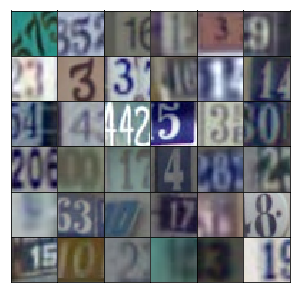

In [7]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [8]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [9]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [10]:
def model_inputs(real_dim, z_dim):
    # Fix "SyntaxError: can use starred expression only as assignment target"
    #inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    w, h, c = real_dim[0],  real_dim[1],  real_dim[2],
    inputs_real = tf.placeholder(tf.float32, (None, w, h, c), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [11]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        
        # First fully connected layer
        # without bias and without activation
        l1 = tf.layers.dense(inputs=z , 
                             units= 4*4*512, 
                             activation=None , 
                             use_bias=None,   
                             name='l1_fully_connected')    
        # Reshape to match the convolution layer's size
        l1 = tf.reshape(l1, shape=(-1, 4, 4, 512), name='l1_reshape')
        # Add batch Normalization
        l1 = tf.layers.batch_normalization(inputs=l1, training=training, name='l1_batchnorm')
        # Add Leaky ReLU activation function after Normalization
        l1 = tf.maximum(l1*alpha, l1, name='l1_fc_leakyRelu')
        # out 4x4x512
                        
        # 2nd layer : Stack a Transposed convolution
        l2 = tf.layers.conv2d_transpose(inputs= l1 ,
                                        activation= None , 
                                        filters= 256, 
                                        kernel_size= (5,5) ,
                                        padding='same' , 
                                        strides=(2,2) ,
                                        name= 'l2_tconv')
        # Add batch Normalization
        l2 = tf.layers.batch_normalization(inputs=l2, training=training, name='l2_batchnorm')
        # Add Leaky ReLU activation function after Normalization
        l2 = tf.maximum(l2*alpha, l2, name='l2_fc_leakyRelu')
        # out 8x8x256        
        
        # 3rd layer : Stack a Transposed convolution
        l3 = tf.layers.conv2d_transpose(inputs= l2 ,
                                        activation= None , 
                                        filters= 128, 
                                        kernel_size= (5,5) ,
                                        padding='same' , 
                                        strides=(2,2) ,
                                        name= 'l3_tconv')
        # Add batch Normalization
        l3 = tf.layers.batch_normalization(inputs=l3, training=training, name='l3_batchnorm')
        # Add Leaky ReLU activation function after Normalization
        l3 = tf.maximum(l3*alpha, l3, name='l3_fc_leakyRelu')
        # out 16x16x128 
        
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(inputs= l3 ,
                                            activation= None , 
                                            filters= output_dim, 
                                            kernel_size= (5,5) ,
                                            padding='same' , 
                                            strides=(2,2) ,
                                            name= 'logits_tconv')
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

TODO REMOVE : Add batch Normalization

In [2]:
def discriminator(x, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        l1 = tf.layers.conv2d(inputs= x ,
                              activation= None , 
                              filters= 128, 
                              kernel_size= (5,5) ,
                              padding='same' , 
                              strides=(2,2) ,
                              name= 'l1_conv')
        # No Batch normalization in first layer of discriminator
        # l1 = tf.layers.batch_normalization(inputs=l1, training=training, name='l1_batchnorm')
        # Add Leaky ReLU activation function after Normalization
        l1 = tf.maximum(l1*alpha, l1, name='l1_fc_leakyRelu')
        # out 16x16x128
        
        # 2nd layer
        l2 = tf.layers.conv2d(inputs= l1 ,
                              activation= None , 
                              filters= 256, 
                              kernel_size= (5,5) ,
                              padding='same' , 
                              strides=(2,2) ,
                              name= 'l2_conv')
        # Add batch Normalization
        l2 = tf.layers.batch_normalization(inputs=l2, training=training, name='l2_batchnorm')
        # Add Leaky ReLU activation function after Normalization
        l2 = tf.maximum(l2*alpha, l2, name='l2_fc_leakyRelu')
        # out 8x8x256
        
        # 3rd layer
        l3 = tf.layers.conv2d(inputs= l2 ,
                              activation= None , 
                              filters= 512, 
                              kernel_size= (5,5) ,
                              padding='same' , 
                              strides=(2,2) ,
                              name= 'l3_conv')
        # Add batch Normalization
        l3 = tf.layers.batch_normalization(inputs=l3, training=training, name='l3_batchnorm')
        # Add Leaky ReLU activation function after Normalization
        l3 = tf.maximum(l3*alpha, l3, name='l3_fc_leakyRelu')
        # out 4x4x512
        
        # Reshape to match the convolution layer's size
        flatten = tf.reshape(l3, (-1, 4*4*512))
        
        logits = tf.layers.dense(inputs=flatten , 
                             units= 1, 
                             activation=None , 
                             use_bias=None,   
                             name='logits') 
        out = tf.sigmoid(logits, name='out')
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

TODO : Missing  0.9 correction in d_loss_real ?

In [13]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [14]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [15]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [16]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [17]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [18]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002 #0.001
batch_size = 128 #64
epochs = 25 #1
alpha = 0.2 #0.01
beta1 = 0.5 #0.9

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.3815... Generator Loss: 15.0829
Epoch 1/25... Discriminator Loss: 0.0614... Generator Loss: 11.1845
Epoch 1/25... Discriminator Loss: 0.1886... Generator Loss: 24.3791
Epoch 1/25... Discriminator Loss: 0.4833... Generator Loss: 1.4832
Epoch 1/25... Discriminator Loss: 0.4839... Generator Loss: 2.1900
Epoch 1/25... Discriminator Loss: 1.0440... Generator Loss: 1.6109
Epoch 1/25... Discriminator Loss: 0.4406... Generator Loss: 2.8022
Epoch 1/25... Discriminator Loss: 0.3711... Generator Loss: 1.7612
Epoch 1/25... Discriminator Loss: 0.2997... Generator Loss: 2.8563
Epoch 1/25... Discriminator Loss: 0.1716... Generator Loss: 3.1303


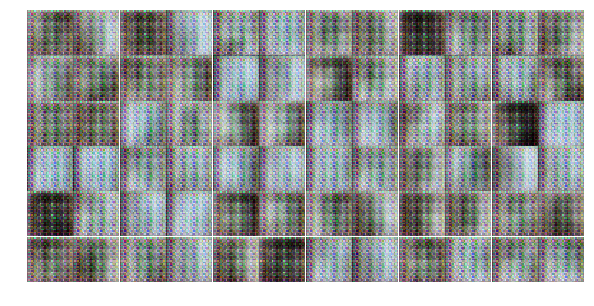

Epoch 1/25... Discriminator Loss: 0.4341... Generator Loss: 2.1741
Epoch 1/25... Discriminator Loss: 0.6786... Generator Loss: 2.2193
Epoch 1/25... Discriminator Loss: 0.7386... Generator Loss: 4.2784
Epoch 1/25... Discriminator Loss: 0.1888... Generator Loss: 2.9736
Epoch 1/25... Discriminator Loss: 0.6328... Generator Loss: 1.3207
Epoch 1/25... Discriminator Loss: 0.5245... Generator Loss: 1.9562
Epoch 1/25... Discriminator Loss: 1.2801... Generator Loss: 6.5304
Epoch 1/25... Discriminator Loss: 0.1853... Generator Loss: 2.8823
Epoch 1/25... Discriminator Loss: 0.5045... Generator Loss: 4.4589
Epoch 1/25... Discriminator Loss: 0.5562... Generator Loss: 3.5929


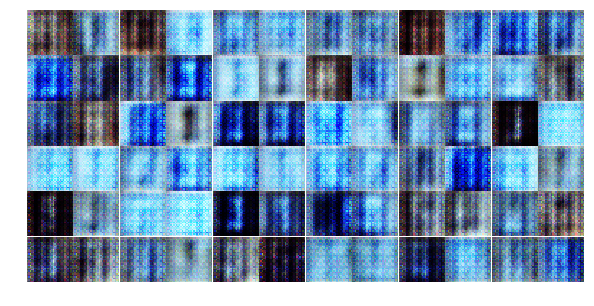

Epoch 1/25... Discriminator Loss: 0.4227... Generator Loss: 1.7747
Epoch 1/25... Discriminator Loss: 0.4099... Generator Loss: 2.4055
Epoch 1/25... Discriminator Loss: 1.2431... Generator Loss: 0.5849
Epoch 1/25... Discriminator Loss: 0.2046... Generator Loss: 2.6803
Epoch 1/25... Discriminator Loss: 0.4021... Generator Loss: 1.7745
Epoch 1/25... Discriminator Loss: 0.3006... Generator Loss: 3.3519
Epoch 1/25... Discriminator Loss: 1.9127... Generator Loss: 4.0239
Epoch 1/25... Discriminator Loss: 0.6274... Generator Loss: 1.1598
Epoch 1/25... Discriminator Loss: 0.2674... Generator Loss: 2.2068
Epoch 1/25... Discriminator Loss: 1.1758... Generator Loss: 5.8057


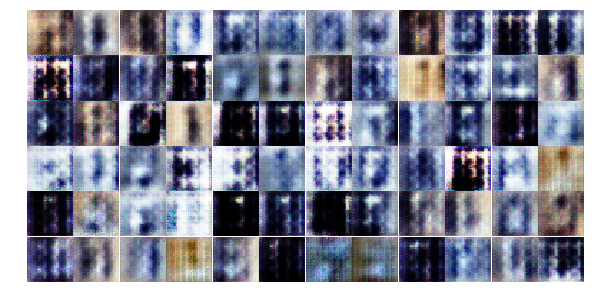

Epoch 1/25... Discriminator Loss: 0.5568... Generator Loss: 1.3384
Epoch 1/25... Discriminator Loss: 0.2820... Generator Loss: 2.5685
Epoch 1/25... Discriminator Loss: 0.5175... Generator Loss: 3.8585
Epoch 1/25... Discriminator Loss: 0.3598... Generator Loss: 2.6981
Epoch 1/25... Discriminator Loss: 0.4834... Generator Loss: 1.6482
Epoch 1/25... Discriminator Loss: 0.3429... Generator Loss: 2.2804
Epoch 1/25... Discriminator Loss: 0.3912... Generator Loss: 1.5231
Epoch 1/25... Discriminator Loss: 0.2947... Generator Loss: 2.8450
Epoch 1/25... Discriminator Loss: 0.2533... Generator Loss: 2.2028
Epoch 1/25... Discriminator Loss: 0.8534... Generator Loss: 4.9121


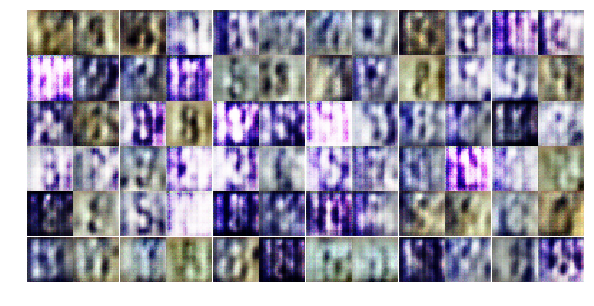

Epoch 1/25... Discriminator Loss: 1.1730... Generator Loss: 0.9497
Epoch 1/25... Discriminator Loss: 0.8713... Generator Loss: 1.1937
Epoch 1/25... Discriminator Loss: 0.5909... Generator Loss: 2.0719
Epoch 1/25... Discriminator Loss: 1.0674... Generator Loss: 0.8125
Epoch 1/25... Discriminator Loss: 1.0168... Generator Loss: 1.1643
Epoch 1/25... Discriminator Loss: 0.5143... Generator Loss: 1.3758
Epoch 1/25... Discriminator Loss: 0.9538... Generator Loss: 2.2546
Epoch 1/25... Discriminator Loss: 0.4281... Generator Loss: 2.9177
Epoch 1/25... Discriminator Loss: 0.6030... Generator Loss: 3.7560
Epoch 1/25... Discriminator Loss: 0.4668... Generator Loss: 2.0899


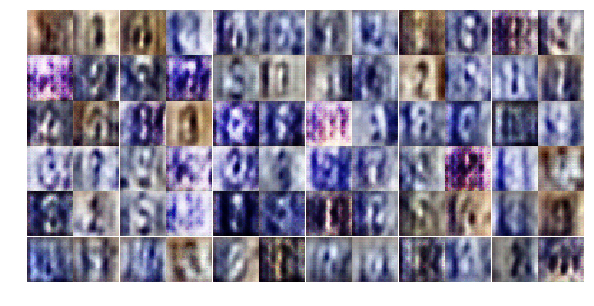

Epoch 1/25... Discriminator Loss: 0.8777... Generator Loss: 1.2643
Epoch 1/25... Discriminator Loss: 0.7432... Generator Loss: 1.2601
Epoch 1/25... Discriminator Loss: 0.8064... Generator Loss: 2.2478
Epoch 1/25... Discriminator Loss: 0.6606... Generator Loss: 1.4380
Epoch 1/25... Discriminator Loss: 1.4858... Generator Loss: 4.3462
Epoch 1/25... Discriminator Loss: 1.5520... Generator Loss: 0.3814
Epoch 1/25... Discriminator Loss: 0.5273... Generator Loss: 1.6012
Epoch 2/25... Discriminator Loss: 1.0925... Generator Loss: 0.6732
Epoch 2/25... Discriminator Loss: 0.6313... Generator Loss: 1.2864
Epoch 2/25... Discriminator Loss: 1.8082... Generator Loss: 3.6130


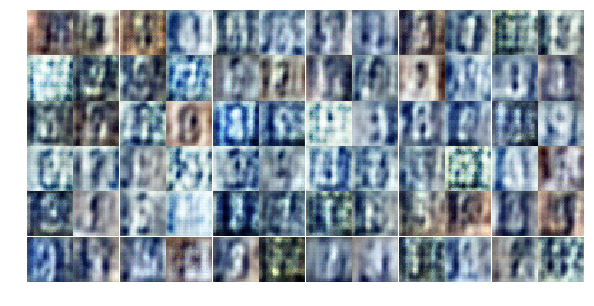

Epoch 2/25... Discriminator Loss: 0.3059... Generator Loss: 1.8753
Epoch 2/25... Discriminator Loss: 1.6985... Generator Loss: 3.1989
Epoch 2/25... Discriminator Loss: 0.8155... Generator Loss: 1.1381
Epoch 2/25... Discriminator Loss: 0.3581... Generator Loss: 1.9292
Epoch 2/25... Discriminator Loss: 0.3526... Generator Loss: 1.8756
Epoch 2/25... Discriminator Loss: 0.5261... Generator Loss: 1.2499
Epoch 2/25... Discriminator Loss: 1.0945... Generator Loss: 0.8882
Epoch 2/25... Discriminator Loss: 0.7617... Generator Loss: 1.0503
Epoch 2/25... Discriminator Loss: 0.8369... Generator Loss: 0.9370
Epoch 2/25... Discriminator Loss: 0.7233... Generator Loss: 1.3223


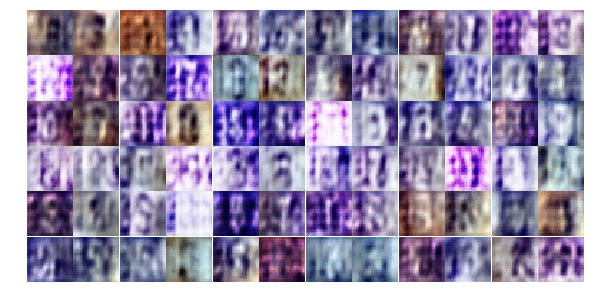

Epoch 2/25... Discriminator Loss: 1.3412... Generator Loss: 0.4176
Epoch 2/25... Discriminator Loss: 1.0962... Generator Loss: 1.0611
Epoch 2/25... Discriminator Loss: 0.7168... Generator Loss: 1.1794
Epoch 2/25... Discriminator Loss: 0.4762... Generator Loss: 2.2558
Epoch 2/25... Discriminator Loss: 1.0433... Generator Loss: 2.2562
Epoch 2/25... Discriminator Loss: 1.0286... Generator Loss: 1.8475
Epoch 2/25... Discriminator Loss: 0.9822... Generator Loss: 1.2639
Epoch 2/25... Discriminator Loss: 0.5339... Generator Loss: 3.7318
Epoch 2/25... Discriminator Loss: 1.0579... Generator Loss: 0.6591
Epoch 2/25... Discriminator Loss: 1.5605... Generator Loss: 0.3979


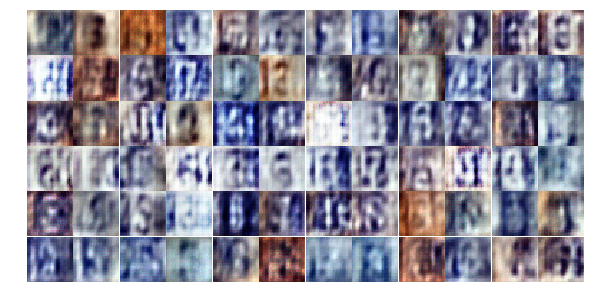

Epoch 2/25... Discriminator Loss: 0.8911... Generator Loss: 0.7598
Epoch 2/25... Discriminator Loss: 0.2778... Generator Loss: 2.8966
Epoch 2/25... Discriminator Loss: 0.6618... Generator Loss: 2.4432
Epoch 2/25... Discriminator Loss: 0.6192... Generator Loss: 1.1776
Epoch 2/25... Discriminator Loss: 0.3997... Generator Loss: 1.7686
Epoch 2/25... Discriminator Loss: 1.3405... Generator Loss: 0.4691
Epoch 2/25... Discriminator Loss: 0.3462... Generator Loss: 2.9311
Epoch 2/25... Discriminator Loss: 0.1696... Generator Loss: 2.5567
Epoch 2/25... Discriminator Loss: 1.0841... Generator Loss: 0.5533
Epoch 2/25... Discriminator Loss: 0.8503... Generator Loss: 1.1258


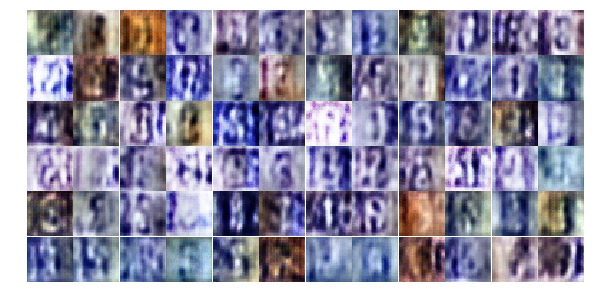

Epoch 2/25... Discriminator Loss: 0.9163... Generator Loss: 0.7025
Epoch 2/25... Discriminator Loss: 0.1626... Generator Loss: 2.7599
Epoch 2/25... Discriminator Loss: 0.1392... Generator Loss: 3.0305
Epoch 2/25... Discriminator Loss: 0.2175... Generator Loss: 2.6360
Epoch 2/25... Discriminator Loss: 0.3149... Generator Loss: 2.1888
Epoch 2/25... Discriminator Loss: 0.3250... Generator Loss: 1.9215
Epoch 2/25... Discriminator Loss: 0.2011... Generator Loss: 2.9125
Epoch 2/25... Discriminator Loss: 0.2874... Generator Loss: 3.6262
Epoch 2/25... Discriminator Loss: 0.6171... Generator Loss: 0.9895
Epoch 2/25... Discriminator Loss: 0.3276... Generator Loss: 1.7707


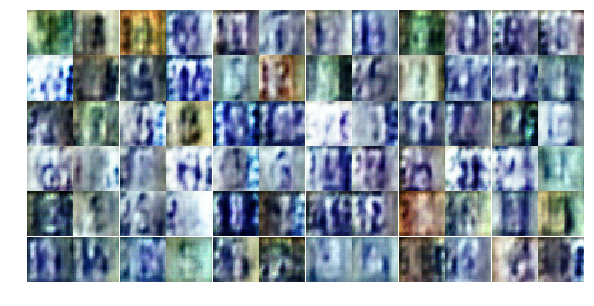

Epoch 2/25... Discriminator Loss: 0.5774... Generator Loss: 7.2712
Epoch 2/25... Discriminator Loss: 0.8333... Generator Loss: 1.7054
Epoch 2/25... Discriminator Loss: 0.3920... Generator Loss: 2.5575
Epoch 2/25... Discriminator Loss: 0.7702... Generator Loss: 3.1763
Epoch 2/25... Discriminator Loss: 0.5651... Generator Loss: 5.2650
Epoch 2/25... Discriminator Loss: 2.4327... Generator Loss: 6.9912
Epoch 2/25... Discriminator Loss: 0.3873... Generator Loss: 4.0295
Epoch 2/25... Discriminator Loss: 0.0608... Generator Loss: 6.5236
Epoch 2/25... Discriminator Loss: 0.1178... Generator Loss: 4.5445
Epoch 2/25... Discriminator Loss: 1.7069... Generator Loss: 0.2438


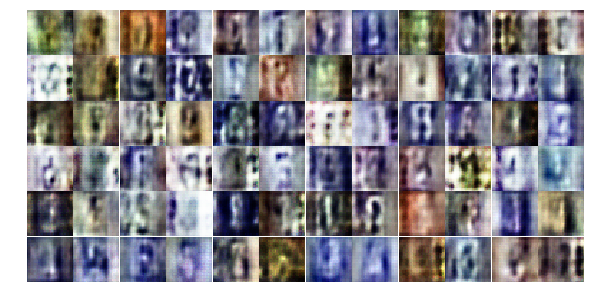

Epoch 2/25... Discriminator Loss: 0.6594... Generator Loss: 4.9722
Epoch 2/25... Discriminator Loss: 0.8413... Generator Loss: 4.9936
Epoch 2/25... Discriminator Loss: 0.2121... Generator Loss: 2.1529
Epoch 2/25... Discriminator Loss: 0.3324... Generator Loss: 2.0624
Epoch 3/25... Discriminator Loss: 0.6689... Generator Loss: 0.9430
Epoch 3/25... Discriminator Loss: 1.1780... Generator Loss: 0.5054
Epoch 3/25... Discriminator Loss: 0.8103... Generator Loss: 0.7762
Epoch 3/25... Discriminator Loss: 0.4024... Generator Loss: 3.6275
Epoch 3/25... Discriminator Loss: 0.4489... Generator Loss: 1.6678
Epoch 3/25... Discriminator Loss: 0.2209... Generator Loss: 5.6404


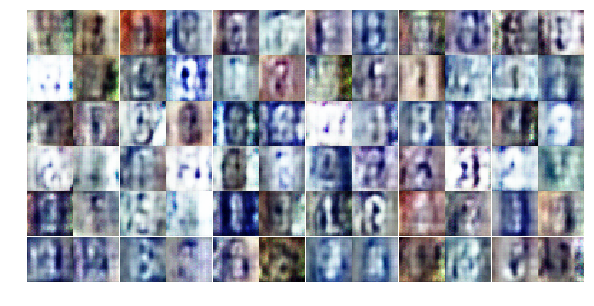

Epoch 3/25... Discriminator Loss: 0.0162... Generator Loss: 7.4895
Epoch 3/25... Discriminator Loss: 0.0264... Generator Loss: 4.4697
Epoch 3/25... Discriminator Loss: 0.4055... Generator Loss: 1.3849
Epoch 3/25... Discriminator Loss: 0.0378... Generator Loss: 7.5094
Epoch 3/25... Discriminator Loss: 0.0535... Generator Loss: 8.7970
Epoch 3/25... Discriminator Loss: 0.1798... Generator Loss: 4.1099
Epoch 3/25... Discriminator Loss: 1.0227... Generator Loss: 0.6011
Epoch 3/25... Discriminator Loss: 1.9661... Generator Loss: 7.0001
Epoch 3/25... Discriminator Loss: 0.5242... Generator Loss: 1.1694
Epoch 3/25... Discriminator Loss: 0.2004... Generator Loss: 2.4061


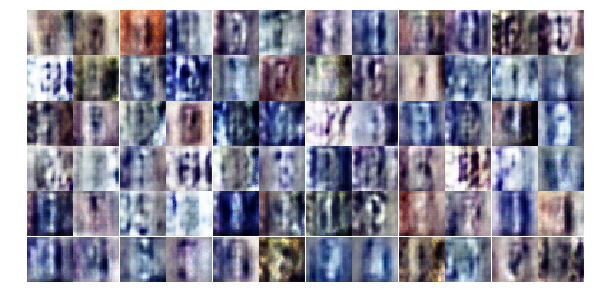

Epoch 3/25... Discriminator Loss: 0.0659... Generator Loss: 5.2102
Epoch 3/25... Discriminator Loss: 1.2190... Generator Loss: 4.6729
Epoch 3/25... Discriminator Loss: 0.7761... Generator Loss: 1.4941
Epoch 3/25... Discriminator Loss: 0.3296... Generator Loss: 1.9718
Epoch 3/25... Discriminator Loss: 1.9236... Generator Loss: 0.2155
Epoch 3/25... Discriminator Loss: 0.8418... Generator Loss: 0.9474
Epoch 3/25... Discriminator Loss: 0.0762... Generator Loss: 5.5482
Epoch 3/25... Discriminator Loss: 0.1063... Generator Loss: 3.9836
Epoch 3/25... Discriminator Loss: 0.6813... Generator Loss: 0.8606
Epoch 3/25... Discriminator Loss: 0.0704... Generator Loss: 3.5083


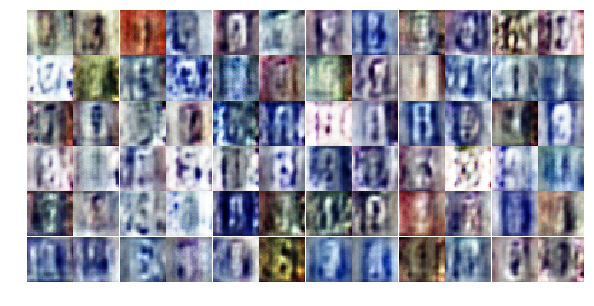

Epoch 3/25... Discriminator Loss: 0.0978... Generator Loss: 2.9946
Epoch 3/25... Discriminator Loss: 0.0553... Generator Loss: 3.6522
Epoch 3/25... Discriminator Loss: 0.5173... Generator Loss: 1.6138
Epoch 3/25... Discriminator Loss: 0.1871... Generator Loss: 2.2483
Epoch 3/25... Discriminator Loss: 0.0373... Generator Loss: 5.4926
Epoch 3/25... Discriminator Loss: 1.0013... Generator Loss: 0.6766
Epoch 3/25... Discriminator Loss: 1.0638... Generator Loss: 0.7497
Epoch 3/25... Discriminator Loss: 0.0741... Generator Loss: 9.9398
Epoch 3/25... Discriminator Loss: 0.3046... Generator Loss: 1.7156
Epoch 3/25... Discriminator Loss: 2.0098... Generator Loss: 3.3354


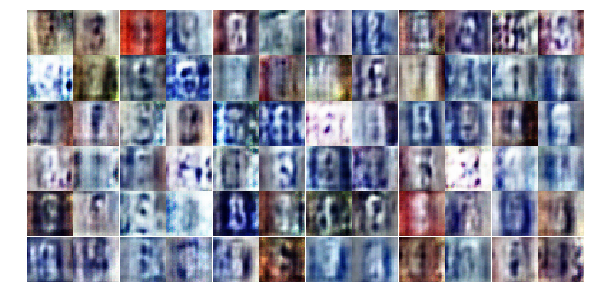

Epoch 3/25... Discriminator Loss: 1.3015... Generator Loss: 0.7630
Epoch 3/25... Discriminator Loss: 1.0727... Generator Loss: 0.6261
Epoch 3/25... Discriminator Loss: 0.5433... Generator Loss: 6.0692
Epoch 3/25... Discriminator Loss: 0.0584... Generator Loss: 3.9478
Epoch 3/25... Discriminator Loss: 0.9464... Generator Loss: 1.4214
Epoch 3/25... Discriminator Loss: 0.4326... Generator Loss: 7.1873
Epoch 3/25... Discriminator Loss: 0.0987... Generator Loss: 4.1748
Epoch 3/25... Discriminator Loss: 0.0309... Generator Loss: 7.8250
Epoch 3/25... Discriminator Loss: 1.5195... Generator Loss: 8.2678
Epoch 3/25... Discriminator Loss: 0.1798... Generator Loss: 2.2805


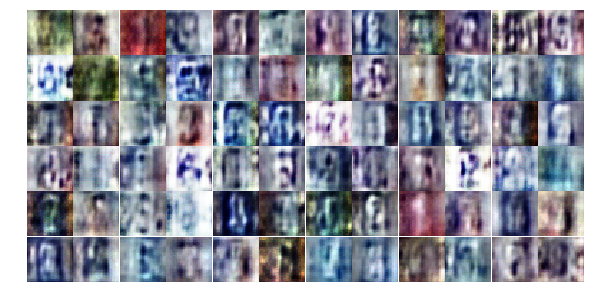

Epoch 3/25... Discriminator Loss: 0.0691... Generator Loss: 6.5726
Epoch 3/25... Discriminator Loss: 0.0516... Generator Loss: 3.8160
Epoch 3/25... Discriminator Loss: 0.4375... Generator Loss: 1.8233
Epoch 3/25... Discriminator Loss: 1.6673... Generator Loss: 4.3778
Epoch 3/25... Discriminator Loss: 0.1878... Generator Loss: 4.1912
Epoch 3/25... Discriminator Loss: 0.0293... Generator Loss: 6.6709
Epoch 3/25... Discriminator Loss: 0.9064... Generator Loss: 6.2832
Epoch 3/25... Discriminator Loss: 0.1158... Generator Loss: 2.9097
Epoch 3/25... Discriminator Loss: 0.0678... Generator Loss: 3.5288
Epoch 3/25... Discriminator Loss: 0.1551... Generator Loss: 2.4351


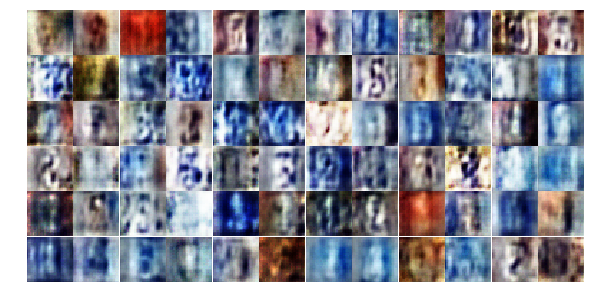

Epoch 3/25... Discriminator Loss: 0.1123... Generator Loss: 2.7641
Epoch 4/25... Discriminator Loss: 0.0782... Generator Loss: 8.7251
Epoch 4/25... Discriminator Loss: 0.0183... Generator Loss: 9.1758
Epoch 4/25... Discriminator Loss: 0.0391... Generator Loss: 4.0808
Epoch 4/25... Discriminator Loss: 0.0224... Generator Loss: 8.4348
Epoch 4/25... Discriminator Loss: 0.0347... Generator Loss: 6.5709
Epoch 4/25... Discriminator Loss: 0.0196... Generator Loss: 5.3912
Epoch 4/25... Discriminator Loss: 1.4986... Generator Loss: 0.3783
Epoch 4/25... Discriminator Loss: 0.5796... Generator Loss: 1.1490
Epoch 4/25... Discriminator Loss: 2.5889... Generator Loss: 4.7456


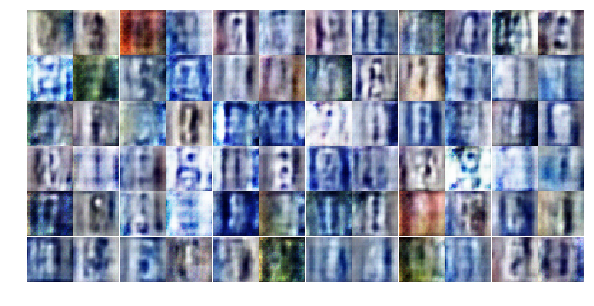

Epoch 4/25... Discriminator Loss: 0.3405... Generator Loss: 2.9511
Epoch 4/25... Discriminator Loss: 0.1846... Generator Loss: 5.9254
Epoch 4/25... Discriminator Loss: 1.3387... Generator Loss: 0.5152
Epoch 4/25... Discriminator Loss: 0.8736... Generator Loss: 0.8126
Epoch 4/25... Discriminator Loss: 0.5146... Generator Loss: 1.2706
Epoch 4/25... Discriminator Loss: 0.3278... Generator Loss: 1.8213
Epoch 4/25... Discriminator Loss: 0.5064... Generator Loss: 1.1392
Epoch 4/25... Discriminator Loss: 0.8598... Generator Loss: 1.3581
Epoch 4/25... Discriminator Loss: 3.1487... Generator Loss: 0.0721
Epoch 4/25... Discriminator Loss: 0.4573... Generator Loss: 4.2252


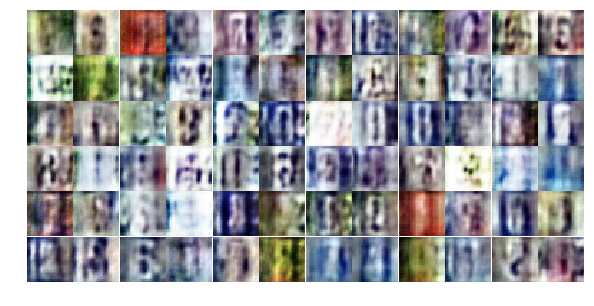

Epoch 4/25... Discriminator Loss: 1.0749... Generator Loss: 0.5576
Epoch 4/25... Discriminator Loss: 0.1211... Generator Loss: 5.0485
Epoch 4/25... Discriminator Loss: 0.1535... Generator Loss: 2.5175
Epoch 4/25... Discriminator Loss: 0.3331... Generator Loss: 4.0030
Epoch 4/25... Discriminator Loss: 0.4940... Generator Loss: 1.2578
Epoch 4/25... Discriminator Loss: 0.3698... Generator Loss: 2.4611
Epoch 4/25... Discriminator Loss: 0.3073... Generator Loss: 6.4847
Epoch 4/25... Discriminator Loss: 0.1676... Generator Loss: 6.3609
Epoch 4/25... Discriminator Loss: 0.0706... Generator Loss: 4.0852
Epoch 4/25... Discriminator Loss: 0.0627... Generator Loss: 5.4337


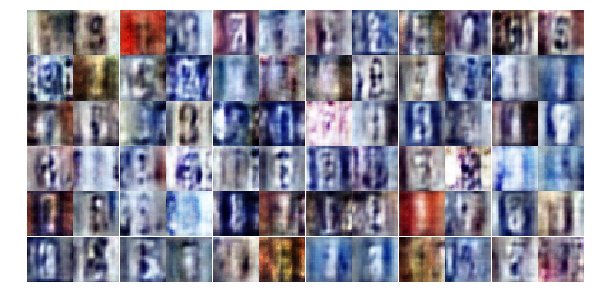

Epoch 4/25... Discriminator Loss: 1.3141... Generator Loss: 0.4526
Epoch 4/25... Discriminator Loss: 0.3051... Generator Loss: 2.2421
Epoch 4/25... Discriminator Loss: 0.2496... Generator Loss: 6.0461
Epoch 4/25... Discriminator Loss: 0.1235... Generator Loss: 7.3770
Epoch 4/25... Discriminator Loss: 0.1625... Generator Loss: 2.4744
Epoch 4/25... Discriminator Loss: 0.7514... Generator Loss: 1.1675
Epoch 4/25... Discriminator Loss: 0.0807... Generator Loss: 3.7047
Epoch 4/25... Discriminator Loss: 0.7547... Generator Loss: 0.9393
Epoch 4/25... Discriminator Loss: 0.0851... Generator Loss: 5.5120
Epoch 4/25... Discriminator Loss: 0.8664... Generator Loss: 0.8899


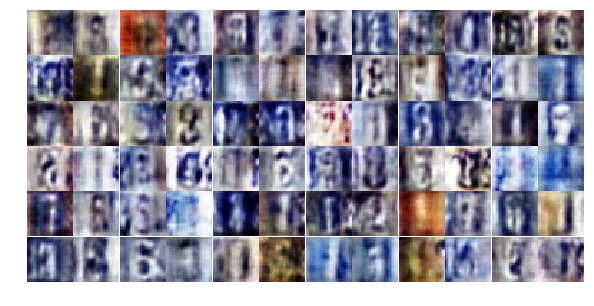

Epoch 4/25... Discriminator Loss: 0.1366... Generator Loss: 6.6169
Epoch 4/25... Discriminator Loss: 0.2237... Generator Loss: 2.5289
Epoch 4/25... Discriminator Loss: 0.0444... Generator Loss: 4.0443
Epoch 4/25... Discriminator Loss: 1.5079... Generator Loss: 6.2114
Epoch 4/25... Discriminator Loss: 0.3067... Generator Loss: 5.3741
Epoch 4/25... Discriminator Loss: 0.8156... Generator Loss: 0.7445
Epoch 4/25... Discriminator Loss: 0.0624... Generator Loss: 3.7062
Epoch 4/25... Discriminator Loss: 0.1569... Generator Loss: 3.9370
Epoch 4/25... Discriminator Loss: 0.3890... Generator Loss: 1.6550
Epoch 4/25... Discriminator Loss: 0.5338... Generator Loss: 1.4218


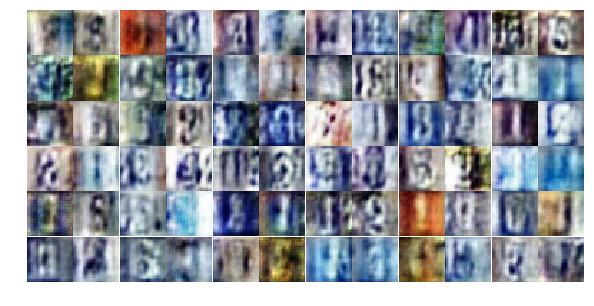

Epoch 4/25... Discriminator Loss: 0.2868... Generator Loss: 3.8494
Epoch 4/25... Discriminator Loss: 0.6849... Generator Loss: 2.1632
Epoch 4/25... Discriminator Loss: 0.3668... Generator Loss: 6.6309
Epoch 4/25... Discriminator Loss: 0.2115... Generator Loss: 2.2590
Epoch 4/25... Discriminator Loss: 0.0841... Generator Loss: 5.3085
Epoch 4/25... Discriminator Loss: 0.1050... Generator Loss: 3.2568
Epoch 4/25... Discriminator Loss: 0.2374... Generator Loss: 2.8787
Epoch 4/25... Discriminator Loss: 0.1268... Generator Loss: 3.5474
Epoch 4/25... Discriminator Loss: 0.2373... Generator Loss: 2.8957
Epoch 5/25... Discriminator Loss: 1.1077... Generator Loss: 0.6008


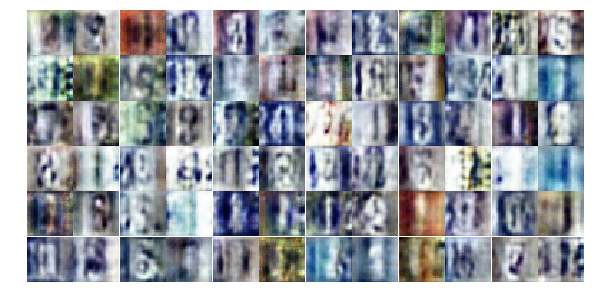

Epoch 5/25... Discriminator Loss: 0.2696... Generator Loss: 2.9053
Epoch 5/25... Discriminator Loss: 0.2436... Generator Loss: 2.1816
Epoch 5/25... Discriminator Loss: 0.7192... Generator Loss: 0.9628
Epoch 5/25... Discriminator Loss: 1.0932... Generator Loss: 0.6517
Epoch 5/25... Discriminator Loss: 0.7181... Generator Loss: 0.9367
Epoch 5/25... Discriminator Loss: 0.8521... Generator Loss: 0.7883
Epoch 5/25... Discriminator Loss: 0.1418... Generator Loss: 4.3366
Epoch 5/25... Discriminator Loss: 0.1592... Generator Loss: 7.0073
Epoch 5/25... Discriminator Loss: 0.7869... Generator Loss: 0.8742
Epoch 5/25... Discriminator Loss: 0.1366... Generator Loss: 3.4687


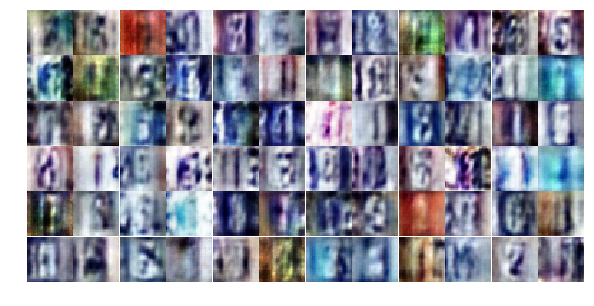

Epoch 5/25... Discriminator Loss: 0.2591... Generator Loss: 2.4789
Epoch 5/25... Discriminator Loss: 1.3031... Generator Loss: 1.4539
Epoch 5/25... Discriminator Loss: 1.0674... Generator Loss: 1.0409
Epoch 5/25... Discriminator Loss: 1.1325... Generator Loss: 0.7224
Epoch 5/25... Discriminator Loss: 0.8143... Generator Loss: 1.0779
Epoch 5/25... Discriminator Loss: 0.6046... Generator Loss: 1.9519
Epoch 5/25... Discriminator Loss: 1.1126... Generator Loss: 0.7228
Epoch 5/25... Discriminator Loss: 1.2347... Generator Loss: 0.7204
Epoch 5/25... Discriminator Loss: 0.3337... Generator Loss: 2.6033
Epoch 5/25... Discriminator Loss: 0.5049... Generator Loss: 2.1182


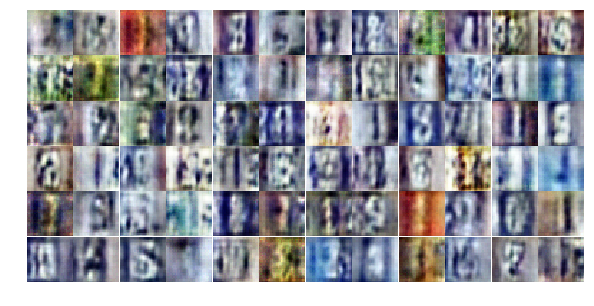

Epoch 5/25... Discriminator Loss: 0.6681... Generator Loss: 1.1680
Epoch 5/25... Discriminator Loss: 0.6688... Generator Loss: 4.3412
Epoch 5/25... Discriminator Loss: 0.2164... Generator Loss: 2.8843
Epoch 5/25... Discriminator Loss: 0.2550... Generator Loss: 3.3052
Epoch 5/25... Discriminator Loss: 0.1913... Generator Loss: 3.7268
Epoch 5/25... Discriminator Loss: 0.2699... Generator Loss: 1.9979
Epoch 5/25... Discriminator Loss: 0.1347... Generator Loss: 2.8315
Epoch 5/25... Discriminator Loss: 0.2812... Generator Loss: 6.1756
Epoch 5/25... Discriminator Loss: 0.1355... Generator Loss: 3.4261
Epoch 5/25... Discriminator Loss: 0.1086... Generator Loss: 3.9019


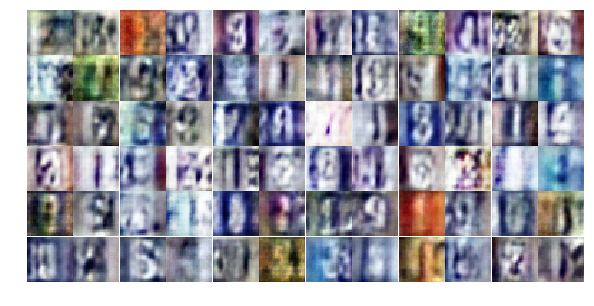

Epoch 5/25... Discriminator Loss: 0.4623... Generator Loss: 1.5911
Epoch 5/25... Discriminator Loss: 0.8184... Generator Loss: 4.0828
Epoch 5/25... Discriminator Loss: 0.2900... Generator Loss: 2.5081
Epoch 5/25... Discriminator Loss: 0.4267... Generator Loss: 1.5366
Epoch 5/25... Discriminator Loss: 1.0261... Generator Loss: 8.3528
Epoch 5/25... Discriminator Loss: 0.8071... Generator Loss: 0.9532
Epoch 5/25... Discriminator Loss: 0.1150... Generator Loss: 3.6052
Epoch 5/25... Discriminator Loss: 0.6368... Generator Loss: 6.8441
Epoch 5/25... Discriminator Loss: 1.1916... Generator Loss: 5.9849
Epoch 5/25... Discriminator Loss: 0.9870... Generator Loss: 0.9333


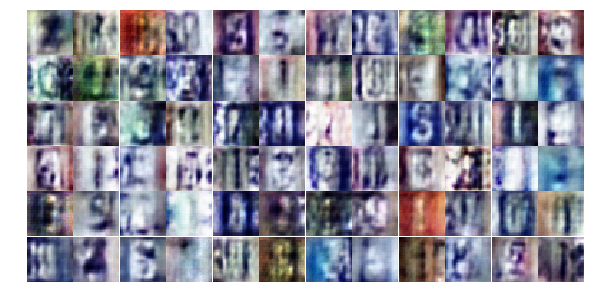

Epoch 5/25... Discriminator Loss: 0.6914... Generator Loss: 1.4021
Epoch 5/25... Discriminator Loss: 1.4474... Generator Loss: 0.4068
Epoch 5/25... Discriminator Loss: 1.7268... Generator Loss: 0.2849
Epoch 5/25... Discriminator Loss: 0.5067... Generator Loss: 1.4996
Epoch 5/25... Discriminator Loss: 0.1926... Generator Loss: 2.9065
Epoch 5/25... Discriminator Loss: 0.5178... Generator Loss: 2.8828
Epoch 5/25... Discriminator Loss: 0.6700... Generator Loss: 4.6807
Epoch 5/25... Discriminator Loss: 0.5778... Generator Loss: 5.1983
Epoch 5/25... Discriminator Loss: 0.3312... Generator Loss: 1.6807
Epoch 5/25... Discriminator Loss: 0.5281... Generator Loss: 1.2304


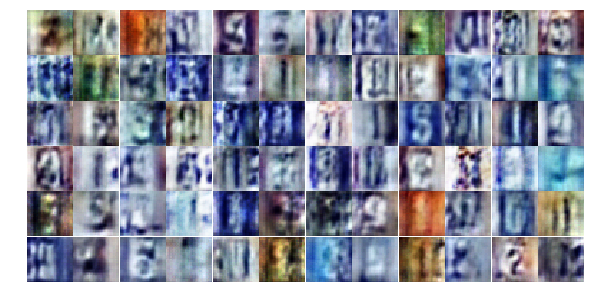

Epoch 5/25... Discriminator Loss: 0.0832... Generator Loss: 4.3297
Epoch 5/25... Discriminator Loss: 0.5572... Generator Loss: 1.7747
Epoch 5/25... Discriminator Loss: 0.3455... Generator Loss: 1.8083
Epoch 5/25... Discriminator Loss: 0.1295... Generator Loss: 3.3673
Epoch 5/25... Discriminator Loss: 0.1860... Generator Loss: 2.8767
Epoch 5/25... Discriminator Loss: 0.7234... Generator Loss: 1.0229
Epoch 6/25... Discriminator Loss: 0.2841... Generator Loss: 1.8813
Epoch 6/25... Discriminator Loss: 0.2299... Generator Loss: 2.4277
Epoch 6/25... Discriminator Loss: 0.5044... Generator Loss: 1.8106
Epoch 6/25... Discriminator Loss: 0.4505... Generator Loss: 5.4441


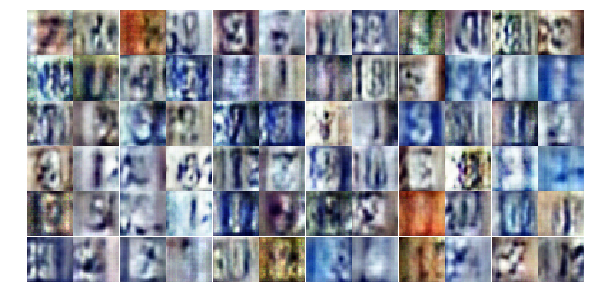

Epoch 6/25... Discriminator Loss: 0.6056... Generator Loss: 1.0644
Epoch 6/25... Discriminator Loss: 0.1957... Generator Loss: 3.3587
Epoch 6/25... Discriminator Loss: 0.9494... Generator Loss: 4.5353
Epoch 6/25... Discriminator Loss: 0.1651... Generator Loss: 3.3905
Epoch 6/25... Discriminator Loss: 1.3916... Generator Loss: 6.6326
Epoch 6/25... Discriminator Loss: 0.5339... Generator Loss: 1.5969
Epoch 6/25... Discriminator Loss: 1.4067... Generator Loss: 0.5291
Epoch 6/25... Discriminator Loss: 0.3619... Generator Loss: 2.3211
Epoch 6/25... Discriminator Loss: 0.2992... Generator Loss: 4.4601
Epoch 6/25... Discriminator Loss: 0.2731... Generator Loss: 3.5208


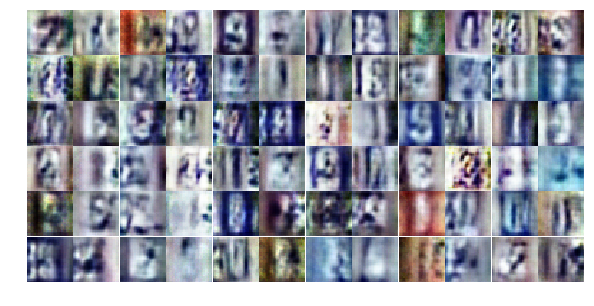

Epoch 6/25... Discriminator Loss: 0.4652... Generator Loss: 6.7395
Epoch 6/25... Discriminator Loss: 1.4136... Generator Loss: 0.9160
Epoch 6/25... Discriminator Loss: 0.8347... Generator Loss: 0.8695
Epoch 6/25... Discriminator Loss: 0.0851... Generator Loss: 4.1395
Epoch 6/25... Discriminator Loss: 0.6644... Generator Loss: 1.0053
Epoch 6/25... Discriminator Loss: 0.2587... Generator Loss: 3.4646
Epoch 6/25... Discriminator Loss: 0.3477... Generator Loss: 4.8097
Epoch 6/25... Discriminator Loss: 0.1240... Generator Loss: 3.8801
Epoch 6/25... Discriminator Loss: 0.2692... Generator Loss: 2.0880
Epoch 6/25... Discriminator Loss: 0.5974... Generator Loss: 1.3858


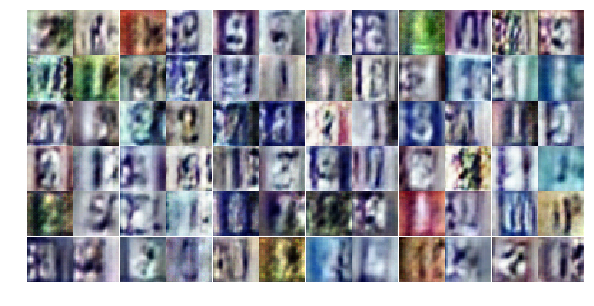

Epoch 6/25... Discriminator Loss: 0.0934... Generator Loss: 3.5726
Epoch 6/25... Discriminator Loss: 0.1084... Generator Loss: 3.1484
Epoch 6/25... Discriminator Loss: 0.1484... Generator Loss: 2.7064
Epoch 6/25... Discriminator Loss: 0.5157... Generator Loss: 1.8932
Epoch 6/25... Discriminator Loss: 0.3615... Generator Loss: 2.2980
Epoch 6/25... Discriminator Loss: 0.5755... Generator Loss: 1.1432
Epoch 6/25... Discriminator Loss: 0.1645... Generator Loss: 2.6619
Epoch 6/25... Discriminator Loss: 0.2873... Generator Loss: 1.8578
Epoch 6/25... Discriminator Loss: 0.3037... Generator Loss: 6.3057
Epoch 6/25... Discriminator Loss: 0.0859... Generator Loss: 7.0551


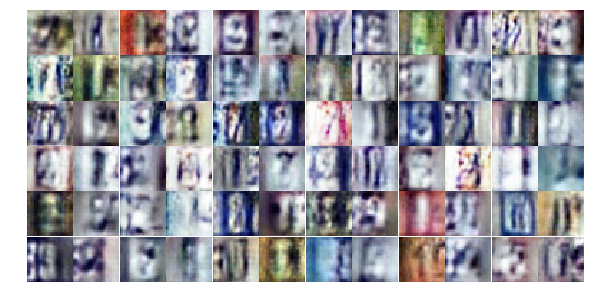

Epoch 6/25... Discriminator Loss: 1.0119... Generator Loss: 2.6282
Epoch 6/25... Discriminator Loss: 0.4759... Generator Loss: 2.6735
Epoch 6/25... Discriminator Loss: 0.2858... Generator Loss: 1.9158
Epoch 6/25... Discriminator Loss: 0.5757... Generator Loss: 4.7557
Epoch 6/25... Discriminator Loss: 0.9577... Generator Loss: 0.7099
Epoch 6/25... Discriminator Loss: 0.5618... Generator Loss: 1.2408
Epoch 6/25... Discriminator Loss: 0.3841... Generator Loss: 1.6504
Epoch 6/25... Discriminator Loss: 0.2139... Generator Loss: 2.2727
Epoch 6/25... Discriminator Loss: 0.4070... Generator Loss: 4.1987
Epoch 6/25... Discriminator Loss: 2.5481... Generator Loss: 0.3301


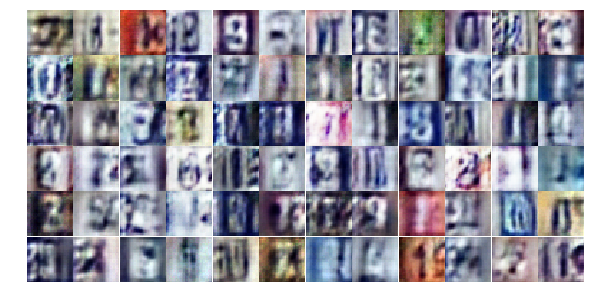

Epoch 6/25... Discriminator Loss: 0.5122... Generator Loss: 1.6115
Epoch 6/25... Discriminator Loss: 0.3123... Generator Loss: 2.5185
Epoch 6/25... Discriminator Loss: 0.4294... Generator Loss: 2.5016
Epoch 6/25... Discriminator Loss: 0.2908... Generator Loss: 1.9597
Epoch 6/25... Discriminator Loss: 0.1280... Generator Loss: 5.6377
Epoch 6/25... Discriminator Loss: 0.4385... Generator Loss: 1.5369
Epoch 6/25... Discriminator Loss: 0.1509... Generator Loss: 6.0465
Epoch 6/25... Discriminator Loss: 0.3519... Generator Loss: 2.0400
Epoch 6/25... Discriminator Loss: 0.1682... Generator Loss: 4.1096
Epoch 6/25... Discriminator Loss: 0.5198... Generator Loss: 1.3189


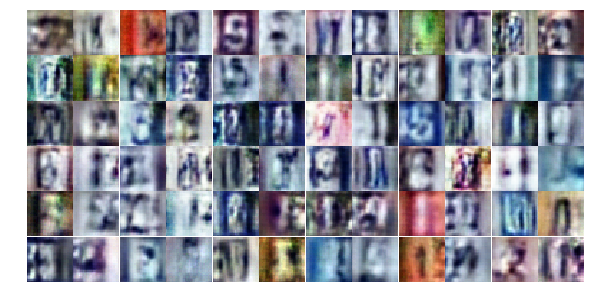

Epoch 6/25... Discriminator Loss: 0.3231... Generator Loss: 4.9809
Epoch 6/25... Discriminator Loss: 0.0692... Generator Loss: 4.0385
Epoch 6/25... Discriminator Loss: 0.2393... Generator Loss: 3.7037
Epoch 7/25... Discriminator Loss: 0.5655... Generator Loss: 1.6645
Epoch 7/25... Discriminator Loss: 0.1960... Generator Loss: 2.6151
Epoch 7/25... Discriminator Loss: 2.6139... Generator Loss: 6.0029
Epoch 7/25... Discriminator Loss: 0.9000... Generator Loss: 1.2127
Epoch 7/25... Discriminator Loss: 0.5904... Generator Loss: 1.2585
Epoch 7/25... Discriminator Loss: 0.3217... Generator Loss: 2.3922
Epoch 7/25... Discriminator Loss: 0.6498... Generator Loss: 1.2454


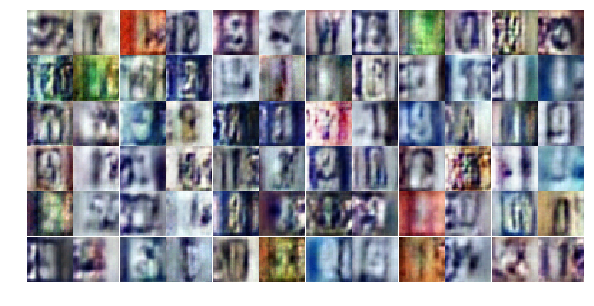

Epoch 7/25... Discriminator Loss: 0.3109... Generator Loss: 2.0607
Epoch 7/25... Discriminator Loss: 0.4164... Generator Loss: 2.2512
Epoch 7/25... Discriminator Loss: 0.2174... Generator Loss: 2.4775
Epoch 7/25... Discriminator Loss: 0.1866... Generator Loss: 2.5890
Epoch 7/25... Discriminator Loss: 0.4889... Generator Loss: 1.2845
Epoch 7/25... Discriminator Loss: 0.3615... Generator Loss: 1.9617
Epoch 7/25... Discriminator Loss: 1.6638... Generator Loss: 6.0859
Epoch 7/25... Discriminator Loss: 1.4100... Generator Loss: 4.9572
Epoch 7/25... Discriminator Loss: 0.3654... Generator Loss: 2.2827
Epoch 7/25... Discriminator Loss: 0.3109... Generator Loss: 2.2477


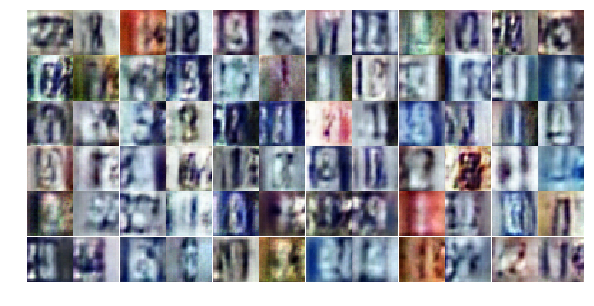

Epoch 7/25... Discriminator Loss: 0.2857... Generator Loss: 2.1256
Epoch 7/25... Discriminator Loss: 0.1832... Generator Loss: 2.7854
Epoch 7/25... Discriminator Loss: 0.1909... Generator Loss: 2.6479
Epoch 7/25... Discriminator Loss: 1.6119... Generator Loss: 0.5675
Epoch 7/25... Discriminator Loss: 0.6762... Generator Loss: 3.6792
Epoch 7/25... Discriminator Loss: 0.3466... Generator Loss: 2.6455
Epoch 7/25... Discriminator Loss: 0.7739... Generator Loss: 0.8590
Epoch 7/25... Discriminator Loss: 0.3581... Generator Loss: 2.0954
Epoch 7/25... Discriminator Loss: 0.1421... Generator Loss: 3.6359
Epoch 7/25... Discriminator Loss: 0.1344... Generator Loss: 3.2588


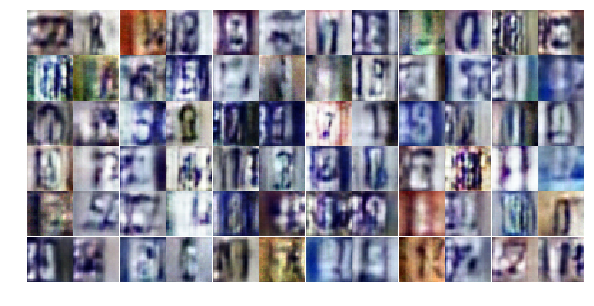

Epoch 7/25... Discriminator Loss: 0.3869... Generator Loss: 1.4695
Epoch 7/25... Discriminator Loss: 0.2506... Generator Loss: 2.0752
Epoch 7/25... Discriminator Loss: 0.2062... Generator Loss: 2.5936
Epoch 7/25... Discriminator Loss: 0.6112... Generator Loss: 4.2313
Epoch 7/25... Discriminator Loss: 0.5063... Generator Loss: 1.2694
Epoch 7/25... Discriminator Loss: 0.7717... Generator Loss: 0.8859
Epoch 7/25... Discriminator Loss: 0.2011... Generator Loss: 2.5592
Epoch 7/25... Discriminator Loss: 0.1021... Generator Loss: 4.7251
Epoch 7/25... Discriminator Loss: 0.7031... Generator Loss: 0.9408
Epoch 7/25... Discriminator Loss: 1.0178... Generator Loss: 1.2591


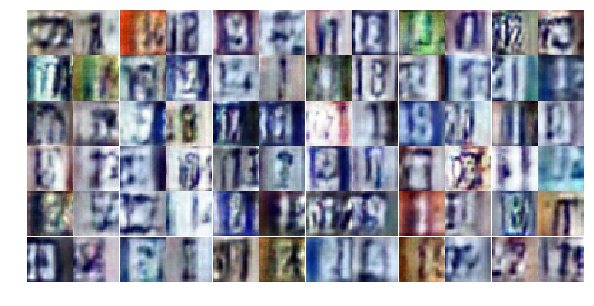

Epoch 7/25... Discriminator Loss: 0.5867... Generator Loss: 1.2679
Epoch 7/25... Discriminator Loss: 0.3572... Generator Loss: 2.0454
Epoch 7/25... Discriminator Loss: 0.3664... Generator Loss: 2.0014
Epoch 7/25... Discriminator Loss: 0.2144... Generator Loss: 2.9551
Epoch 7/25... Discriminator Loss: 0.4114... Generator Loss: 2.0264
Epoch 7/25... Discriminator Loss: 0.2552... Generator Loss: 2.1535
Epoch 7/25... Discriminator Loss: 0.4165... Generator Loss: 1.5168
Epoch 7/25... Discriminator Loss: 1.2437... Generator Loss: 0.8103
Epoch 7/25... Discriminator Loss: 0.3105... Generator Loss: 2.4330
Epoch 7/25... Discriminator Loss: 0.7271... Generator Loss: 0.9739


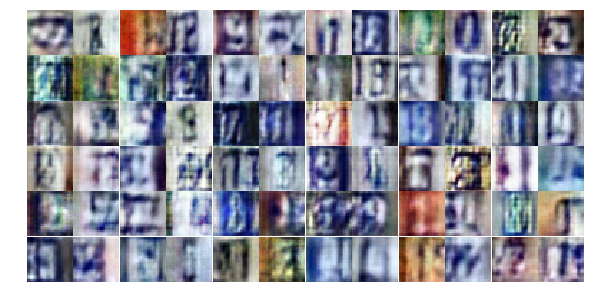

Epoch 7/25... Discriminator Loss: 0.6141... Generator Loss: 4.9524
Epoch 7/25... Discriminator Loss: 0.7215... Generator Loss: 2.2251
Epoch 7/25... Discriminator Loss: 0.4038... Generator Loss: 2.3197
Epoch 7/25... Discriminator Loss: 0.6266... Generator Loss: 1.0645
Epoch 7/25... Discriminator Loss: 0.4054... Generator Loss: 1.5893
Epoch 7/25... Discriminator Loss: 0.3594... Generator Loss: 1.9741
Epoch 7/25... Discriminator Loss: 1.0063... Generator Loss: 0.6833
Epoch 7/25... Discriminator Loss: 0.3570... Generator Loss: 2.3811
Epoch 7/25... Discriminator Loss: 0.5571... Generator Loss: 1.1656
Epoch 7/25... Discriminator Loss: 0.2472... Generator Loss: 2.6880


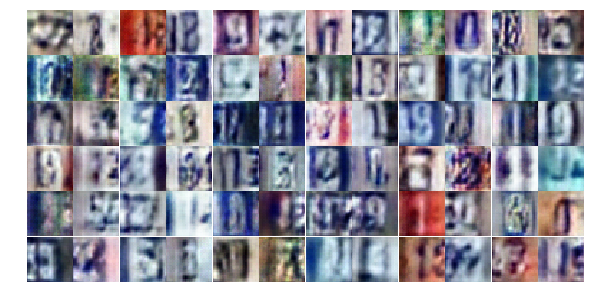

Epoch 7/25... Discriminator Loss: 0.2221... Generator Loss: 2.5292
Epoch 8/25... Discriminator Loss: 0.2890... Generator Loss: 1.8687
Epoch 8/25... Discriminator Loss: 1.2302... Generator Loss: 0.5949
Epoch 8/25... Discriminator Loss: 0.8795... Generator Loss: 2.4872
Epoch 8/25... Discriminator Loss: 0.5150... Generator Loss: 2.2190
Epoch 8/25... Discriminator Loss: 0.3372... Generator Loss: 2.0192
Epoch 8/25... Discriminator Loss: 0.3876... Generator Loss: 1.6387
Epoch 8/25... Discriminator Loss: 0.2804... Generator Loss: 3.5350
Epoch 8/25... Discriminator Loss: 0.7169... Generator Loss: 1.1487
Epoch 8/25... Discriminator Loss: 0.4471... Generator Loss: 1.6159


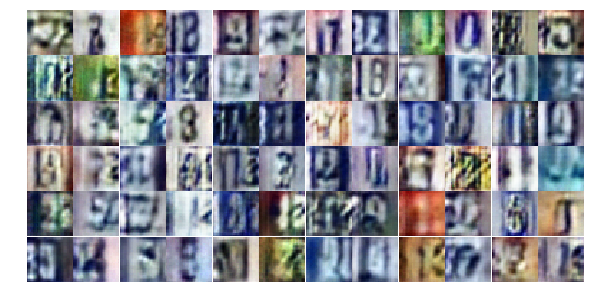

Epoch 8/25... Discriminator Loss: 0.3358... Generator Loss: 2.5648
Epoch 8/25... Discriminator Loss: 0.2747... Generator Loss: 1.9742
Epoch 8/25... Discriminator Loss: 0.7801... Generator Loss: 0.8675
Epoch 8/25... Discriminator Loss: 0.3027... Generator Loss: 2.0330
Epoch 8/25... Discriminator Loss: 1.2406... Generator Loss: 0.5280
Epoch 8/25... Discriminator Loss: 0.7457... Generator Loss: 3.4562
Epoch 8/25... Discriminator Loss: 0.4793... Generator Loss: 1.6709
Epoch 8/25... Discriminator Loss: 0.2935... Generator Loss: 2.0395
Epoch 8/25... Discriminator Loss: 0.7526... Generator Loss: 0.8681
Epoch 8/25... Discriminator Loss: 0.5008... Generator Loss: 1.4705


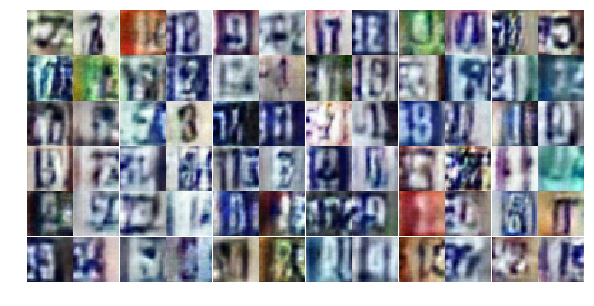

Epoch 8/25... Discriminator Loss: 0.2366... Generator Loss: 2.3796
Epoch 8/25... Discriminator Loss: 1.8110... Generator Loss: 6.0523
Epoch 8/25... Discriminator Loss: 0.5937... Generator Loss: 1.9837
Epoch 8/25... Discriminator Loss: 0.6647... Generator Loss: 3.1808
Epoch 8/25... Discriminator Loss: 0.2708... Generator Loss: 2.1204
Epoch 8/25... Discriminator Loss: 0.2365... Generator Loss: 2.2695
Epoch 8/25... Discriminator Loss: 0.5047... Generator Loss: 1.2591
Epoch 8/25... Discriminator Loss: 0.3257... Generator Loss: 2.1349
Epoch 8/25... Discriminator Loss: 0.4726... Generator Loss: 1.2730
Epoch 8/25... Discriminator Loss: 0.3150... Generator Loss: 1.7810


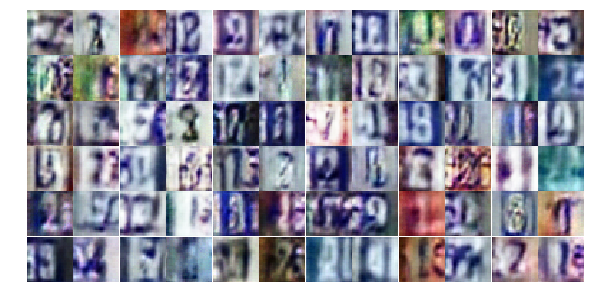

Epoch 8/25... Discriminator Loss: 0.2483... Generator Loss: 2.6865
Epoch 8/25... Discriminator Loss: 0.6546... Generator Loss: 1.0388
Epoch 8/25... Discriminator Loss: 0.3498... Generator Loss: 1.8017
Epoch 8/25... Discriminator Loss: 0.4743... Generator Loss: 1.3369
Epoch 8/25... Discriminator Loss: 0.2274... Generator Loss: 2.2851
Epoch 8/25... Discriminator Loss: 0.8525... Generator Loss: 4.3970
Epoch 8/25... Discriminator Loss: 1.1236... Generator Loss: 0.5872
Epoch 8/25... Discriminator Loss: 0.8690... Generator Loss: 0.7975
Epoch 8/25... Discriminator Loss: 0.4575... Generator Loss: 1.6676
Epoch 8/25... Discriminator Loss: 0.3524... Generator Loss: 1.8194


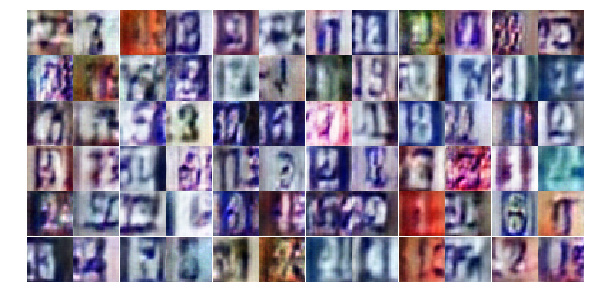

Epoch 8/25... Discriminator Loss: 0.3760... Generator Loss: 1.6195
Epoch 8/25... Discriminator Loss: 0.3673... Generator Loss: 2.0061
Epoch 8/25... Discriminator Loss: 0.3677... Generator Loss: 1.5920
Epoch 8/25... Discriminator Loss: 0.4300... Generator Loss: 1.3610
Epoch 8/25... Discriminator Loss: 1.4577... Generator Loss: 4.4060
Epoch 8/25... Discriminator Loss: 1.6110... Generator Loss: 0.3461
Epoch 8/25... Discriminator Loss: 0.5055... Generator Loss: 1.5387
Epoch 8/25... Discriminator Loss: 0.4309... Generator Loss: 1.7676
Epoch 8/25... Discriminator Loss: 0.6009... Generator Loss: 1.7772
Epoch 8/25... Discriminator Loss: 0.6222... Generator Loss: 1.1690


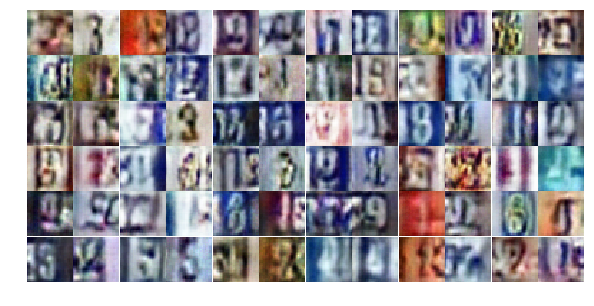

Epoch 8/25... Discriminator Loss: 0.3092... Generator Loss: 2.0316
Epoch 8/25... Discriminator Loss: 0.3362... Generator Loss: 1.8501
Epoch 8/25... Discriminator Loss: 0.2299... Generator Loss: 2.2378
Epoch 8/25... Discriminator Loss: 0.4826... Generator Loss: 1.2956
Epoch 8/25... Discriminator Loss: 0.3118... Generator Loss: 1.9463
Epoch 8/25... Discriminator Loss: 0.8342... Generator Loss: 0.7599
Epoch 8/25... Discriminator Loss: 0.3941... Generator Loss: 1.6250
Epoch 8/25... Discriminator Loss: 0.2877... Generator Loss: 2.5390
Epoch 9/25... Discriminator Loss: 0.4978... Generator Loss: 1.4524
Epoch 9/25... Discriminator Loss: 0.3834... Generator Loss: 1.5394


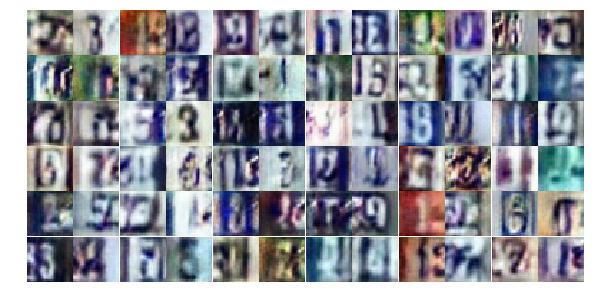

Epoch 9/25... Discriminator Loss: 0.2794... Generator Loss: 1.9328
Epoch 9/25... Discriminator Loss: 1.2088... Generator Loss: 0.7393
Epoch 9/25... Discriminator Loss: 2.1973... Generator Loss: 5.4421
Epoch 9/25... Discriminator Loss: 0.5189... Generator Loss: 4.0553
Epoch 9/25... Discriminator Loss: 0.8342... Generator Loss: 0.8477
Epoch 9/25... Discriminator Loss: 0.3909... Generator Loss: 2.0487
Epoch 9/25... Discriminator Loss: 0.3759... Generator Loss: 3.0768
Epoch 9/25... Discriminator Loss: 0.3252... Generator Loss: 1.9453
Epoch 9/25... Discriminator Loss: 0.5099... Generator Loss: 1.4184
Epoch 9/25... Discriminator Loss: 0.3437... Generator Loss: 1.7994


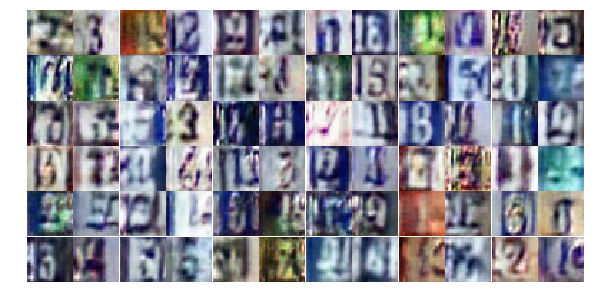

Epoch 9/25... Discriminator Loss: 0.4549... Generator Loss: 1.4258
Epoch 9/25... Discriminator Loss: 0.3923... Generator Loss: 2.5652
Epoch 9/25... Discriminator Loss: 0.3739... Generator Loss: 1.9771
Epoch 9/25... Discriminator Loss: 0.4813... Generator Loss: 2.0804
Epoch 9/25... Discriminator Loss: 0.3108... Generator Loss: 2.0959
Epoch 9/25... Discriminator Loss: 0.5539... Generator Loss: 1.8703
Epoch 9/25... Discriminator Loss: 1.1267... Generator Loss: 0.5688
Epoch 9/25... Discriminator Loss: 0.4251... Generator Loss: 1.4656
Epoch 9/25... Discriminator Loss: 0.7971... Generator Loss: 0.7805
Epoch 9/25... Discriminator Loss: 0.5261... Generator Loss: 1.3333


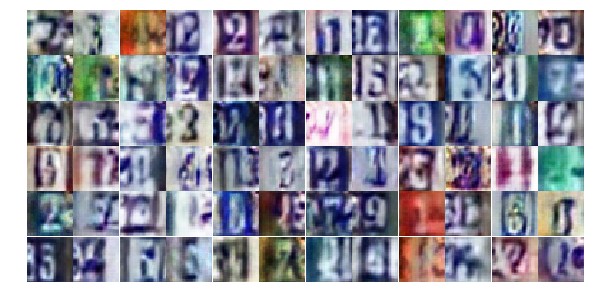

Epoch 9/25... Discriminator Loss: 0.4187... Generator Loss: 1.4859
Epoch 9/25... Discriminator Loss: 0.4241... Generator Loss: 1.4569
Epoch 9/25... Discriminator Loss: 0.3312... Generator Loss: 2.1906
Epoch 9/25... Discriminator Loss: 0.3344... Generator Loss: 1.7255
Epoch 9/25... Discriminator Loss: 2.4466... Generator Loss: 5.2511
Epoch 9/25... Discriminator Loss: 0.5754... Generator Loss: 1.3665
Epoch 9/25... Discriminator Loss: 0.9739... Generator Loss: 0.7638
Epoch 9/25... Discriminator Loss: 0.3765... Generator Loss: 3.1207
Epoch 9/25... Discriminator Loss: 0.3192... Generator Loss: 1.7560
Epoch 9/25... Discriminator Loss: 0.3980... Generator Loss: 1.6013


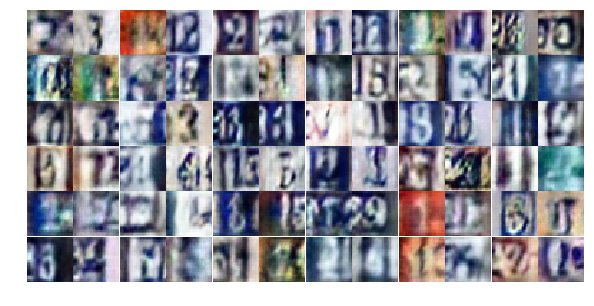

Epoch 9/25... Discriminator Loss: 0.2125... Generator Loss: 2.2663
Epoch 9/25... Discriminator Loss: 0.7163... Generator Loss: 1.0935
Epoch 9/25... Discriminator Loss: 0.7126... Generator Loss: 0.8770
Epoch 9/25... Discriminator Loss: 0.3921... Generator Loss: 2.3502
Epoch 9/25... Discriminator Loss: 0.3019... Generator Loss: 1.9468
Epoch 9/25... Discriminator Loss: 0.3142... Generator Loss: 1.9715
Epoch 9/25... Discriminator Loss: 0.2679... Generator Loss: 2.7376
Epoch 9/25... Discriminator Loss: 0.1120... Generator Loss: 3.4346
Epoch 9/25... Discriminator Loss: 1.1683... Generator Loss: 0.5616
Epoch 9/25... Discriminator Loss: 0.6767... Generator Loss: 1.0100


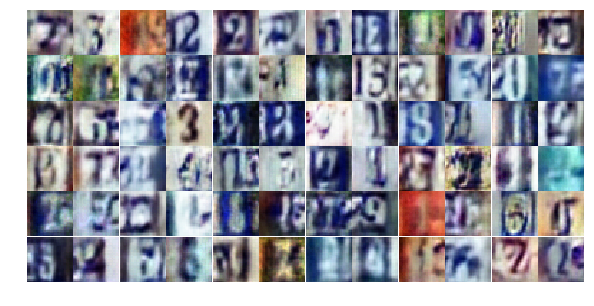

Epoch 9/25... Discriminator Loss: 0.4816... Generator Loss: 3.7696
Epoch 9/25... Discriminator Loss: 0.1342... Generator Loss: 2.9522
Epoch 9/25... Discriminator Loss: 2.5402... Generator Loss: 5.9810
Epoch 9/25... Discriminator Loss: 0.9608... Generator Loss: 0.9236
Epoch 9/25... Discriminator Loss: 0.4885... Generator Loss: 2.3833
Epoch 9/25... Discriminator Loss: 0.7434... Generator Loss: 0.9351
Epoch 9/25... Discriminator Loss: 0.7940... Generator Loss: 0.8482
Epoch 9/25... Discriminator Loss: 0.6808... Generator Loss: 0.9475
Epoch 9/25... Discriminator Loss: 0.3078... Generator Loss: 2.1215
Epoch 9/25... Discriminator Loss: 1.9097... Generator Loss: 6.2026


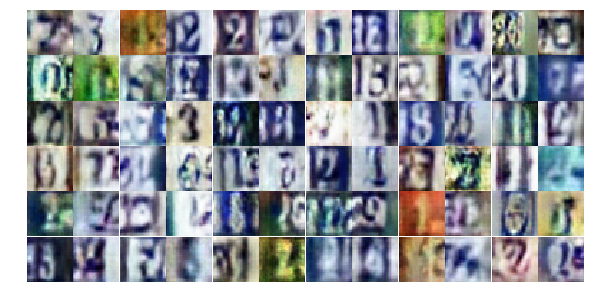

Epoch 9/25... Discriminator Loss: 1.9538... Generator Loss: 0.2771
Epoch 9/25... Discriminator Loss: 0.8341... Generator Loss: 1.0821
Epoch 9/25... Discriminator Loss: 0.3771... Generator Loss: 1.9878
Epoch 9/25... Discriminator Loss: 1.0795... Generator Loss: 0.6345
Epoch 9/25... Discriminator Loss: 0.5146... Generator Loss: 1.5166
Epoch 10/25... Discriminator Loss: 0.3099... Generator Loss: 2.1431
Epoch 10/25... Discriminator Loss: 0.3791... Generator Loss: 1.5802
Epoch 10/25... Discriminator Loss: 0.3821... Generator Loss: 1.5585
Epoch 10/25... Discriminator Loss: 1.0760... Generator Loss: 0.5611
Epoch 10/25... Discriminator Loss: 1.1765... Generator Loss: 0.5114


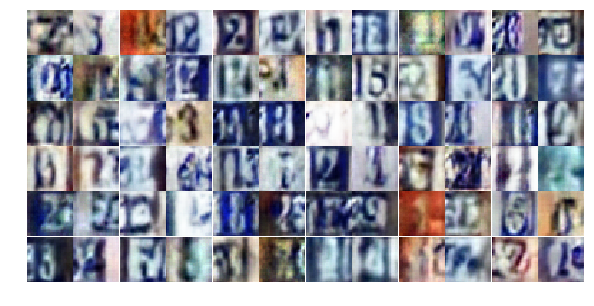

Epoch 10/25... Discriminator Loss: 0.4421... Generator Loss: 1.9628
Epoch 10/25... Discriminator Loss: 0.7259... Generator Loss: 1.1163
Epoch 10/25... Discriminator Loss: 0.5726... Generator Loss: 1.8986
Epoch 10/25... Discriminator Loss: 0.5114... Generator Loss: 1.3315
Epoch 10/25... Discriminator Loss: 0.2729... Generator Loss: 1.9962
Epoch 10/25... Discriminator Loss: 0.7736... Generator Loss: 0.8795
Epoch 10/25... Discriminator Loss: 0.1963... Generator Loss: 2.3607
Epoch 10/25... Discriminator Loss: 0.5084... Generator Loss: 1.3257
Epoch 10/25... Discriminator Loss: 0.5544... Generator Loss: 1.2893
Epoch 10/25... Discriminator Loss: 1.9769... Generator Loss: 0.2976


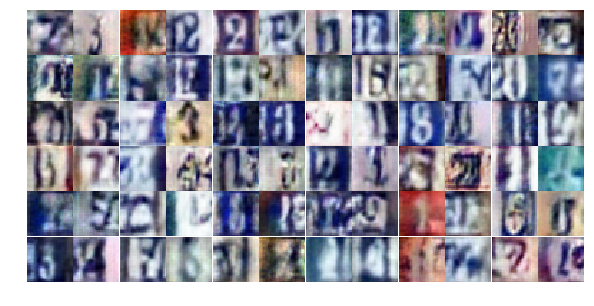

Epoch 10/25... Discriminator Loss: 0.8392... Generator Loss: 1.0255
Epoch 10/25... Discriminator Loss: 0.4758... Generator Loss: 2.0981
Epoch 10/25... Discriminator Loss: 0.4626... Generator Loss: 1.6147
Epoch 10/25... Discriminator Loss: 0.9123... Generator Loss: 0.7287
Epoch 10/25... Discriminator Loss: 0.3193... Generator Loss: 1.7578
Epoch 10/25... Discriminator Loss: 0.4756... Generator Loss: 1.3754
Epoch 10/25... Discriminator Loss: 0.3039... Generator Loss: 1.9422
Epoch 10/25... Discriminator Loss: 0.3259... Generator Loss: 2.0988
Epoch 10/25... Discriminator Loss: 0.4233... Generator Loss: 1.4942
Epoch 10/25... Discriminator Loss: 0.8337... Generator Loss: 3.9383


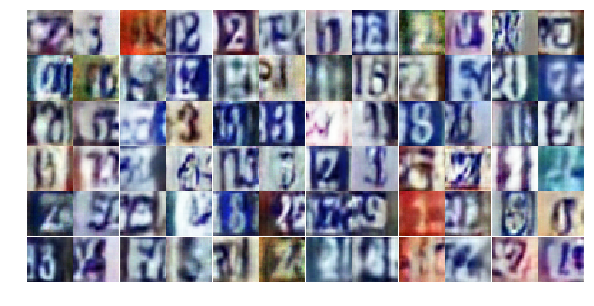

Epoch 10/25... Discriminator Loss: 1.1953... Generator Loss: 0.5002
Epoch 10/25... Discriminator Loss: 0.7727... Generator Loss: 0.8972
Epoch 10/25... Discriminator Loss: 1.2974... Generator Loss: 4.6989
Epoch 10/25... Discriminator Loss: 1.0857... Generator Loss: 4.2275
Epoch 10/25... Discriminator Loss: 0.5386... Generator Loss: 1.7080
Epoch 10/25... Discriminator Loss: 0.5109... Generator Loss: 1.2509
Epoch 10/25... Discriminator Loss: 0.3318... Generator Loss: 1.6415
Epoch 10/25... Discriminator Loss: 0.7165... Generator Loss: 2.0124
Epoch 10/25... Discriminator Loss: 0.4765... Generator Loss: 1.3528
Epoch 10/25... Discriminator Loss: 0.5253... Generator Loss: 2.9333


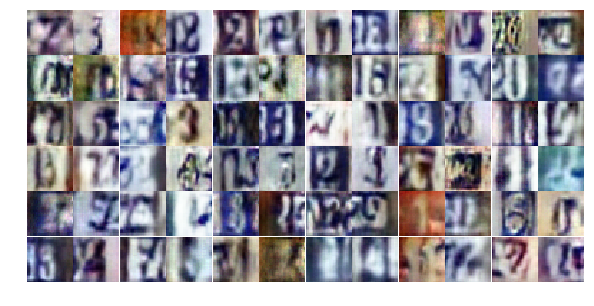

Epoch 10/25... Discriminator Loss: 0.6685... Generator Loss: 3.0107
Epoch 10/25... Discriminator Loss: 0.5660... Generator Loss: 1.2706
Epoch 10/25... Discriminator Loss: 0.3823... Generator Loss: 3.3101
Epoch 10/25... Discriminator Loss: 1.0450... Generator Loss: 0.6662
Epoch 10/25... Discriminator Loss: 0.5734... Generator Loss: 1.1270
Epoch 10/25... Discriminator Loss: 0.5995... Generator Loss: 1.0722
Epoch 10/25... Discriminator Loss: 0.4945... Generator Loss: 1.2382
Epoch 10/25... Discriminator Loss: 0.5879... Generator Loss: 1.3453
Epoch 10/25... Discriminator Loss: 0.3999... Generator Loss: 1.5891
Epoch 10/25... Discriminator Loss: 3.6934... Generator Loss: 7.1666


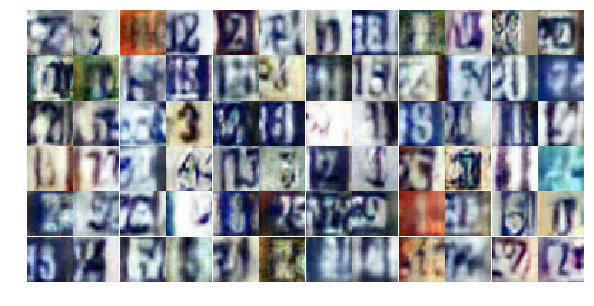

Epoch 10/25... Discriminator Loss: 1.1000... Generator Loss: 0.6343
Epoch 10/25... Discriminator Loss: 0.6490... Generator Loss: 1.1997
Epoch 10/25... Discriminator Loss: 1.4440... Generator Loss: 0.4535
Epoch 10/25... Discriminator Loss: 1.1299... Generator Loss: 0.5558
Epoch 10/25... Discriminator Loss: 0.3887... Generator Loss: 1.7887
Epoch 10/25... Discriminator Loss: 0.4757... Generator Loss: 1.4811
Epoch 10/25... Discriminator Loss: 0.4501... Generator Loss: 1.7733
Epoch 10/25... Discriminator Loss: 0.5534... Generator Loss: 2.4199
Epoch 10/25... Discriminator Loss: 0.4845... Generator Loss: 2.4340
Epoch 10/25... Discriminator Loss: 0.4136... Generator Loss: 1.6487


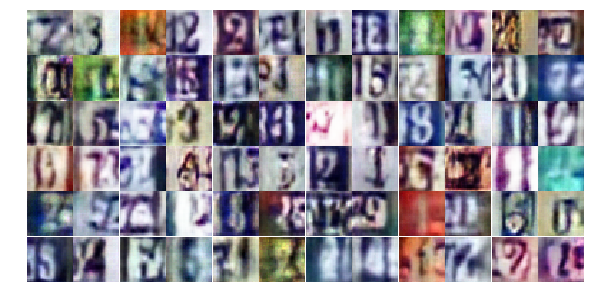

Epoch 10/25... Discriminator Loss: 0.5260... Generator Loss: 2.2719
Epoch 10/25... Discriminator Loss: 0.2738... Generator Loss: 2.1502
Epoch 10/25... Discriminator Loss: 0.4353... Generator Loss: 1.5040
Epoch 11/25... Discriminator Loss: 0.5321... Generator Loss: 1.2618
Epoch 11/25... Discriminator Loss: 0.4841... Generator Loss: 1.3058
Epoch 11/25... Discriminator Loss: 1.6280... Generator Loss: 0.3632
Epoch 11/25... Discriminator Loss: 0.4907... Generator Loss: 1.5584
Epoch 11/25... Discriminator Loss: 0.3627... Generator Loss: 2.0057
Epoch 11/25... Discriminator Loss: 2.0916... Generator Loss: 0.1988
Epoch 11/25... Discriminator Loss: 0.3738... Generator Loss: 2.1718


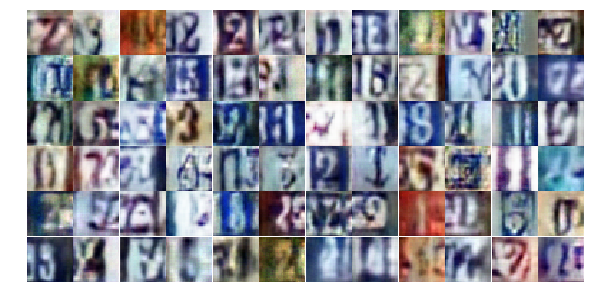

Epoch 11/25... Discriminator Loss: 0.2027... Generator Loss: 2.5265
Epoch 11/25... Discriminator Loss: 0.4318... Generator Loss: 1.6761
Epoch 11/25... Discriminator Loss: 0.2246... Generator Loss: 2.4281
Epoch 11/25... Discriminator Loss: 0.3239... Generator Loss: 1.8325
Epoch 11/25... Discriminator Loss: 0.5069... Generator Loss: 1.3446
Epoch 11/25... Discriminator Loss: 0.1423... Generator Loss: 2.6391
Epoch 11/25... Discriminator Loss: 0.3268... Generator Loss: 1.8440
Epoch 11/25... Discriminator Loss: 0.1609... Generator Loss: 2.5164
Epoch 11/25... Discriminator Loss: 0.3959... Generator Loss: 1.5350
Epoch 11/25... Discriminator Loss: 1.6619... Generator Loss: 0.3614


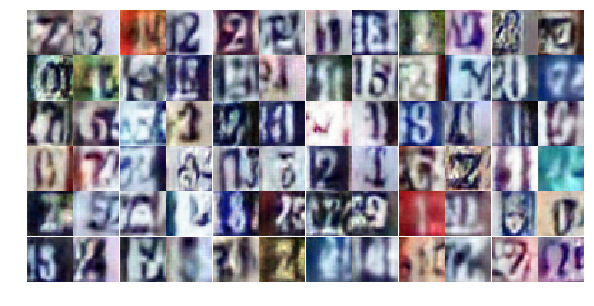

Epoch 11/25... Discriminator Loss: 1.5259... Generator Loss: 0.3511
Epoch 11/25... Discriminator Loss: 0.3473... Generator Loss: 3.5988
Epoch 11/25... Discriminator Loss: 0.4975... Generator Loss: 1.2779
Epoch 11/25... Discriminator Loss: 0.3879... Generator Loss: 1.5562
Epoch 11/25... Discriminator Loss: 0.2642... Generator Loss: 2.0584
Epoch 11/25... Discriminator Loss: 0.4058... Generator Loss: 1.7945
Epoch 11/25... Discriminator Loss: 0.3584... Generator Loss: 1.6841
Epoch 11/25... Discriminator Loss: 1.2647... Generator Loss: 0.5266
Epoch 11/25... Discriminator Loss: 0.2984... Generator Loss: 1.8915
Epoch 11/25... Discriminator Loss: 0.5851... Generator Loss: 1.1553


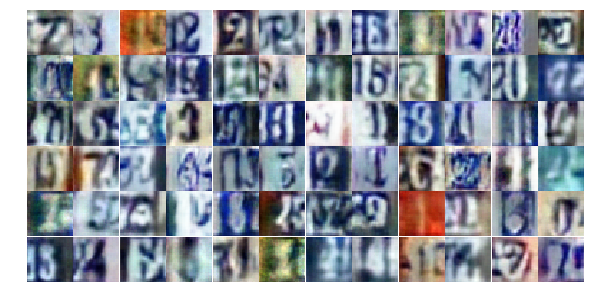

Epoch 11/25... Discriminator Loss: 0.5100... Generator Loss: 2.1309
Epoch 11/25... Discriminator Loss: 0.7060... Generator Loss: 0.9604
Epoch 11/25... Discriminator Loss: 0.5184... Generator Loss: 1.6900
Epoch 11/25... Discriminator Loss: 0.1445... Generator Loss: 2.9013
Epoch 11/25... Discriminator Loss: 0.4387... Generator Loss: 1.4762
Epoch 11/25... Discriminator Loss: 0.8018... Generator Loss: 0.9130
Epoch 11/25... Discriminator Loss: 1.1182... Generator Loss: 4.9607
Epoch 11/25... Discriminator Loss: 1.0656... Generator Loss: 0.6056
Epoch 11/25... Discriminator Loss: 0.4857... Generator Loss: 1.4403
Epoch 11/25... Discriminator Loss: 0.6195... Generator Loss: 2.9122


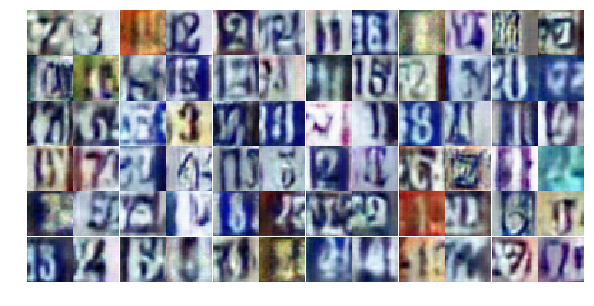

Epoch 11/25... Discriminator Loss: 0.2967... Generator Loss: 2.3266
Epoch 11/25... Discriminator Loss: 0.6595... Generator Loss: 1.0055
Epoch 11/25... Discriminator Loss: 0.5526... Generator Loss: 1.1737
Epoch 11/25... Discriminator Loss: 0.2199... Generator Loss: 2.5531
Epoch 11/25... Discriminator Loss: 0.9274... Generator Loss: 0.7048
Epoch 11/25... Discriminator Loss: 0.2585... Generator Loss: 2.0000
Epoch 11/25... Discriminator Loss: 0.7163... Generator Loss: 1.0320
Epoch 11/25... Discriminator Loss: 0.9071... Generator Loss: 3.0389
Epoch 11/25... Discriminator Loss: 1.0136... Generator Loss: 1.1776
Epoch 11/25... Discriminator Loss: 0.3478... Generator Loss: 2.1815


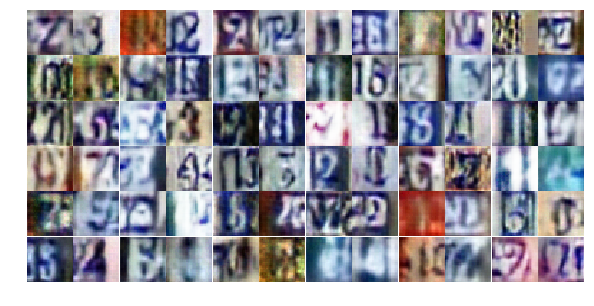

Epoch 11/25... Discriminator Loss: 0.5099... Generator Loss: 1.4322
Epoch 11/25... Discriminator Loss: 0.2924... Generator Loss: 2.0153
Epoch 11/25... Discriminator Loss: 0.4099... Generator Loss: 1.6920
Epoch 11/25... Discriminator Loss: 0.1715... Generator Loss: 2.5124
Epoch 11/25... Discriminator Loss: 0.9948... Generator Loss: 0.8028
Epoch 11/25... Discriminator Loss: 0.5403... Generator Loss: 1.2545
Epoch 11/25... Discriminator Loss: 0.6679... Generator Loss: 1.1745
Epoch 11/25... Discriminator Loss: 0.4242... Generator Loss: 3.1283
Epoch 11/25... Discriminator Loss: 0.7891... Generator Loss: 0.8104
Epoch 11/25... Discriminator Loss: 0.8748... Generator Loss: 0.7887


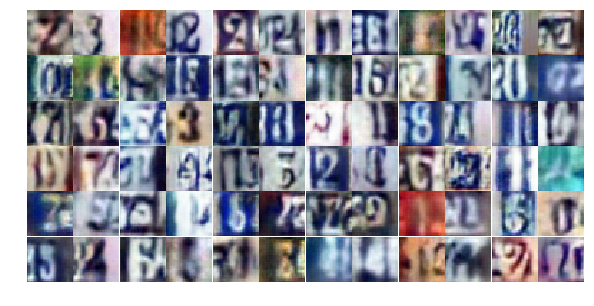

Epoch 12/25... Discriminator Loss: 0.2683... Generator Loss: 2.4041
Epoch 12/25... Discriminator Loss: 0.3967... Generator Loss: 1.4206
Epoch 12/25... Discriminator Loss: 0.4977... Generator Loss: 2.2285
Epoch 12/25... Discriminator Loss: 0.4172... Generator Loss: 1.4633
Epoch 12/25... Discriminator Loss: 0.1595... Generator Loss: 3.6835
Epoch 12/25... Discriminator Loss: 0.2216... Generator Loss: 2.5343
Epoch 12/25... Discriminator Loss: 0.5724... Generator Loss: 1.6592
Epoch 12/25... Discriminator Loss: 0.5971... Generator Loss: 1.3417
Epoch 12/25... Discriminator Loss: 0.4467... Generator Loss: 1.5583
Epoch 12/25... Discriminator Loss: 0.9289... Generator Loss: 0.7181


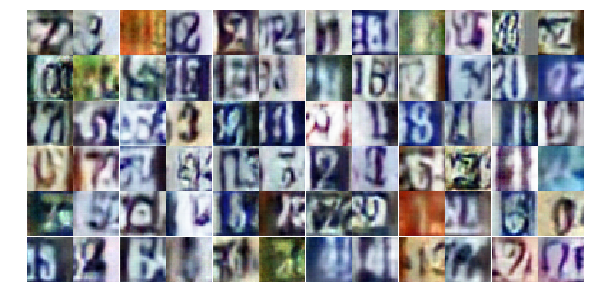

Epoch 12/25... Discriminator Loss: 0.3863... Generator Loss: 1.4845
Epoch 12/25... Discriminator Loss: 0.3769... Generator Loss: 1.9201
Epoch 12/25... Discriminator Loss: 0.3222... Generator Loss: 2.1071
Epoch 12/25... Discriminator Loss: 1.0813... Generator Loss: 0.6348
Epoch 12/25... Discriminator Loss: 0.4146... Generator Loss: 1.9533
Epoch 12/25... Discriminator Loss: 1.7336... Generator Loss: 0.4159
Epoch 12/25... Discriminator Loss: 0.9155... Generator Loss: 0.8498
Epoch 12/25... Discriminator Loss: 0.3004... Generator Loss: 2.4396
Epoch 12/25... Discriminator Loss: 0.4012... Generator Loss: 1.6373
Epoch 12/25... Discriminator Loss: 0.6937... Generator Loss: 0.9819


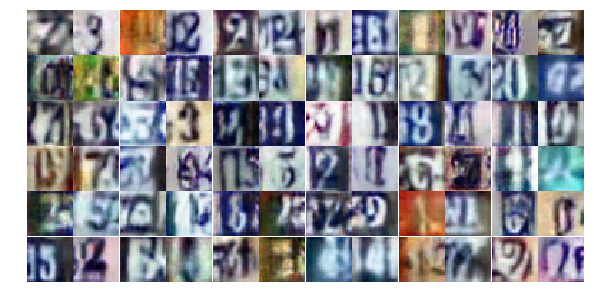

Epoch 12/25... Discriminator Loss: 0.2708... Generator Loss: 1.9432
Epoch 12/25... Discriminator Loss: 0.4332... Generator Loss: 1.3433
Epoch 12/25... Discriminator Loss: 0.3442... Generator Loss: 1.6469
Epoch 12/25... Discriminator Loss: 0.3354... Generator Loss: 2.4547
Epoch 12/25... Discriminator Loss: 0.1892... Generator Loss: 3.2839
Epoch 12/25... Discriminator Loss: 0.4237... Generator Loss: 1.4080
Epoch 12/25... Discriminator Loss: 0.5955... Generator Loss: 1.2253
Epoch 12/25... Discriminator Loss: 0.3772... Generator Loss: 1.5030
Epoch 12/25... Discriminator Loss: 0.3683... Generator Loss: 1.8906
Epoch 12/25... Discriminator Loss: 0.3543... Generator Loss: 2.0358


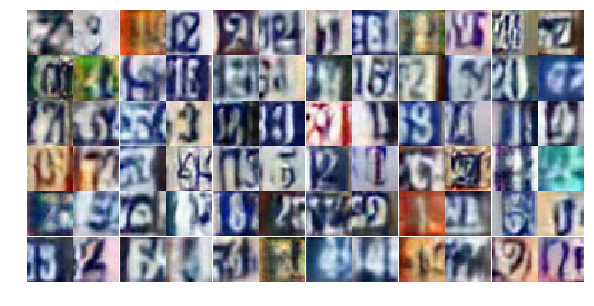

Epoch 12/25... Discriminator Loss: 0.4442... Generator Loss: 1.3284
Epoch 12/25... Discriminator Loss: 0.2694... Generator Loss: 1.9191
Epoch 12/25... Discriminator Loss: 1.4503... Generator Loss: 0.3888
Epoch 12/25... Discriminator Loss: 1.5228... Generator Loss: 0.4279
Epoch 12/25... Discriminator Loss: 0.3992... Generator Loss: 2.8932
Epoch 12/25... Discriminator Loss: 0.4614... Generator Loss: 1.6713
Epoch 12/25... Discriminator Loss: 0.3277... Generator Loss: 1.8979
Epoch 12/25... Discriminator Loss: 0.5651... Generator Loss: 1.2483
Epoch 12/25... Discriminator Loss: 0.2147... Generator Loss: 2.8701
Epoch 12/25... Discriminator Loss: 0.1436... Generator Loss: 2.4388


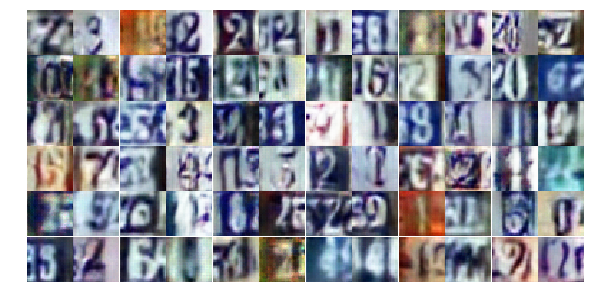

Epoch 12/25... Discriminator Loss: 0.2748... Generator Loss: 1.9184
Epoch 12/25... Discriminator Loss: 0.1978... Generator Loss: 2.2846
Epoch 12/25... Discriminator Loss: 0.2219... Generator Loss: 2.3057
Epoch 12/25... Discriminator Loss: 0.1881... Generator Loss: 2.4032
Epoch 12/25... Discriminator Loss: 0.2766... Generator Loss: 2.1090
Epoch 12/25... Discriminator Loss: 0.4330... Generator Loss: 1.4700
Epoch 12/25... Discriminator Loss: 0.3001... Generator Loss: 1.9667
Epoch 12/25... Discriminator Loss: 0.4213... Generator Loss: 1.5146
Epoch 12/25... Discriminator Loss: 0.4122... Generator Loss: 1.5252
Epoch 12/25... Discriminator Loss: 0.3918... Generator Loss: 1.5325


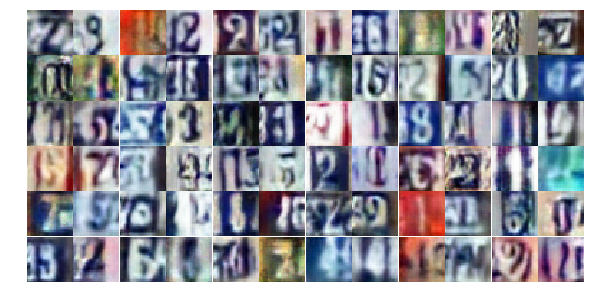

Epoch 12/25... Discriminator Loss: 0.2526... Generator Loss: 2.5424
Epoch 12/25... Discriminator Loss: 0.7784... Generator Loss: 3.7309
Epoch 12/25... Discriminator Loss: 1.4999... Generator Loss: 4.5213
Epoch 12/25... Discriminator Loss: 2.1804... Generator Loss: 0.2222
Epoch 12/25... Discriminator Loss: 0.3833... Generator Loss: 2.2639
Epoch 12/25... Discriminator Loss: 1.5390... Generator Loss: 1.0811
Epoch 12/25... Discriminator Loss: 0.6634... Generator Loss: 1.1088
Epoch 13/25... Discriminator Loss: 0.8733... Generator Loss: 0.8636
Epoch 13/25... Discriminator Loss: 0.4113... Generator Loss: 1.9091
Epoch 13/25... Discriminator Loss: 1.2053... Generator Loss: 0.4757


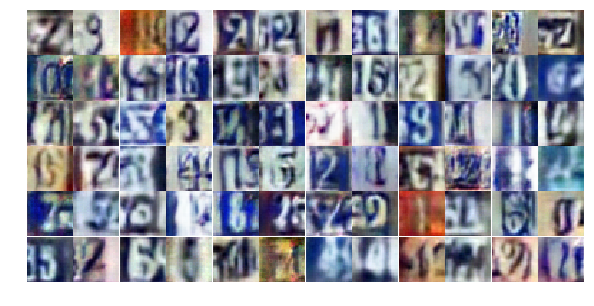

Epoch 13/25... Discriminator Loss: 0.5017... Generator Loss: 1.3391
Epoch 13/25... Discriminator Loss: 0.3715... Generator Loss: 2.5227
Epoch 13/25... Discriminator Loss: 0.7615... Generator Loss: 0.8881
Epoch 13/25... Discriminator Loss: 0.9402... Generator Loss: 0.8350
Epoch 13/25... Discriminator Loss: 1.2148... Generator Loss: 0.6461
Epoch 13/25... Discriminator Loss: 0.6920... Generator Loss: 1.1059
Epoch 13/25... Discriminator Loss: 0.5094... Generator Loss: 1.2946
Epoch 13/25... Discriminator Loss: 0.4635... Generator Loss: 2.1743
Epoch 13/25... Discriminator Loss: 0.3809... Generator Loss: 1.5861
Epoch 13/25... Discriminator Loss: 0.3640... Generator Loss: 1.6908


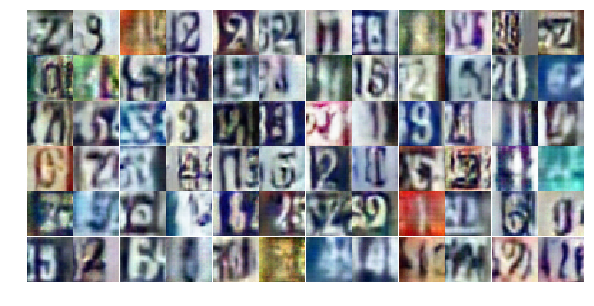

Epoch 13/25... Discriminator Loss: 0.9025... Generator Loss: 0.7756
Epoch 13/25... Discriminator Loss: 0.4997... Generator Loss: 1.2960
Epoch 13/25... Discriminator Loss: 1.3964... Generator Loss: 0.5319
Epoch 13/25... Discriminator Loss: 0.7743... Generator Loss: 0.8172
Epoch 13/25... Discriminator Loss: 0.4746... Generator Loss: 2.1350
Epoch 13/25... Discriminator Loss: 0.6283... Generator Loss: 1.0410
Epoch 13/25... Discriminator Loss: 0.4591... Generator Loss: 1.4871
Epoch 13/25... Discriminator Loss: 1.0958... Generator Loss: 0.6177
Epoch 13/25... Discriminator Loss: 0.5167... Generator Loss: 1.2499
Epoch 13/25... Discriminator Loss: 0.6112... Generator Loss: 1.1204


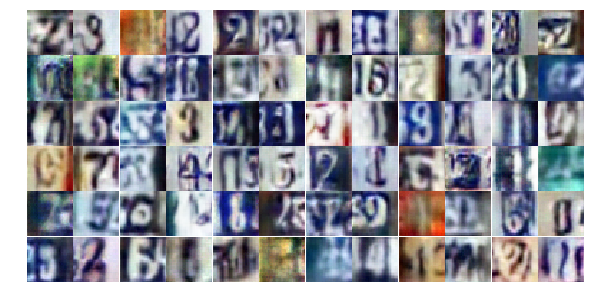

Epoch 13/25... Discriminator Loss: 0.4088... Generator Loss: 1.5361
Epoch 13/25... Discriminator Loss: 0.3913... Generator Loss: 1.6290
Epoch 13/25... Discriminator Loss: 0.7582... Generator Loss: 3.6752
Epoch 13/25... Discriminator Loss: 0.4077... Generator Loss: 1.5770
Epoch 13/25... Discriminator Loss: 0.5764... Generator Loss: 1.1025
Epoch 13/25... Discriminator Loss: 0.3673... Generator Loss: 1.5824
Epoch 13/25... Discriminator Loss: 0.4791... Generator Loss: 2.2420
Epoch 13/25... Discriminator Loss: 0.2856... Generator Loss: 2.0797
Epoch 13/25... Discriminator Loss: 0.7068... Generator Loss: 0.9733
Epoch 13/25... Discriminator Loss: 0.3038... Generator Loss: 1.8532


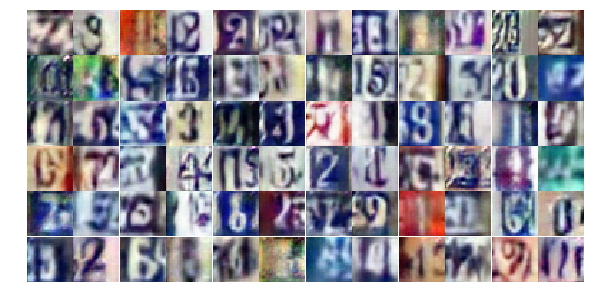

Epoch 13/25... Discriminator Loss: 1.1287... Generator Loss: 0.5789
Epoch 13/25... Discriminator Loss: 1.8630... Generator Loss: 0.2519
Epoch 13/25... Discriminator Loss: 1.1654... Generator Loss: 1.2999
Epoch 13/25... Discriminator Loss: 1.4253... Generator Loss: 2.4589
Epoch 13/25... Discriminator Loss: 0.4434... Generator Loss: 2.0079
Epoch 13/25... Discriminator Loss: 0.4608... Generator Loss: 1.5440
Epoch 13/25... Discriminator Loss: 0.5480... Generator Loss: 1.2901
Epoch 13/25... Discriminator Loss: 0.5689... Generator Loss: 1.4476
Epoch 13/25... Discriminator Loss: 0.5410... Generator Loss: 1.4658
Epoch 13/25... Discriminator Loss: 0.5635... Generator Loss: 1.1966


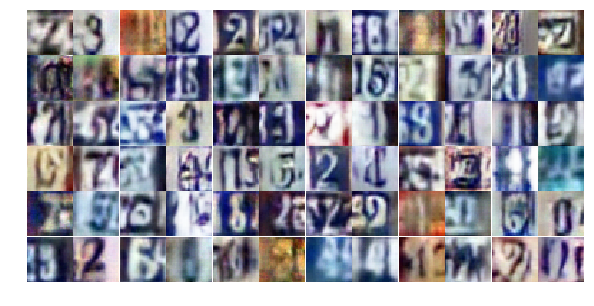

Epoch 13/25... Discriminator Loss: 0.3588... Generator Loss: 1.8893
Epoch 13/25... Discriminator Loss: 0.6380... Generator Loss: 1.0150
Epoch 13/25... Discriminator Loss: 0.5136... Generator Loss: 1.3488
Epoch 13/25... Discriminator Loss: 0.3327... Generator Loss: 1.8115
Epoch 13/25... Discriminator Loss: 0.8113... Generator Loss: 0.8222
Epoch 13/25... Discriminator Loss: 0.4928... Generator Loss: 1.3279
Epoch 13/25... Discriminator Loss: 0.6090... Generator Loss: 1.1576
Epoch 13/25... Discriminator Loss: 0.4502... Generator Loss: 1.6220
Epoch 13/25... Discriminator Loss: 0.7945... Generator Loss: 0.9002
Epoch 13/25... Discriminator Loss: 0.6847... Generator Loss: 1.0005


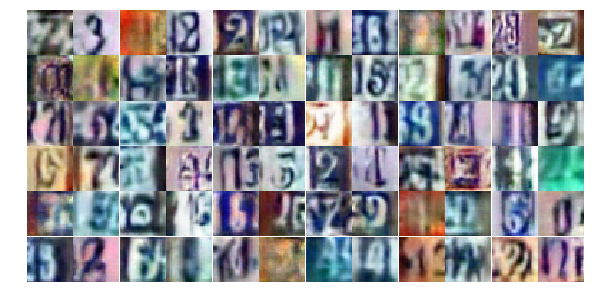

Epoch 13/25... Discriminator Loss: 0.2160... Generator Loss: 3.0573
Epoch 13/25... Discriminator Loss: 0.8356... Generator Loss: 0.8312
Epoch 13/25... Discriminator Loss: 0.3755... Generator Loss: 1.7830
Epoch 13/25... Discriminator Loss: 0.7464... Generator Loss: 1.8945
Epoch 14/25... Discriminator Loss: 0.4959... Generator Loss: 1.5532
Epoch 14/25... Discriminator Loss: 0.6041... Generator Loss: 1.1009
Epoch 14/25... Discriminator Loss: 0.6759... Generator Loss: 1.0900
Epoch 14/25... Discriminator Loss: 0.2420... Generator Loss: 2.0020
Epoch 14/25... Discriminator Loss: 0.4182... Generator Loss: 1.4637
Epoch 14/25... Discriminator Loss: 0.3462... Generator Loss: 1.8240


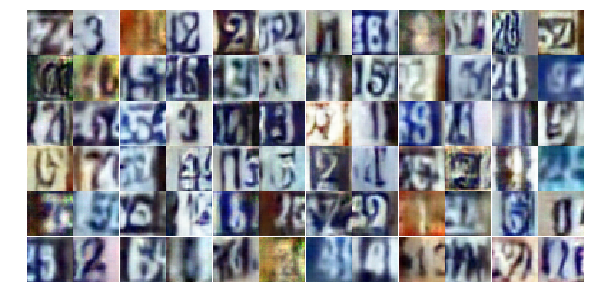

Epoch 14/25... Discriminator Loss: 1.6342... Generator Loss: 4.9739
Epoch 14/25... Discriminator Loss: 2.2388... Generator Loss: 1.3706
Epoch 14/25... Discriminator Loss: 1.6070... Generator Loss: 0.3768
Epoch 14/25... Discriminator Loss: 0.9875... Generator Loss: 0.9973
Epoch 14/25... Discriminator Loss: 0.8596... Generator Loss: 1.3741
Epoch 14/25... Discriminator Loss: 0.4753... Generator Loss: 1.9038
Epoch 14/25... Discriminator Loss: 0.4952... Generator Loss: 1.6593
Epoch 14/25... Discriminator Loss: 1.9176... Generator Loss: 0.2443
Epoch 14/25... Discriminator Loss: 0.7731... Generator Loss: 1.0730
Epoch 14/25... Discriminator Loss: 1.2344... Generator Loss: 0.5396


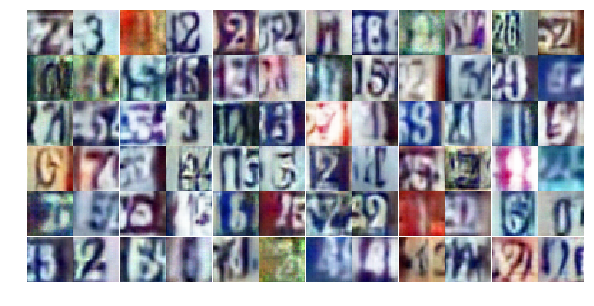

Epoch 14/25... Discriminator Loss: 0.3520... Generator Loss: 1.6731
Epoch 14/25... Discriminator Loss: 1.4704... Generator Loss: 4.0650
Epoch 14/25... Discriminator Loss: 0.5860... Generator Loss: 1.4567
Epoch 14/25... Discriminator Loss: 0.5009... Generator Loss: 1.3130
Epoch 14/25... Discriminator Loss: 0.8207... Generator Loss: 0.8592
Epoch 14/25... Discriminator Loss: 0.5509... Generator Loss: 1.3745
Epoch 14/25... Discriminator Loss: 0.8701... Generator Loss: 0.7663
Epoch 14/25... Discriminator Loss: 0.9948... Generator Loss: 0.6662
Epoch 14/25... Discriminator Loss: 0.5492... Generator Loss: 1.3347
Epoch 14/25... Discriminator Loss: 0.3821... Generator Loss: 2.4940


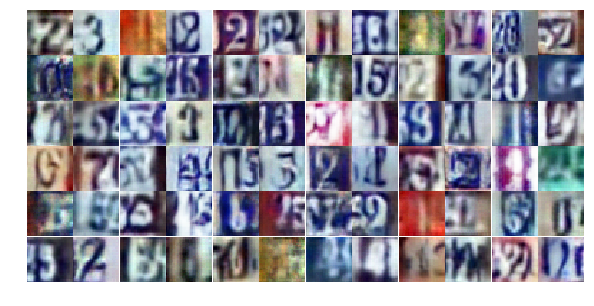

Epoch 14/25... Discriminator Loss: 1.0254... Generator Loss: 0.6229
Epoch 14/25... Discriminator Loss: 0.5990... Generator Loss: 1.0557
Epoch 14/25... Discriminator Loss: 0.4652... Generator Loss: 1.3083
Epoch 14/25... Discriminator Loss: 0.4434... Generator Loss: 1.3437
Epoch 14/25... Discriminator Loss: 0.4202... Generator Loss: 1.6448
Epoch 14/25... Discriminator Loss: 0.6252... Generator Loss: 1.0849
Epoch 14/25... Discriminator Loss: 0.5305... Generator Loss: 1.2958
Epoch 14/25... Discriminator Loss: 0.4035... Generator Loss: 2.6319
Epoch 14/25... Discriminator Loss: 0.4359... Generator Loss: 2.2300
Epoch 14/25... Discriminator Loss: 0.5464... Generator Loss: 1.9495


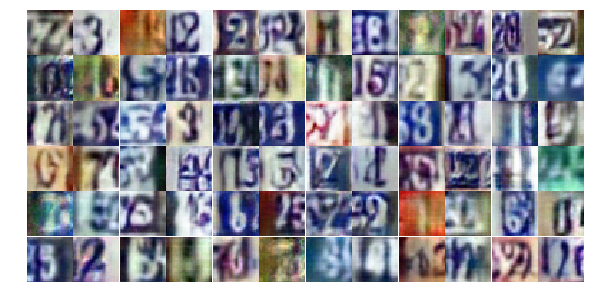

Epoch 14/25... Discriminator Loss: 1.1449... Generator Loss: 0.5002
Epoch 14/25... Discriminator Loss: 0.6500... Generator Loss: 1.4834
Epoch 14/25... Discriminator Loss: 0.9431... Generator Loss: 0.7557
Epoch 14/25... Discriminator Loss: 0.7627... Generator Loss: 0.8324
Epoch 14/25... Discriminator Loss: 0.8827... Generator Loss: 0.7138
Epoch 14/25... Discriminator Loss: 0.6073... Generator Loss: 1.1875
Epoch 14/25... Discriminator Loss: 0.5597... Generator Loss: 1.1313
Epoch 14/25... Discriminator Loss: 0.5400... Generator Loss: 1.2272
Epoch 14/25... Discriminator Loss: 1.2130... Generator Loss: 0.6643
Epoch 14/25... Discriminator Loss: 1.0665... Generator Loss: 0.5995


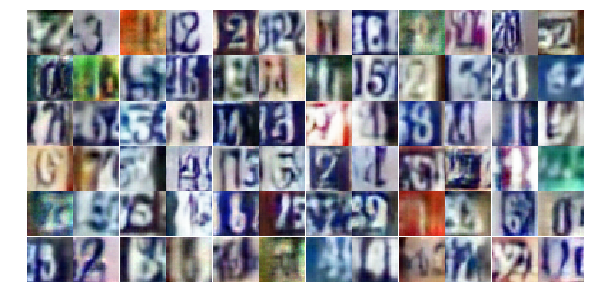

Epoch 14/25... Discriminator Loss: 0.7469... Generator Loss: 2.0749
Epoch 14/25... Discriminator Loss: 0.9041... Generator Loss: 0.7592
Epoch 14/25... Discriminator Loss: 0.4434... Generator Loss: 1.4987
Epoch 14/25... Discriminator Loss: 0.9486... Generator Loss: 0.7550
Epoch 14/25... Discriminator Loss: 0.4637... Generator Loss: 1.4775
Epoch 14/25... Discriminator Loss: 1.0410... Generator Loss: 0.6426
Epoch 14/25... Discriminator Loss: 0.5748... Generator Loss: 1.3977
Epoch 14/25... Discriminator Loss: 0.3863... Generator Loss: 1.6000
Epoch 14/25... Discriminator Loss: 0.9989... Generator Loss: 1.0321
Epoch 14/25... Discriminator Loss: 0.7822... Generator Loss: 2.6612


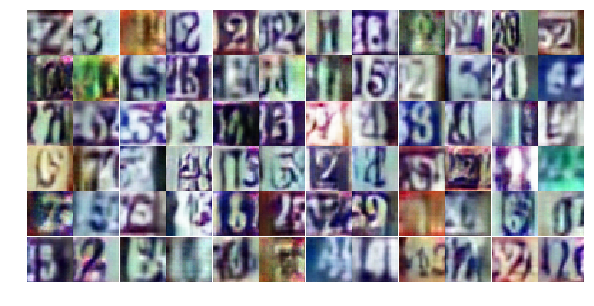

Epoch 14/25... Discriminator Loss: 0.7438... Generator Loss: 1.4155
Epoch 14/25... Discriminator Loss: 0.6301... Generator Loss: 1.1972
Epoch 15/25... Discriminator Loss: 0.4967... Generator Loss: 1.9152
Epoch 15/25... Discriminator Loss: 0.2992... Generator Loss: 1.9781
Epoch 15/25... Discriminator Loss: 0.3957... Generator Loss: 1.6986
Epoch 15/25... Discriminator Loss: 0.9949... Generator Loss: 0.6561
Epoch 15/25... Discriminator Loss: 0.4581... Generator Loss: 1.3691
Epoch 15/25... Discriminator Loss: 0.4391... Generator Loss: 2.6543
Epoch 15/25... Discriminator Loss: 2.7782... Generator Loss: 0.1630
Epoch 15/25... Discriminator Loss: 0.6897... Generator Loss: 1.3854


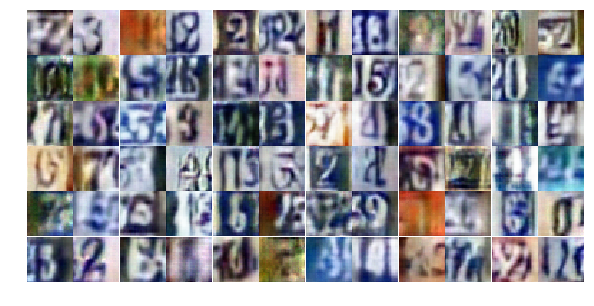

Epoch 15/25... Discriminator Loss: 1.0754... Generator Loss: 0.6969
Epoch 15/25... Discriminator Loss: 0.6211... Generator Loss: 2.0944
Epoch 15/25... Discriminator Loss: 0.8700... Generator Loss: 0.8069
Epoch 15/25... Discriminator Loss: 0.5539... Generator Loss: 1.1573
Epoch 15/25... Discriminator Loss: 0.6189... Generator Loss: 1.1591
Epoch 15/25... Discriminator Loss: 0.3484... Generator Loss: 1.8635
Epoch 15/25... Discriminator Loss: 1.2478... Generator Loss: 0.5114
Epoch 15/25... Discriminator Loss: 0.4453... Generator Loss: 1.5931
Epoch 15/25... Discriminator Loss: 0.3021... Generator Loss: 3.3566
Epoch 15/25... Discriminator Loss: 0.9038... Generator Loss: 0.7571


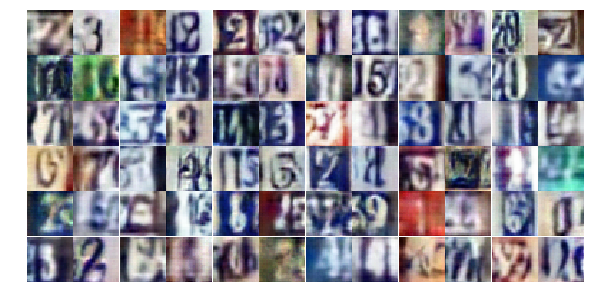

Epoch 15/25... Discriminator Loss: 0.8445... Generator Loss: 0.8692
Epoch 15/25... Discriminator Loss: 0.4024... Generator Loss: 1.5826
Epoch 15/25... Discriminator Loss: 0.2870... Generator Loss: 1.8828
Epoch 15/25... Discriminator Loss: 0.6857... Generator Loss: 1.0492
Epoch 15/25... Discriminator Loss: 1.3204... Generator Loss: 0.4741
Epoch 15/25... Discriminator Loss: 0.8491... Generator Loss: 0.8545
Epoch 15/25... Discriminator Loss: 1.1367... Generator Loss: 0.6068
Epoch 15/25... Discriminator Loss: 0.6058... Generator Loss: 1.1102
Epoch 15/25... Discriminator Loss: 0.6891... Generator Loss: 1.0093
Epoch 15/25... Discriminator Loss: 1.3428... Generator Loss: 0.4562


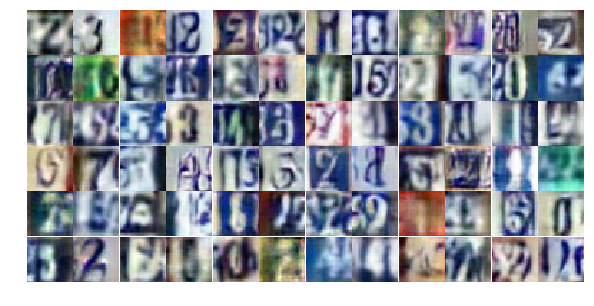

Epoch 15/25... Discriminator Loss: 0.5572... Generator Loss: 1.5052
Epoch 15/25... Discriminator Loss: 0.4600... Generator Loss: 1.6490
Epoch 15/25... Discriminator Loss: 0.4907... Generator Loss: 1.1457
Epoch 15/25... Discriminator Loss: 0.4448... Generator Loss: 1.5746
Epoch 15/25... Discriminator Loss: 0.4527... Generator Loss: 1.3688
Epoch 15/25... Discriminator Loss: 1.1607... Generator Loss: 3.4391
Epoch 15/25... Discriminator Loss: 0.4698... Generator Loss: 1.7790
Epoch 15/25... Discriminator Loss: 0.5685... Generator Loss: 1.1692
Epoch 15/25... Discriminator Loss: 0.5425... Generator Loss: 1.2319
Epoch 15/25... Discriminator Loss: 0.5340... Generator Loss: 1.2794


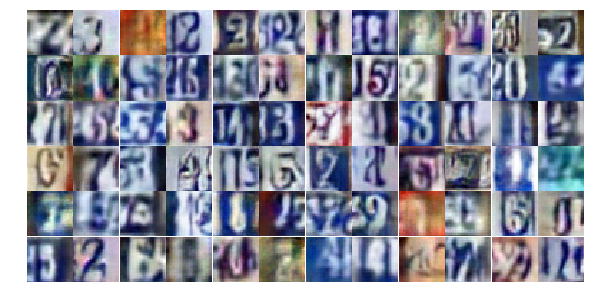

Epoch 15/25... Discriminator Loss: 0.6110... Generator Loss: 1.1639
Epoch 15/25... Discriminator Loss: 0.8153... Generator Loss: 0.8204
Epoch 15/25... Discriminator Loss: 0.5720... Generator Loss: 1.1534
Epoch 15/25... Discriminator Loss: 0.3957... Generator Loss: 1.4698
Epoch 15/25... Discriminator Loss: 0.4253... Generator Loss: 1.4164
Epoch 15/25... Discriminator Loss: 1.9595... Generator Loss: 0.2992
Epoch 15/25... Discriminator Loss: 0.5097... Generator Loss: 1.7510
Epoch 15/25... Discriminator Loss: 0.5591... Generator Loss: 2.4107
Epoch 15/25... Discriminator Loss: 0.4707... Generator Loss: 1.3784
Epoch 15/25... Discriminator Loss: 0.6379... Generator Loss: 1.0659


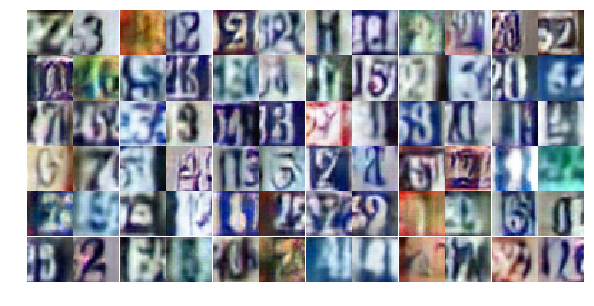

Epoch 15/25... Discriminator Loss: 0.5124... Generator Loss: 1.3333
Epoch 15/25... Discriminator Loss: 0.5983... Generator Loss: 1.1432
Epoch 15/25... Discriminator Loss: 0.2860... Generator Loss: 2.7565
Epoch 15/25... Discriminator Loss: 0.5272... Generator Loss: 1.2101
Epoch 15/25... Discriminator Loss: 0.2730... Generator Loss: 1.9268
Epoch 15/25... Discriminator Loss: 0.7879... Generator Loss: 3.4881
Epoch 15/25... Discriminator Loss: 0.5940... Generator Loss: 1.1442
Epoch 15/25... Discriminator Loss: 0.3428... Generator Loss: 2.1342
Epoch 15/25... Discriminator Loss: 0.9847... Generator Loss: 0.9054
Epoch 16/25... Discriminator Loss: 0.7365... Generator Loss: 0.9427


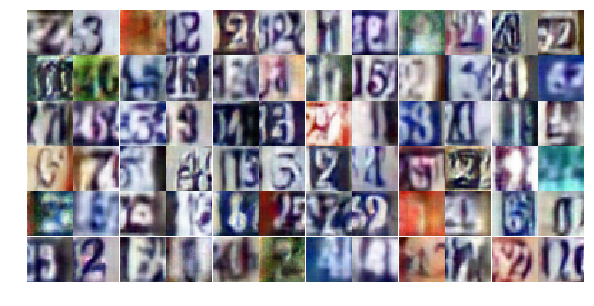

Epoch 16/25... Discriminator Loss: 0.3168... Generator Loss: 1.8333
Epoch 16/25... Discriminator Loss: 0.5437... Generator Loss: 1.1820
Epoch 16/25... Discriminator Loss: 0.7310... Generator Loss: 0.9551
Epoch 16/25... Discriminator Loss: 0.2603... Generator Loss: 2.1611
Epoch 16/25... Discriminator Loss: 0.3019... Generator Loss: 2.5872
Epoch 16/25... Discriminator Loss: 2.3513... Generator Loss: 4.1743
Epoch 16/25... Discriminator Loss: 2.3496... Generator Loss: 0.1785
Epoch 16/25... Discriminator Loss: 0.7276... Generator Loss: 0.9704
Epoch 16/25... Discriminator Loss: 0.7217... Generator Loss: 0.9281
Epoch 16/25... Discriminator Loss: 0.6381... Generator Loss: 1.0685


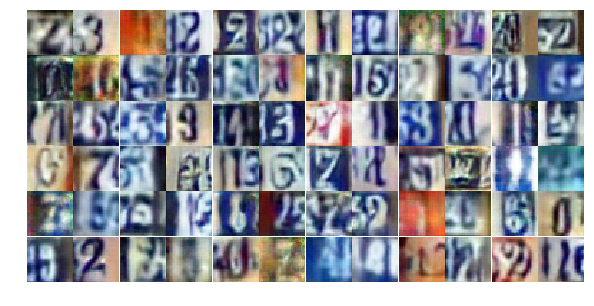

Epoch 16/25... Discriminator Loss: 0.9622... Generator Loss: 0.6691
Epoch 16/25... Discriminator Loss: 0.4507... Generator Loss: 1.5661
Epoch 16/25... Discriminator Loss: 0.6092... Generator Loss: 1.0936
Epoch 16/25... Discriminator Loss: 1.5981... Generator Loss: 0.3818
Epoch 16/25... Discriminator Loss: 0.4008... Generator Loss: 1.8867
Epoch 16/25... Discriminator Loss: 0.4600... Generator Loss: 1.6375
Epoch 16/25... Discriminator Loss: 1.3659... Generator Loss: 0.4270
Epoch 16/25... Discriminator Loss: 0.3736... Generator Loss: 1.6575
Epoch 16/25... Discriminator Loss: 0.3704... Generator Loss: 1.5489
Epoch 16/25... Discriminator Loss: 0.3691... Generator Loss: 1.9410


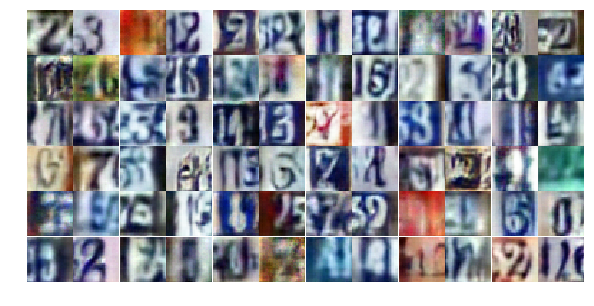

Epoch 16/25... Discriminator Loss: 0.6141... Generator Loss: 1.1632
Epoch 16/25... Discriminator Loss: 0.6046... Generator Loss: 1.1049
Epoch 16/25... Discriminator Loss: 0.5301... Generator Loss: 1.2469
Epoch 16/25... Discriminator Loss: 1.2412... Generator Loss: 0.5836
Epoch 16/25... Discriminator Loss: 0.5535... Generator Loss: 1.2262
Epoch 16/25... Discriminator Loss: 1.0417... Generator Loss: 0.6061
Epoch 16/25... Discriminator Loss: 0.6502... Generator Loss: 1.0805
Epoch 16/25... Discriminator Loss: 0.7374... Generator Loss: 0.9133
Epoch 16/25... Discriminator Loss: 0.5758... Generator Loss: 1.2030
Epoch 16/25... Discriminator Loss: 0.3760... Generator Loss: 1.6106


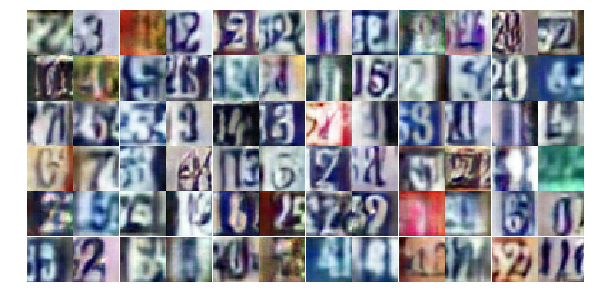

Epoch 16/25... Discriminator Loss: 0.3569... Generator Loss: 1.6195
Epoch 16/25... Discriminator Loss: 0.2320... Generator Loss: 2.1309
Epoch 16/25... Discriminator Loss: 0.2925... Generator Loss: 2.2425
Epoch 16/25... Discriminator Loss: 0.5443... Generator Loss: 1.4745
Epoch 16/25... Discriminator Loss: 1.0311... Generator Loss: 0.6559
Epoch 16/25... Discriminator Loss: 0.5913... Generator Loss: 1.0759
Epoch 16/25... Discriminator Loss: 0.4545... Generator Loss: 1.3022
Epoch 16/25... Discriminator Loss: 0.5900... Generator Loss: 1.1523
Epoch 16/25... Discriminator Loss: 0.3826... Generator Loss: 1.5081
Epoch 16/25... Discriminator Loss: 0.1644... Generator Loss: 2.7094


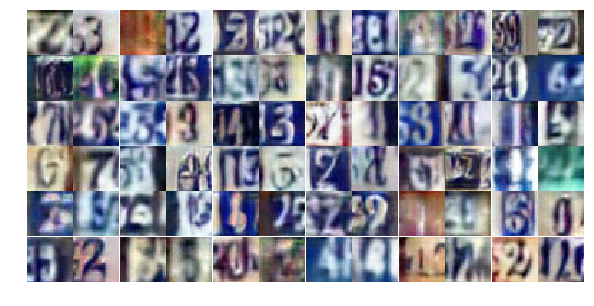

Epoch 16/25... Discriminator Loss: 0.2245... Generator Loss: 2.1378
Epoch 16/25... Discriminator Loss: 0.7993... Generator Loss: 0.8883
Epoch 16/25... Discriminator Loss: 0.6933... Generator Loss: 0.9943
Epoch 16/25... Discriminator Loss: 0.8392... Generator Loss: 0.9310
Epoch 16/25... Discriminator Loss: 0.5812... Generator Loss: 1.3744
Epoch 16/25... Discriminator Loss: 3.8251... Generator Loss: 5.8521
Epoch 16/25... Discriminator Loss: 0.6624... Generator Loss: 1.3778
Epoch 16/25... Discriminator Loss: 0.7783... Generator Loss: 0.9467
Epoch 16/25... Discriminator Loss: 0.4087... Generator Loss: 2.3616
Epoch 16/25... Discriminator Loss: 0.7600... Generator Loss: 0.9246


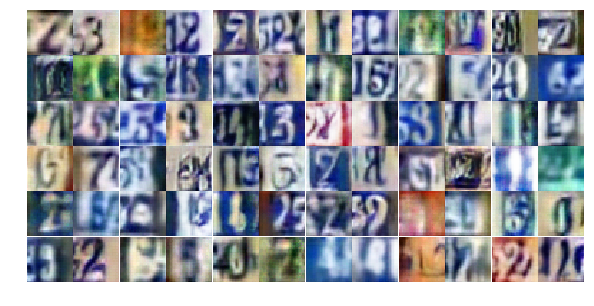

Epoch 16/25... Discriminator Loss: 1.0626... Generator Loss: 0.6378
Epoch 16/25... Discriminator Loss: 0.5698... Generator Loss: 1.3859
Epoch 16/25... Discriminator Loss: 1.7362... Generator Loss: 0.3279
Epoch 16/25... Discriminator Loss: 0.3863... Generator Loss: 1.6303
Epoch 16/25... Discriminator Loss: 0.6582... Generator Loss: 1.0596
Epoch 16/25... Discriminator Loss: 0.4405... Generator Loss: 1.3871
Epoch 17/25... Discriminator Loss: 0.4464... Generator Loss: 1.3547
Epoch 17/25... Discriminator Loss: 0.6909... Generator Loss: 0.9589
Epoch 17/25... Discriminator Loss: 0.5025... Generator Loss: 1.4528
Epoch 17/25... Discriminator Loss: 0.2385... Generator Loss: 2.4387


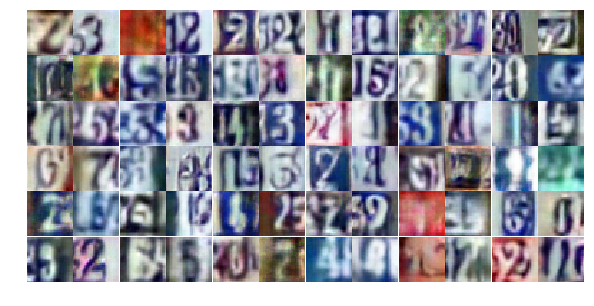

Epoch 17/25... Discriminator Loss: 0.3321... Generator Loss: 1.6630
Epoch 17/25... Discriminator Loss: 0.4318... Generator Loss: 1.3833
Epoch 17/25... Discriminator Loss: 0.6841... Generator Loss: 1.2728
Epoch 17/25... Discriminator Loss: 0.7784... Generator Loss: 1.7516
Epoch 17/25... Discriminator Loss: 0.8492... Generator Loss: 0.8583
Epoch 17/25... Discriminator Loss: 1.0929... Generator Loss: 0.6704
Epoch 17/25... Discriminator Loss: 1.0337... Generator Loss: 3.0331
Epoch 17/25... Discriminator Loss: 0.5718... Generator Loss: 1.1513
Epoch 17/25... Discriminator Loss: 0.3123... Generator Loss: 1.8115
Epoch 17/25... Discriminator Loss: 0.4645... Generator Loss: 1.3757


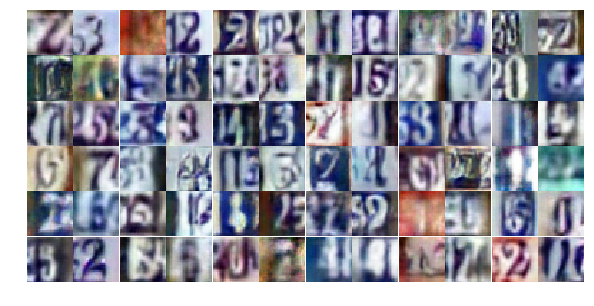

Epoch 17/25... Discriminator Loss: 0.5529... Generator Loss: 2.1980
Epoch 17/25... Discriminator Loss: 0.5947... Generator Loss: 1.1397
Epoch 17/25... Discriminator Loss: 0.3718... Generator Loss: 1.5847
Epoch 17/25... Discriminator Loss: 1.1408... Generator Loss: 0.6570
Epoch 17/25... Discriminator Loss: 0.2821... Generator Loss: 2.3335
Epoch 17/25... Discriminator Loss: 0.5519... Generator Loss: 1.1694
Epoch 17/25... Discriminator Loss: 0.4454... Generator Loss: 1.4665
Epoch 17/25... Discriminator Loss: 0.3404... Generator Loss: 1.6138
Epoch 17/25... Discriminator Loss: 0.2664... Generator Loss: 2.0179
Epoch 17/25... Discriminator Loss: 0.2342... Generator Loss: 2.0124


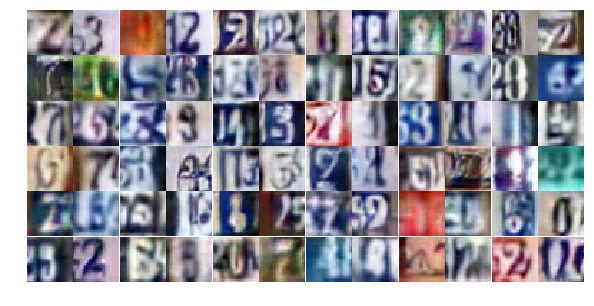

Epoch 17/25... Discriminator Loss: 0.7769... Generator Loss: 0.8510
Epoch 17/25... Discriminator Loss: 0.1732... Generator Loss: 2.6141
Epoch 17/25... Discriminator Loss: 0.1881... Generator Loss: 2.3306
Epoch 17/25... Discriminator Loss: 0.6494... Generator Loss: 0.9698
Epoch 17/25... Discriminator Loss: 1.3821... Generator Loss: 0.4890
Epoch 17/25... Discriminator Loss: 1.2642... Generator Loss: 0.6777
Epoch 17/25... Discriminator Loss: 0.8451... Generator Loss: 0.7949
Epoch 17/25... Discriminator Loss: 1.0226... Generator Loss: 0.7762
Epoch 17/25... Discriminator Loss: 1.4757... Generator Loss: 0.4664
Epoch 17/25... Discriminator Loss: 0.3237... Generator Loss: 2.0164


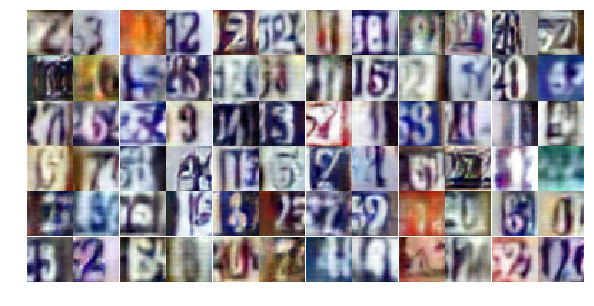

Epoch 17/25... Discriminator Loss: 1.0539... Generator Loss: 0.7339
Epoch 17/25... Discriminator Loss: 1.0208... Generator Loss: 2.7471
Epoch 17/25... Discriminator Loss: 0.5610... Generator Loss: 3.6012
Epoch 17/25... Discriminator Loss: 1.7306... Generator Loss: 0.3529
Epoch 17/25... Discriminator Loss: 0.5889... Generator Loss: 1.1543
Epoch 17/25... Discriminator Loss: 0.6677... Generator Loss: 1.0778
Epoch 17/25... Discriminator Loss: 0.3764... Generator Loss: 2.0082
Epoch 17/25... Discriminator Loss: 0.4954... Generator Loss: 1.2334
Epoch 17/25... Discriminator Loss: 0.4585... Generator Loss: 1.3047
Epoch 17/25... Discriminator Loss: 1.0703... Generator Loss: 0.5872


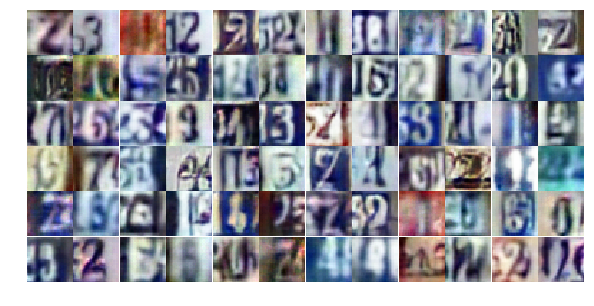

Epoch 17/25... Discriminator Loss: 1.3652... Generator Loss: 2.6864
Epoch 17/25... Discriminator Loss: 0.2916... Generator Loss: 1.9293
Epoch 17/25... Discriminator Loss: 0.7451... Generator Loss: 0.9314
Epoch 17/25... Discriminator Loss: 0.5550... Generator Loss: 1.1975
Epoch 17/25... Discriminator Loss: 0.5506... Generator Loss: 1.2471
Epoch 17/25... Discriminator Loss: 0.5844... Generator Loss: 1.3769
Epoch 17/25... Discriminator Loss: 1.2986... Generator Loss: 0.4916
Epoch 17/25... Discriminator Loss: 0.5118... Generator Loss: 1.2308
Epoch 17/25... Discriminator Loss: 0.5143... Generator Loss: 1.3539
Epoch 17/25... Discriminator Loss: 1.7911... Generator Loss: 0.2551


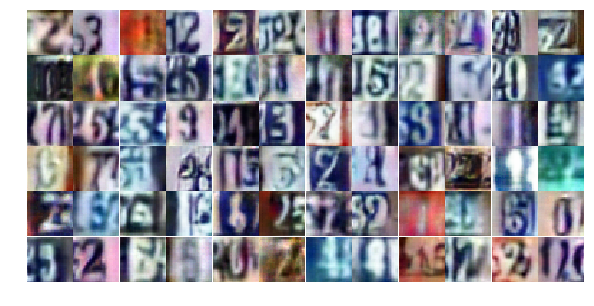

Epoch 17/25... Discriminator Loss: 1.7615... Generator Loss: 5.0125
Epoch 17/25... Discriminator Loss: 0.8092... Generator Loss: 2.5233
Epoch 17/25... Discriminator Loss: 0.4738... Generator Loss: 2.1675
Epoch 17/25... Discriminator Loss: 0.6844... Generator Loss: 1.1768
Epoch 18/25... Discriminator Loss: 1.0460... Generator Loss: 0.6366
Epoch 18/25... Discriminator Loss: 1.5004... Generator Loss: 0.3933
Epoch 18/25... Discriminator Loss: 0.5473... Generator Loss: 1.2503
Epoch 18/25... Discriminator Loss: 0.6099... Generator Loss: 1.1020
Epoch 18/25... Discriminator Loss: 1.3417... Generator Loss: 0.4551
Epoch 18/25... Discriminator Loss: 0.5443... Generator Loss: 1.2554


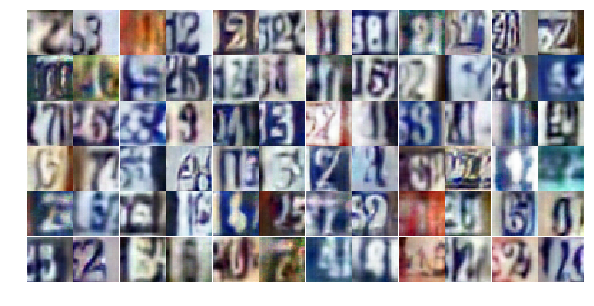

Epoch 18/25... Discriminator Loss: 0.7882... Generator Loss: 3.5205
Epoch 18/25... Discriminator Loss: 0.6071... Generator Loss: 1.2155
Epoch 18/25... Discriminator Loss: 0.6203... Generator Loss: 1.0667
Epoch 18/25... Discriminator Loss: 0.3685... Generator Loss: 1.7017
Epoch 18/25... Discriminator Loss: 0.5484... Generator Loss: 1.1937
Epoch 18/25... Discriminator Loss: 0.8440... Generator Loss: 0.8099
Epoch 18/25... Discriminator Loss: 0.9075... Generator Loss: 3.4714
Epoch 18/25... Discriminator Loss: 0.6611... Generator Loss: 1.1674
Epoch 18/25... Discriminator Loss: 0.7936... Generator Loss: 0.9040
Epoch 18/25... Discriminator Loss: 0.2402... Generator Loss: 2.0596


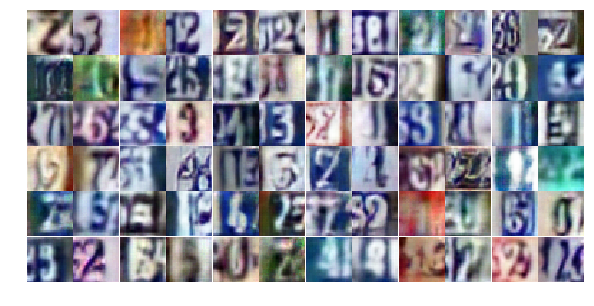

Epoch 18/25... Discriminator Loss: 0.4428... Generator Loss: 1.6316
Epoch 18/25... Discriminator Loss: 0.5894... Generator Loss: 1.1411
Epoch 18/25... Discriminator Loss: 0.5721... Generator Loss: 1.3672
Epoch 18/25... Discriminator Loss: 0.4101... Generator Loss: 1.6734
Epoch 18/25... Discriminator Loss: 0.7352... Generator Loss: 0.9243
Epoch 18/25... Discriminator Loss: 0.9127... Generator Loss: 0.7680
Epoch 18/25... Discriminator Loss: 0.6363... Generator Loss: 1.1461
Epoch 18/25... Discriminator Loss: 1.1487... Generator Loss: 0.5955
Epoch 18/25... Discriminator Loss: 0.4805... Generator Loss: 2.4791
Epoch 18/25... Discriminator Loss: 0.4997... Generator Loss: 1.8141


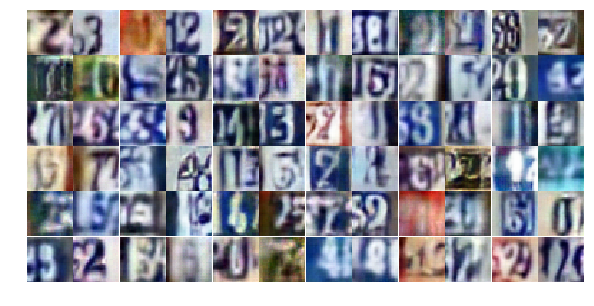

Epoch 18/25... Discriminator Loss: 0.5707... Generator Loss: 1.6487
Epoch 18/25... Discriminator Loss: 0.7511... Generator Loss: 1.4814
Epoch 18/25... Discriminator Loss: 0.7785... Generator Loss: 0.9344
Epoch 18/25... Discriminator Loss: 0.7001... Generator Loss: 1.1013
Epoch 18/25... Discriminator Loss: 0.8997... Generator Loss: 0.8784
Epoch 18/25... Discriminator Loss: 0.5472... Generator Loss: 1.3335
Epoch 18/25... Discriminator Loss: 0.5842... Generator Loss: 1.2642
Epoch 18/25... Discriminator Loss: 0.3534... Generator Loss: 1.9201
Epoch 18/25... Discriminator Loss: 0.4065... Generator Loss: 1.6957
Epoch 18/25... Discriminator Loss: 0.4753... Generator Loss: 1.4669


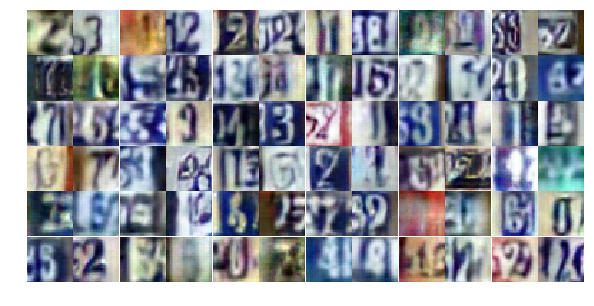

Epoch 18/25... Discriminator Loss: 0.4439... Generator Loss: 1.6431
Epoch 18/25... Discriminator Loss: 0.3532... Generator Loss: 1.7475
Epoch 18/25... Discriminator Loss: 0.4587... Generator Loss: 1.3614
Epoch 18/25... Discriminator Loss: 0.5113... Generator Loss: 1.2436
Epoch 18/25... Discriminator Loss: 0.7500... Generator Loss: 0.9086
Epoch 18/25... Discriminator Loss: 0.4422... Generator Loss: 1.3163
Epoch 18/25... Discriminator Loss: 0.8603... Generator Loss: 0.7930
Epoch 18/25... Discriminator Loss: 1.3150... Generator Loss: 3.6593
Epoch 18/25... Discriminator Loss: 0.9774... Generator Loss: 1.1580
Epoch 18/25... Discriminator Loss: 1.0692... Generator Loss: 0.9096


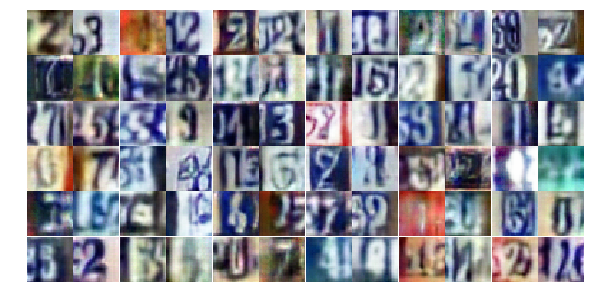

Epoch 18/25... Discriminator Loss: 0.6670... Generator Loss: 1.1116
Epoch 18/25... Discriminator Loss: 0.7121... Generator Loss: 1.2373
Epoch 18/25... Discriminator Loss: 0.7115... Generator Loss: 0.9383
Epoch 18/25... Discriminator Loss: 0.6580... Generator Loss: 1.0660
Epoch 18/25... Discriminator Loss: 0.5704... Generator Loss: 1.1832
Epoch 18/25... Discriminator Loss: 0.3876... Generator Loss: 1.6853
Epoch 18/25... Discriminator Loss: 0.3346... Generator Loss: 1.7907
Epoch 18/25... Discriminator Loss: 0.3377... Generator Loss: 2.3161
Epoch 18/25... Discriminator Loss: 1.0007... Generator Loss: 0.6767
Epoch 18/25... Discriminator Loss: 0.5146... Generator Loss: 1.2470


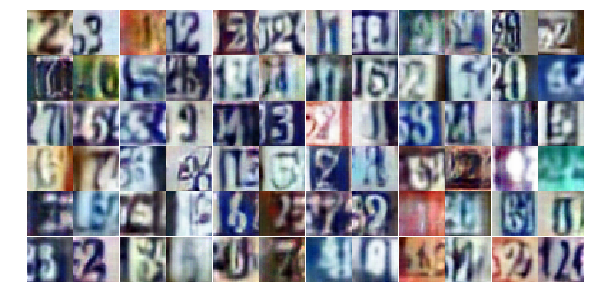

Epoch 18/25... Discriminator Loss: 0.5630... Generator Loss: 2.2795
Epoch 19/25... Discriminator Loss: 0.8776... Generator Loss: 0.7344
Epoch 19/25... Discriminator Loss: 0.8355... Generator Loss: 0.8373
Epoch 19/25... Discriminator Loss: 0.5346... Generator Loss: 1.2630
Epoch 19/25... Discriminator Loss: 0.3472... Generator Loss: 1.7178
Epoch 19/25... Discriminator Loss: 0.8273... Generator Loss: 0.7878
Epoch 19/25... Discriminator Loss: 0.2461... Generator Loss: 2.1688
Epoch 19/25... Discriminator Loss: 1.4494... Generator Loss: 0.4329
Epoch 19/25... Discriminator Loss: 0.7663... Generator Loss: 4.9039
Epoch 19/25... Discriminator Loss: 0.7125... Generator Loss: 0.9452


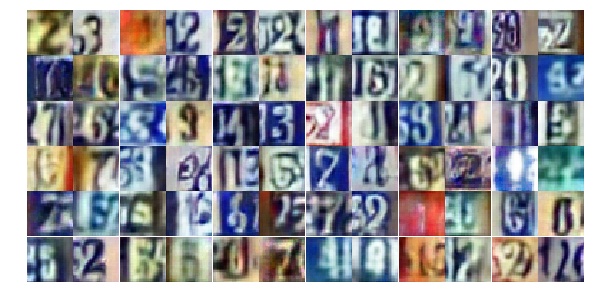

Epoch 19/25... Discriminator Loss: 0.4974... Generator Loss: 1.2264
Epoch 19/25... Discriminator Loss: 0.5222... Generator Loss: 1.3111
Epoch 19/25... Discriminator Loss: 0.5384... Generator Loss: 1.2863
Epoch 19/25... Discriminator Loss: 0.7743... Generator Loss: 0.8587
Epoch 19/25... Discriminator Loss: 0.6444... Generator Loss: 1.0183
Epoch 19/25... Discriminator Loss: 0.3578... Generator Loss: 1.6377
Epoch 19/25... Discriminator Loss: 0.6669... Generator Loss: 1.0279
Epoch 19/25... Discriminator Loss: 0.3037... Generator Loss: 1.7537
Epoch 19/25... Discriminator Loss: 1.0052... Generator Loss: 2.9208
Epoch 19/25... Discriminator Loss: 0.4417... Generator Loss: 1.4247


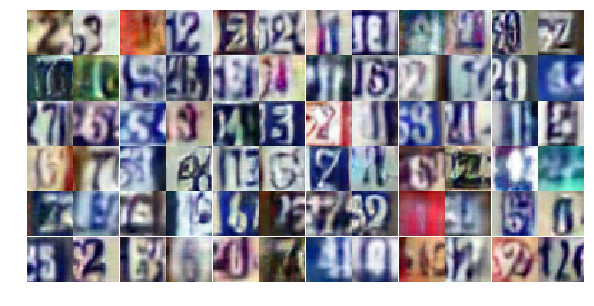

Epoch 19/25... Discriminator Loss: 0.4952... Generator Loss: 1.2618
Epoch 19/25... Discriminator Loss: 0.8140... Generator Loss: 0.8972
Epoch 19/25... Discriminator Loss: 0.5190... Generator Loss: 1.2882
Epoch 19/25... Discriminator Loss: 0.6222... Generator Loss: 1.0873
Epoch 19/25... Discriminator Loss: 0.5419... Generator Loss: 1.2275
Epoch 19/25... Discriminator Loss: 0.8929... Generator Loss: 5.0320
Epoch 19/25... Discriminator Loss: 0.5025... Generator Loss: 1.4008
Epoch 19/25... Discriminator Loss: 0.3490... Generator Loss: 2.0595
Epoch 19/25... Discriminator Loss: 0.6160... Generator Loss: 1.0614
Epoch 19/25... Discriminator Loss: 0.7475... Generator Loss: 0.9131


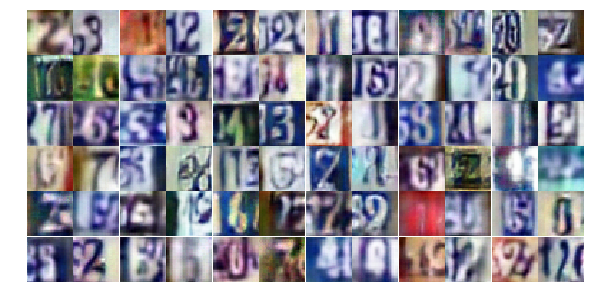

Epoch 19/25... Discriminator Loss: 1.9761... Generator Loss: 4.9570
Epoch 19/25... Discriminator Loss: 0.4994... Generator Loss: 1.3024
Epoch 19/25... Discriminator Loss: 0.4304... Generator Loss: 1.5980
Epoch 19/25... Discriminator Loss: 1.0321... Generator Loss: 0.6567
Epoch 19/25... Discriminator Loss: 0.3963... Generator Loss: 1.7347
Epoch 19/25... Discriminator Loss: 1.9040... Generator Loss: 0.3831
Epoch 19/25... Discriminator Loss: 0.8864... Generator Loss: 0.8840
Epoch 19/25... Discriminator Loss: 0.4729... Generator Loss: 1.8557
Epoch 19/25... Discriminator Loss: 0.4642... Generator Loss: 2.1455
Epoch 19/25... Discriminator Loss: 0.2799... Generator Loss: 3.2772


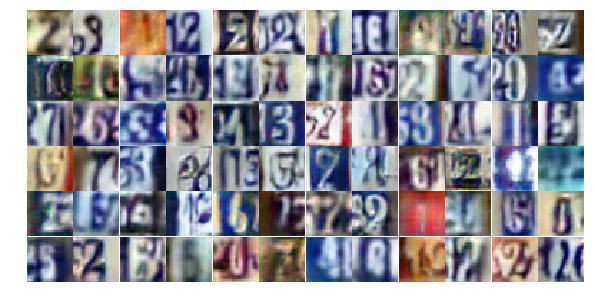

Epoch 19/25... Discriminator Loss: 0.5276... Generator Loss: 1.2575
Epoch 19/25... Discriminator Loss: 0.4740... Generator Loss: 1.3989
Epoch 19/25... Discriminator Loss: 0.4955... Generator Loss: 1.3123
Epoch 19/25... Discriminator Loss: 0.4893... Generator Loss: 1.3093
Epoch 19/25... Discriminator Loss: 0.5592... Generator Loss: 1.1825
Epoch 19/25... Discriminator Loss: 0.2625... Generator Loss: 2.4546
Epoch 19/25... Discriminator Loss: 0.4318... Generator Loss: 2.1440
Epoch 19/25... Discriminator Loss: 0.5536... Generator Loss: 3.5757
Epoch 19/25... Discriminator Loss: 0.4040... Generator Loss: 1.4807
Epoch 19/25... Discriminator Loss: 0.6154... Generator Loss: 1.0640


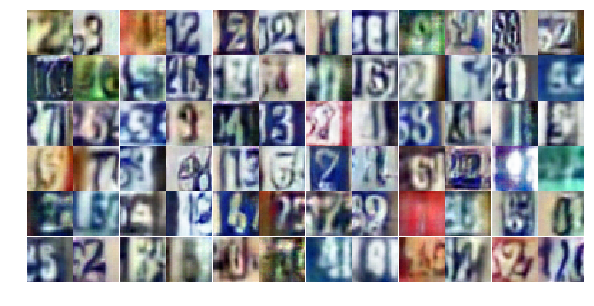

Epoch 19/25... Discriminator Loss: 0.8570... Generator Loss: 0.7908
Epoch 19/25... Discriminator Loss: 1.0188... Generator Loss: 0.7378
Epoch 19/25... Discriminator Loss: 0.3164... Generator Loss: 1.8718
Epoch 19/25... Discriminator Loss: 1.1366... Generator Loss: 0.5971
Epoch 19/25... Discriminator Loss: 0.3555... Generator Loss: 2.1422
Epoch 19/25... Discriminator Loss: 0.3539... Generator Loss: 1.7087
Epoch 19/25... Discriminator Loss: 1.6823... Generator Loss: 0.3121
Epoch 19/25... Discriminator Loss: 0.3325... Generator Loss: 2.2033
Epoch 20/25... Discriminator Loss: 1.4647... Generator Loss: 4.0941
Epoch 20/25... Discriminator Loss: 0.5499... Generator Loss: 2.4062


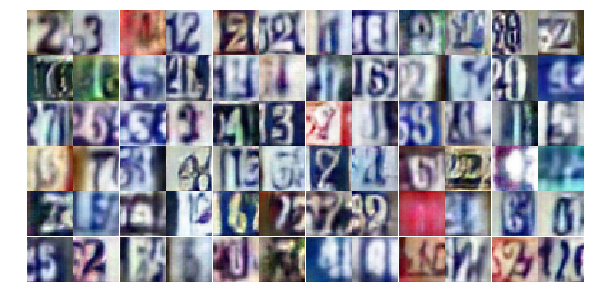

Epoch 20/25... Discriminator Loss: 0.3659... Generator Loss: 1.9350
Epoch 20/25... Discriminator Loss: 0.7420... Generator Loss: 1.1198
Epoch 20/25... Discriminator Loss: 1.2843... Generator Loss: 0.5691
Epoch 20/25... Discriminator Loss: 0.7932... Generator Loss: 0.8581
Epoch 20/25... Discriminator Loss: 0.7201... Generator Loss: 1.1046
Epoch 20/25... Discriminator Loss: 0.5649... Generator Loss: 1.1444
Epoch 20/25... Discriminator Loss: 0.2448... Generator Loss: 2.5726
Epoch 20/25... Discriminator Loss: 0.3169... Generator Loss: 2.7773
Epoch 20/25... Discriminator Loss: 0.6431... Generator Loss: 1.0913
Epoch 20/25... Discriminator Loss: 0.4073... Generator Loss: 1.5215


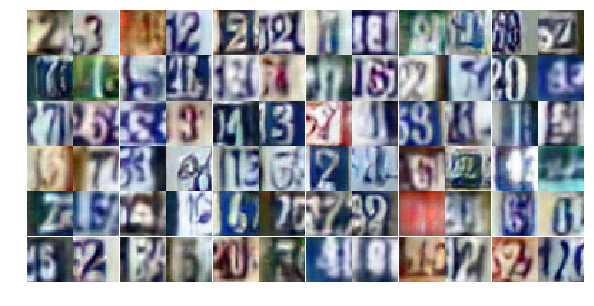

Epoch 20/25... Discriminator Loss: 0.5593... Generator Loss: 1.1740
Epoch 20/25... Discriminator Loss: 0.5482... Generator Loss: 1.1926
Epoch 20/25... Discriminator Loss: 0.9772... Generator Loss: 0.7819
Epoch 20/25... Discriminator Loss: 2.3956... Generator Loss: 0.2045
Epoch 20/25... Discriminator Loss: 1.5668... Generator Loss: 1.3994
Epoch 20/25... Discriminator Loss: 1.1873... Generator Loss: 1.8003
Epoch 20/25... Discriminator Loss: 1.6649... Generator Loss: 3.2230
Epoch 20/25... Discriminator Loss: 1.0465... Generator Loss: 0.7350
Epoch 20/25... Discriminator Loss: 0.8649... Generator Loss: 0.8493
Epoch 20/25... Discriminator Loss: 0.8480... Generator Loss: 0.9409


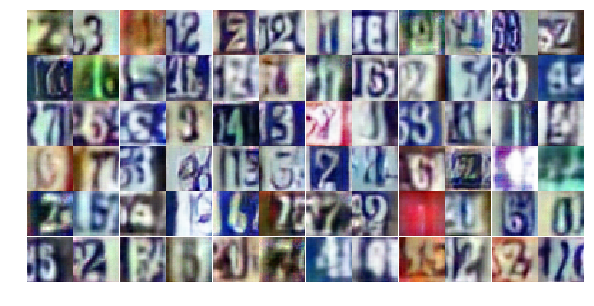

Epoch 20/25... Discriminator Loss: 0.5811... Generator Loss: 1.1916
Epoch 20/25... Discriminator Loss: 1.2100... Generator Loss: 0.5079
Epoch 20/25... Discriminator Loss: 0.3014... Generator Loss: 2.2412
Epoch 20/25... Discriminator Loss: 1.4187... Generator Loss: 0.4346
Epoch 20/25... Discriminator Loss: 0.8542... Generator Loss: 0.8207
Epoch 20/25... Discriminator Loss: 0.3949... Generator Loss: 2.0238
Epoch 20/25... Discriminator Loss: 0.4125... Generator Loss: 1.6321
Epoch 20/25... Discriminator Loss: 1.6780... Generator Loss: 0.3033
Epoch 20/25... Discriminator Loss: 0.7797... Generator Loss: 0.8665
Epoch 20/25... Discriminator Loss: 0.4777... Generator Loss: 1.2244


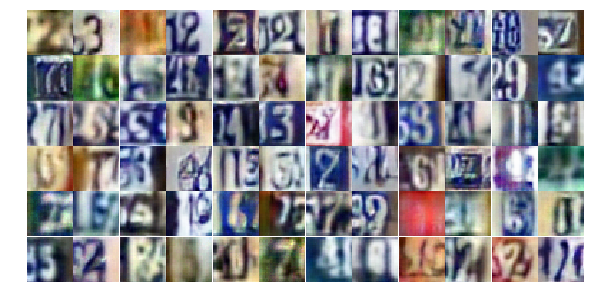

Epoch 20/25... Discriminator Loss: 0.6887... Generator Loss: 2.2563
Epoch 20/25... Discriminator Loss: 0.5412... Generator Loss: 1.2839
Epoch 20/25... Discriminator Loss: 1.1127... Generator Loss: 0.5610
Epoch 20/25... Discriminator Loss: 0.5281... Generator Loss: 1.3249
Epoch 20/25... Discriminator Loss: 0.4534... Generator Loss: 1.5072
Epoch 20/25... Discriminator Loss: 0.3627... Generator Loss: 1.8872
Epoch 20/25... Discriminator Loss: 0.7404... Generator Loss: 1.0449
Epoch 20/25... Discriminator Loss: 0.6311... Generator Loss: 1.0648
Epoch 20/25... Discriminator Loss: 0.8120... Generator Loss: 0.8275
Epoch 20/25... Discriminator Loss: 0.5949... Generator Loss: 1.1517


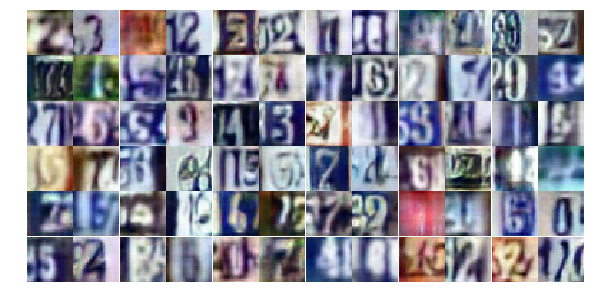

Epoch 20/25... Discriminator Loss: 0.7318... Generator Loss: 0.9125
Epoch 20/25... Discriminator Loss: 0.8222... Generator Loss: 0.8242
Epoch 20/25... Discriminator Loss: 0.3165... Generator Loss: 2.6756
Epoch 20/25... Discriminator Loss: 0.4450... Generator Loss: 1.5185
Epoch 20/25... Discriminator Loss: 0.5674... Generator Loss: 1.3690
Epoch 20/25... Discriminator Loss: 0.7693... Generator Loss: 0.8667
Epoch 20/25... Discriminator Loss: 0.7210... Generator Loss: 0.9446
Epoch 20/25... Discriminator Loss: 0.2524... Generator Loss: 2.4640
Epoch 20/25... Discriminator Loss: 0.3926... Generator Loss: 1.4332
Epoch 20/25... Discriminator Loss: 0.4203... Generator Loss: 1.6011


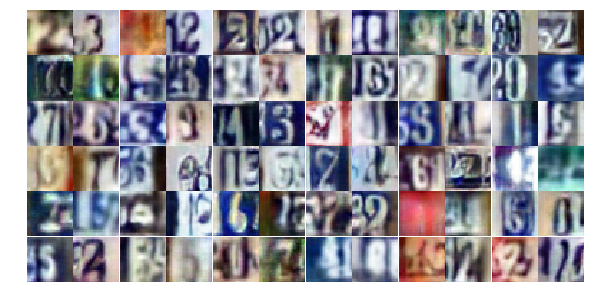

Epoch 20/25... Discriminator Loss: 2.0147... Generator Loss: 4.4433
Epoch 20/25... Discriminator Loss: 1.1591... Generator Loss: 3.5192
Epoch 20/25... Discriminator Loss: 0.4992... Generator Loss: 1.5615
Epoch 20/25... Discriminator Loss: 0.9979... Generator Loss: 1.1965
Epoch 20/25... Discriminator Loss: 0.4187... Generator Loss: 1.5432
Epoch 20/25... Discriminator Loss: 0.4039... Generator Loss: 1.5441
Epoch 21/25... Discriminator Loss: 0.8134... Generator Loss: 0.9245
Epoch 21/25... Discriminator Loss: 0.8237... Generator Loss: 0.8071
Epoch 21/25... Discriminator Loss: 0.5945... Generator Loss: 1.1817
Epoch 21/25... Discriminator Loss: 0.7727... Generator Loss: 0.9284


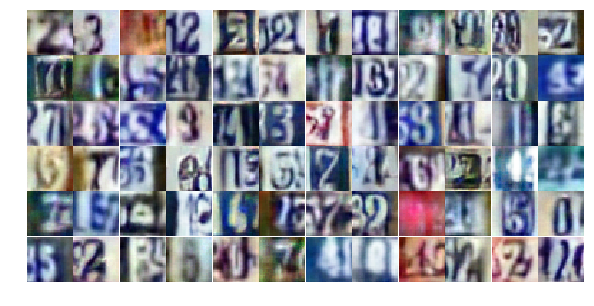

Epoch 21/25... Discriminator Loss: 1.0557... Generator Loss: 0.5836
Epoch 21/25... Discriminator Loss: 1.1182... Generator Loss: 0.6230
Epoch 21/25... Discriminator Loss: 0.3090... Generator Loss: 1.9236
Epoch 21/25... Discriminator Loss: 0.3066... Generator Loss: 1.6729
Epoch 21/25... Discriminator Loss: 0.5478... Generator Loss: 1.2094
Epoch 21/25... Discriminator Loss: 0.7064... Generator Loss: 1.1366
Epoch 21/25... Discriminator Loss: 0.4211... Generator Loss: 1.5006
Epoch 21/25... Discriminator Loss: 0.9220... Generator Loss: 0.7761
Epoch 21/25... Discriminator Loss: 0.3982... Generator Loss: 1.7060
Epoch 21/25... Discriminator Loss: 0.8818... Generator Loss: 0.8561


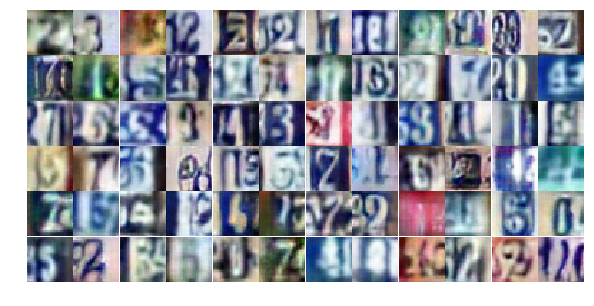

Epoch 21/25... Discriminator Loss: 0.1901... Generator Loss: 2.3531
Epoch 21/25... Discriminator Loss: 0.5542... Generator Loss: 1.2256
Epoch 21/25... Discriminator Loss: 1.2728... Generator Loss: 3.5372
Epoch 21/25... Discriminator Loss: 1.2371... Generator Loss: 0.5617
Epoch 21/25... Discriminator Loss: 0.2778... Generator Loss: 2.4183
Epoch 21/25... Discriminator Loss: 1.0730... Generator Loss: 0.6201
Epoch 21/25... Discriminator Loss: 0.4736... Generator Loss: 1.4521
Epoch 21/25... Discriminator Loss: 0.1893... Generator Loss: 2.5671
Epoch 21/25... Discriminator Loss: 0.2249... Generator Loss: 2.4388
Epoch 21/25... Discriminator Loss: 0.4358... Generator Loss: 1.5455


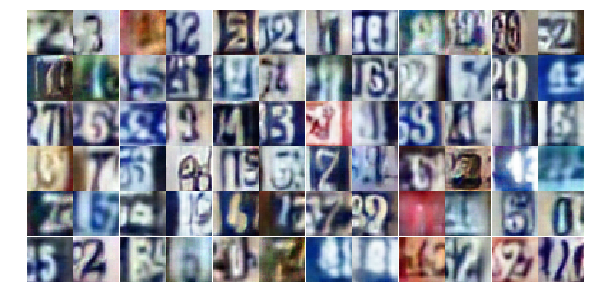

Epoch 21/25... Discriminator Loss: 0.8058... Generator Loss: 0.8513
Epoch 21/25... Discriminator Loss: 0.2263... Generator Loss: 2.1176
Epoch 21/25... Discriminator Loss: 0.7445... Generator Loss: 0.9173
Epoch 21/25... Discriminator Loss: 0.3516... Generator Loss: 1.9240
Epoch 21/25... Discriminator Loss: 0.5799... Generator Loss: 1.2731
Epoch 21/25... Discriminator Loss: 0.7834... Generator Loss: 0.8597
Epoch 21/25... Discriminator Loss: 0.3147... Generator Loss: 1.9549
Epoch 21/25... Discriminator Loss: 0.9325... Generator Loss: 0.7539
Epoch 21/25... Discriminator Loss: 0.8538... Generator Loss: 0.8206
Epoch 21/25... Discriminator Loss: 1.5748... Generator Loss: 0.3971


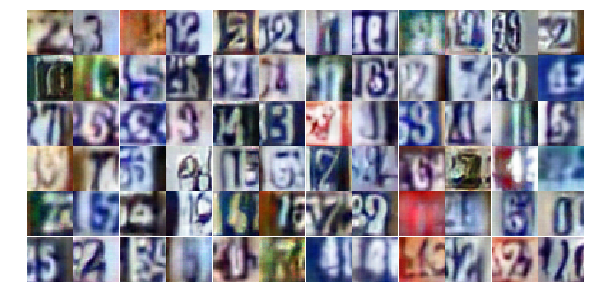

Epoch 21/25... Discriminator Loss: 2.7355... Generator Loss: 0.1425
Epoch 21/25... Discriminator Loss: 1.2690... Generator Loss: 3.5557
Epoch 21/25... Discriminator Loss: 0.7307... Generator Loss: 1.3913
Epoch 21/25... Discriminator Loss: 0.3256... Generator Loss: 2.3021
Epoch 21/25... Discriminator Loss: 0.5841... Generator Loss: 1.1091
Epoch 21/25... Discriminator Loss: 0.7801... Generator Loss: 0.8068
Epoch 21/25... Discriminator Loss: 0.7178... Generator Loss: 1.0362
Epoch 21/25... Discriminator Loss: 0.8310... Generator Loss: 0.8416
Epoch 21/25... Discriminator Loss: 0.4091... Generator Loss: 1.5382
Epoch 21/25... Discriminator Loss: 0.2309... Generator Loss: 2.6215


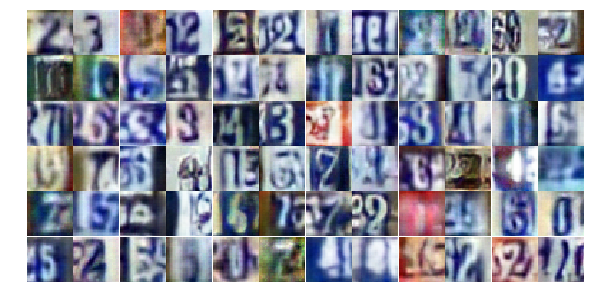

Epoch 21/25... Discriminator Loss: 0.7426... Generator Loss: 0.9770
Epoch 21/25... Discriminator Loss: 0.9644... Generator Loss: 0.7770
Epoch 21/25... Discriminator Loss: 0.4739... Generator Loss: 1.7037
Epoch 21/25... Discriminator Loss: 0.6299... Generator Loss: 1.0672
Epoch 21/25... Discriminator Loss: 0.5486... Generator Loss: 1.1947
Epoch 21/25... Discriminator Loss: 0.4059... Generator Loss: 1.7459
Epoch 21/25... Discriminator Loss: 0.7199... Generator Loss: 1.0414
Epoch 21/25... Discriminator Loss: 1.4061... Generator Loss: 0.4178
Epoch 21/25... Discriminator Loss: 1.0341... Generator Loss: 0.6483
Epoch 21/25... Discriminator Loss: 0.2615... Generator Loss: 2.0519


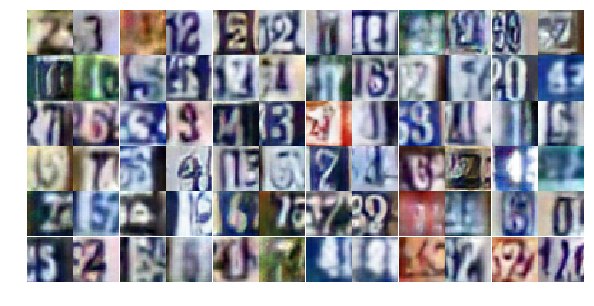

Epoch 21/25... Discriminator Loss: 0.3411... Generator Loss: 1.9457
Epoch 21/25... Discriminator Loss: 1.5990... Generator Loss: 0.4108
Epoch 21/25... Discriminator Loss: 1.0171... Generator Loss: 0.8152
Epoch 22/25... Discriminator Loss: 0.5466... Generator Loss: 1.2701
Epoch 22/25... Discriminator Loss: 0.3443... Generator Loss: 3.4866
Epoch 22/25... Discriminator Loss: 0.3913... Generator Loss: 1.7983
Epoch 22/25... Discriminator Loss: 0.2297... Generator Loss: 2.1184
Epoch 22/25... Discriminator Loss: 0.2219... Generator Loss: 2.2342
Epoch 22/25... Discriminator Loss: 0.9525... Generator Loss: 0.7140
Epoch 22/25... Discriminator Loss: 0.5600... Generator Loss: 2.5773


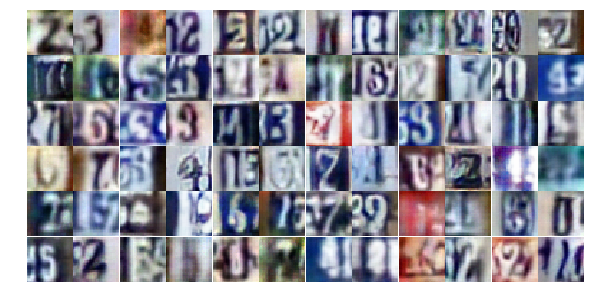

Epoch 22/25... Discriminator Loss: 1.2598... Generator Loss: 0.5833
Epoch 22/25... Discriminator Loss: 1.8895... Generator Loss: 4.6446
Epoch 22/25... Discriminator Loss: 1.1460... Generator Loss: 1.0801
Epoch 22/25... Discriminator Loss: 0.5182... Generator Loss: 1.4403
Epoch 22/25... Discriminator Loss: 0.4846... Generator Loss: 1.8118
Epoch 22/25... Discriminator Loss: 0.9019... Generator Loss: 0.8027
Epoch 22/25... Discriminator Loss: 0.7917... Generator Loss: 0.8670
Epoch 22/25... Discriminator Loss: 0.3224... Generator Loss: 2.3845
Epoch 22/25... Discriminator Loss: 1.0492... Generator Loss: 0.7219
Epoch 22/25... Discriminator Loss: 1.8816... Generator Loss: 0.2914


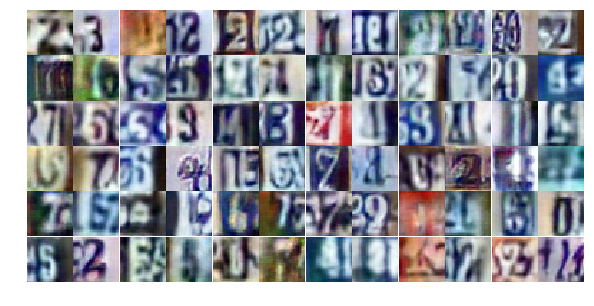

Epoch 22/25... Discriminator Loss: 1.2831... Generator Loss: 4.0534
Epoch 22/25... Discriminator Loss: 0.5327... Generator Loss: 1.9680
Epoch 22/25... Discriminator Loss: 0.9366... Generator Loss: 0.8395
Epoch 22/25... Discriminator Loss: 0.3008... Generator Loss: 2.9880
Epoch 22/25... Discriminator Loss: 0.4647... Generator Loss: 2.0426
Epoch 22/25... Discriminator Loss: 0.8355... Generator Loss: 0.8166
Epoch 22/25... Discriminator Loss: 0.3240... Generator Loss: 1.9136
Epoch 22/25... Discriminator Loss: 0.2847... Generator Loss: 2.3285
Epoch 22/25... Discriminator Loss: 0.5747... Generator Loss: 1.1283
Epoch 22/25... Discriminator Loss: 0.9562... Generator Loss: 0.7312


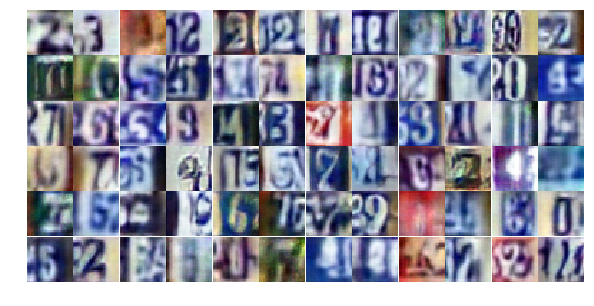

Epoch 22/25... Discriminator Loss: 0.2593... Generator Loss: 1.9644
Epoch 22/25... Discriminator Loss: 0.6018... Generator Loss: 1.1360
Epoch 22/25... Discriminator Loss: 0.5729... Generator Loss: 4.2064
Epoch 22/25... Discriminator Loss: 0.7799... Generator Loss: 0.9145
Epoch 22/25... Discriminator Loss: 0.5372... Generator Loss: 1.4562
Epoch 22/25... Discriminator Loss: 1.0107... Generator Loss: 0.8764
Epoch 22/25... Discriminator Loss: 1.5642... Generator Loss: 0.3541
Epoch 22/25... Discriminator Loss: 0.4218... Generator Loss: 1.4418
Epoch 22/25... Discriminator Loss: 0.5495... Generator Loss: 1.3196
Epoch 22/25... Discriminator Loss: 0.2858... Generator Loss: 2.2657


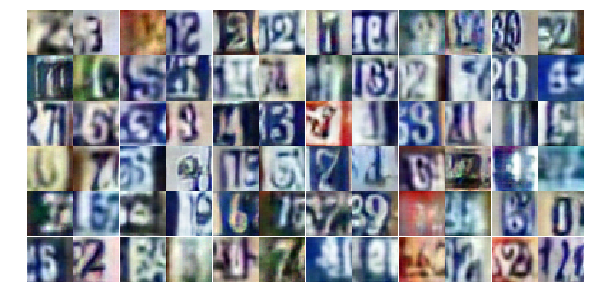

Epoch 22/25... Discriminator Loss: 0.5705... Generator Loss: 1.2467
Epoch 22/25... Discriminator Loss: 0.2754... Generator Loss: 1.8787
Epoch 22/25... Discriminator Loss: 0.6768... Generator Loss: 0.8895
Epoch 22/25... Discriminator Loss: 0.4388... Generator Loss: 1.4173
Epoch 22/25... Discriminator Loss: 0.2513... Generator Loss: 2.0372
Epoch 22/25... Discriminator Loss: 0.2527... Generator Loss: 2.0162
Epoch 22/25... Discriminator Loss: 0.4271... Generator Loss: 2.2283
Epoch 22/25... Discriminator Loss: 0.5655... Generator Loss: 4.1614
Epoch 22/25... Discriminator Loss: 1.5664... Generator Loss: 0.4043
Epoch 22/25... Discriminator Loss: 1.7777... Generator Loss: 0.3798


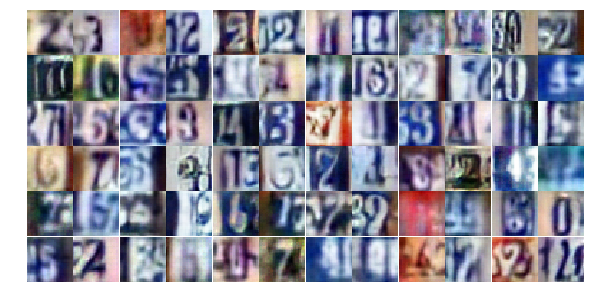

Epoch 22/25... Discriminator Loss: 0.5483... Generator Loss: 1.8271
Epoch 22/25... Discriminator Loss: 0.6006... Generator Loss: 1.2343
Epoch 22/25... Discriminator Loss: 0.7486... Generator Loss: 0.8761
Epoch 22/25... Discriminator Loss: 0.6578... Generator Loss: 1.0648
Epoch 22/25... Discriminator Loss: 0.7335... Generator Loss: 0.9384
Epoch 22/25... Discriminator Loss: 0.6788... Generator Loss: 1.0859
Epoch 22/25... Discriminator Loss: 0.3539... Generator Loss: 2.0225
Epoch 22/25... Discriminator Loss: 0.1494... Generator Loss: 2.8760
Epoch 22/25... Discriminator Loss: 0.5456... Generator Loss: 2.0247
Epoch 22/25... Discriminator Loss: 0.5222... Generator Loss: 1.3837


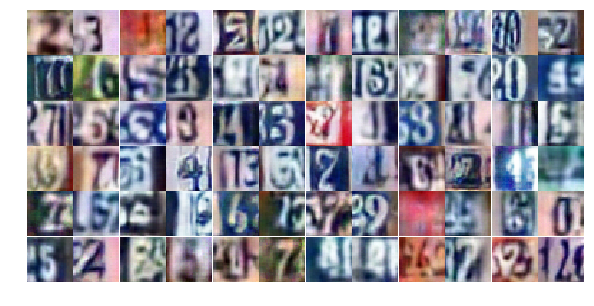

Epoch 23/25... Discriminator Loss: 0.2905... Generator Loss: 2.2861
Epoch 23/25... Discriminator Loss: 0.2975... Generator Loss: 1.9099
Epoch 23/25... Discriminator Loss: 0.7434... Generator Loss: 0.9505
Epoch 23/25... Discriminator Loss: 0.5958... Generator Loss: 1.1083
Epoch 23/25... Discriminator Loss: 0.5444... Generator Loss: 1.1251
Epoch 23/25... Discriminator Loss: 1.2309... Generator Loss: 0.4917
Epoch 23/25... Discriminator Loss: 3.3109... Generator Loss: 0.0969
Epoch 23/25... Discriminator Loss: 0.9652... Generator Loss: 2.7059
Epoch 23/25... Discriminator Loss: 1.2963... Generator Loss: 0.5213
Epoch 23/25... Discriminator Loss: 0.3678... Generator Loss: 1.9234


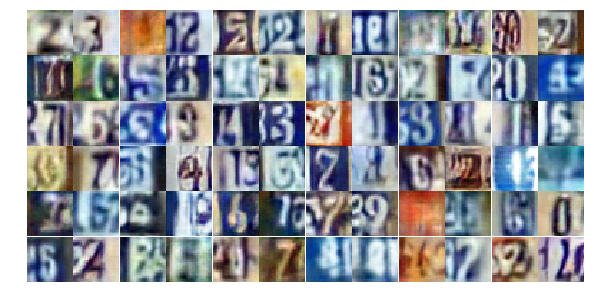

Epoch 23/25... Discriminator Loss: 0.5157... Generator Loss: 1.2195
Epoch 23/25... Discriminator Loss: 0.7380... Generator Loss: 0.8815
Epoch 23/25... Discriminator Loss: 0.6014... Generator Loss: 1.2041
Epoch 23/25... Discriminator Loss: 0.6530... Generator Loss: 1.0676
Epoch 23/25... Discriminator Loss: 0.2624... Generator Loss: 2.1136
Epoch 23/25... Discriminator Loss: 0.5419... Generator Loss: 1.1786
Epoch 23/25... Discriminator Loss: 0.7508... Generator Loss: 0.8714
Epoch 23/25... Discriminator Loss: 0.3794... Generator Loss: 3.1685
Epoch 23/25... Discriminator Loss: 0.5226... Generator Loss: 1.2886
Epoch 23/25... Discriminator Loss: 0.4517... Generator Loss: 1.3988


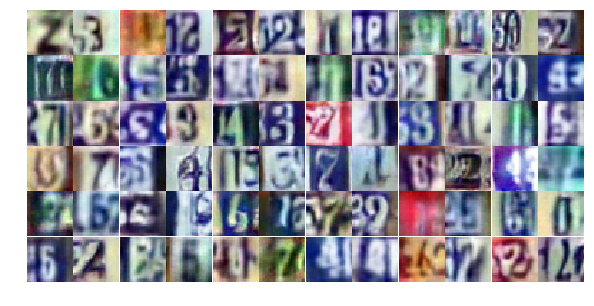

Epoch 23/25... Discriminator Loss: 0.8055... Generator Loss: 0.8737
Epoch 23/25... Discriminator Loss: 0.6362... Generator Loss: 1.0516
Epoch 23/25... Discriminator Loss: 0.7414... Generator Loss: 0.9335
Epoch 23/25... Discriminator Loss: 0.4828... Generator Loss: 1.4126
Epoch 23/25... Discriminator Loss: 0.2459... Generator Loss: 2.4394
Epoch 23/25... Discriminator Loss: 0.2747... Generator Loss: 2.4062
Epoch 23/25... Discriminator Loss: 0.6311... Generator Loss: 1.0685
Epoch 23/25... Discriminator Loss: 0.6220... Generator Loss: 1.2357
Epoch 23/25... Discriminator Loss: 0.4355... Generator Loss: 1.4589
Epoch 23/25... Discriminator Loss: 0.5900... Generator Loss: 1.1725


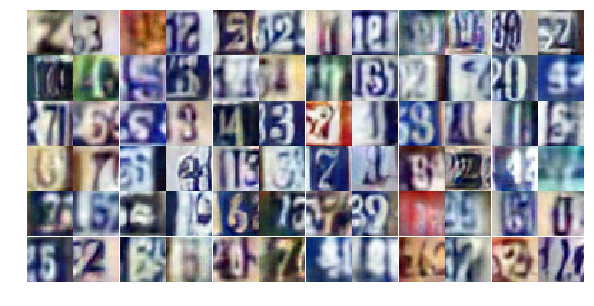

Epoch 23/25... Discriminator Loss: 0.3014... Generator Loss: 1.7239
Epoch 23/25... Discriminator Loss: 0.3367... Generator Loss: 1.8014
Epoch 23/25... Discriminator Loss: 0.2805... Generator Loss: 1.8817
Epoch 23/25... Discriminator Loss: 0.8679... Generator Loss: 0.7845
Epoch 23/25... Discriminator Loss: 0.5556... Generator Loss: 1.3436
Epoch 23/25... Discriminator Loss: 0.4541... Generator Loss: 1.4260
Epoch 23/25... Discriminator Loss: 0.8560... Generator Loss: 0.8793
Epoch 23/25... Discriminator Loss: 0.3007... Generator Loss: 1.8009
Epoch 23/25... Discriminator Loss: 0.1682... Generator Loss: 2.3605
Epoch 23/25... Discriminator Loss: 0.4949... Generator Loss: 1.2645


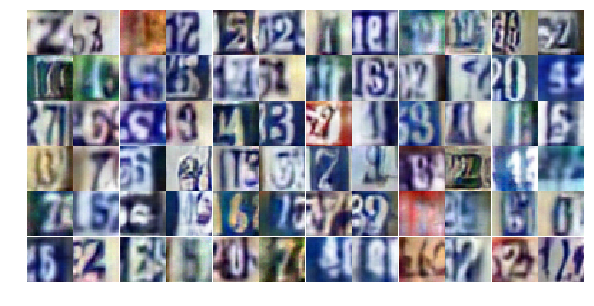

Epoch 23/25... Discriminator Loss: 1.5145... Generator Loss: 3.9495
Epoch 23/25... Discriminator Loss: 0.5011... Generator Loss: 3.0064
Epoch 23/25... Discriminator Loss: 0.4264... Generator Loss: 1.9883
Epoch 23/25... Discriminator Loss: 0.3979... Generator Loss: 1.5644
Epoch 23/25... Discriminator Loss: 2.2141... Generator Loss: 4.6085
Epoch 23/25... Discriminator Loss: 1.2088... Generator Loss: 0.7768
Epoch 23/25... Discriminator Loss: 0.5656... Generator Loss: 1.8289
Epoch 23/25... Discriminator Loss: 0.8288... Generator Loss: 0.8468
Epoch 23/25... Discriminator Loss: 0.3703... Generator Loss: 1.7492
Epoch 23/25... Discriminator Loss: 0.4871... Generator Loss: 1.4808


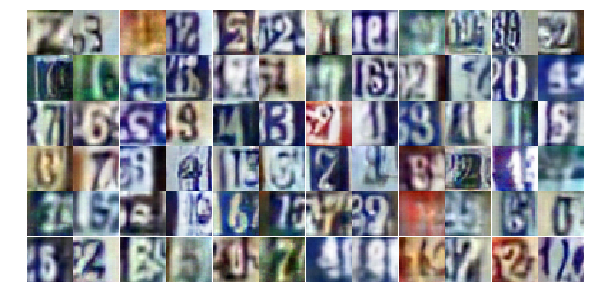

Epoch 23/25... Discriminator Loss: 0.7369... Generator Loss: 0.9314
Epoch 23/25... Discriminator Loss: 0.7126... Generator Loss: 0.9891
Epoch 23/25... Discriminator Loss: 1.1240... Generator Loss: 0.6203
Epoch 23/25... Discriminator Loss: 0.5099... Generator Loss: 1.2281
Epoch 23/25... Discriminator Loss: 1.0916... Generator Loss: 0.6722
Epoch 23/25... Discriminator Loss: 0.3744... Generator Loss: 1.5975
Epoch 23/25... Discriminator Loss: 0.8190... Generator Loss: 0.8872
Epoch 24/25... Discriminator Loss: 0.3895... Generator Loss: 1.7892
Epoch 24/25... Discriminator Loss: 1.0748... Generator Loss: 0.7012
Epoch 24/25... Discriminator Loss: 0.9114... Generator Loss: 0.8600


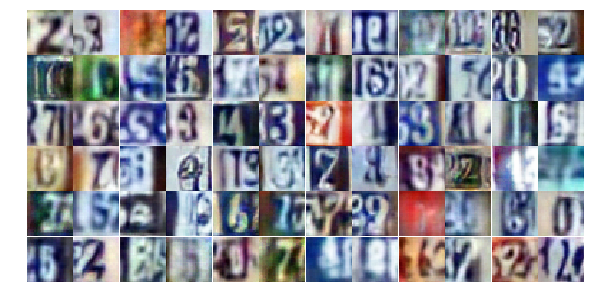

Epoch 24/25... Discriminator Loss: 0.7404... Generator Loss: 0.9366
Epoch 24/25... Discriminator Loss: 0.6532... Generator Loss: 1.0419
Epoch 24/25... Discriminator Loss: 0.2752... Generator Loss: 2.1898
Epoch 24/25... Discriminator Loss: 0.6534... Generator Loss: 2.7323
Epoch 24/25... Discriminator Loss: 0.2962... Generator Loss: 1.8169
Epoch 24/25... Discriminator Loss: 0.5005... Generator Loss: 2.4354
Epoch 24/25... Discriminator Loss: 0.3784... Generator Loss: 2.2923
Epoch 24/25... Discriminator Loss: 1.2711... Generator Loss: 0.5587
Epoch 24/25... Discriminator Loss: 0.2007... Generator Loss: 2.2142
Epoch 24/25... Discriminator Loss: 0.3188... Generator Loss: 1.6288


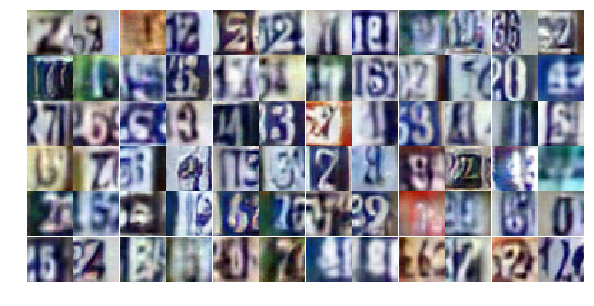

Epoch 24/25... Discriminator Loss: 0.8345... Generator Loss: 0.8292
Epoch 24/25... Discriminator Loss: 0.9483... Generator Loss: 0.7131
Epoch 24/25... Discriminator Loss: 0.6606... Generator Loss: 1.0921
Epoch 24/25... Discriminator Loss: 0.5113... Generator Loss: 1.2114
Epoch 24/25... Discriminator Loss: 0.2894... Generator Loss: 1.8436
Epoch 24/25... Discriminator Loss: 0.8537... Generator Loss: 0.9113
Epoch 24/25... Discriminator Loss: 0.4004... Generator Loss: 1.5044
Epoch 24/25... Discriminator Loss: 0.6584... Generator Loss: 1.0030
Epoch 24/25... Discriminator Loss: 0.4487... Generator Loss: 1.4340
Epoch 24/25... Discriminator Loss: 0.4494... Generator Loss: 1.4156


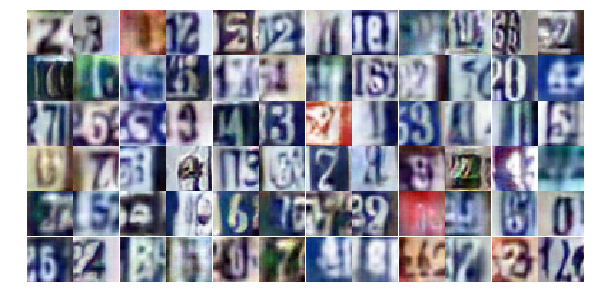

Epoch 24/25... Discriminator Loss: 0.4514... Generator Loss: 1.4010
Epoch 24/25... Discriminator Loss: 0.7717... Generator Loss: 0.8816
Epoch 24/25... Discriminator Loss: 0.1529... Generator Loss: 2.6822
Epoch 24/25... Discriminator Loss: 0.7054... Generator Loss: 1.1465
Epoch 24/25... Discriminator Loss: 0.3540... Generator Loss: 1.6939
Epoch 24/25... Discriminator Loss: 0.4434... Generator Loss: 1.4587
Epoch 24/25... Discriminator Loss: 1.2306... Generator Loss: 3.3466
Epoch 24/25... Discriminator Loss: 1.4713... Generator Loss: 2.3870
Epoch 24/25... Discriminator Loss: 1.3680... Generator Loss: 0.4747
Epoch 24/25... Discriminator Loss: 0.5448... Generator Loss: 1.2941


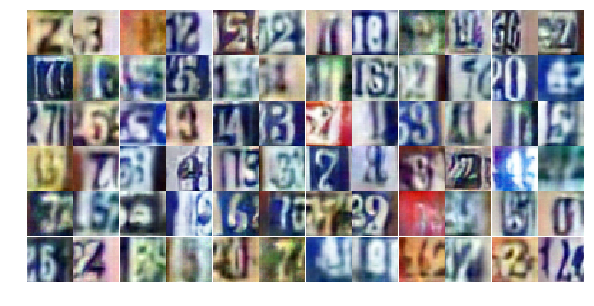

Epoch 24/25... Discriminator Loss: 0.4471... Generator Loss: 2.9755
Epoch 24/25... Discriminator Loss: 0.3418... Generator Loss: 1.7421
Epoch 24/25... Discriminator Loss: 0.6423... Generator Loss: 2.2187
Epoch 24/25... Discriminator Loss: 1.0842... Generator Loss: 0.6352
Epoch 24/25... Discriminator Loss: 0.5832... Generator Loss: 1.9118
Epoch 24/25... Discriminator Loss: 0.6744... Generator Loss: 1.1082
Epoch 24/25... Discriminator Loss: 0.7044... Generator Loss: 0.9954
Epoch 24/25... Discriminator Loss: 0.5604... Generator Loss: 1.1726
Epoch 24/25... Discriminator Loss: 0.8526... Generator Loss: 0.7782
Epoch 24/25... Discriminator Loss: 0.5892... Generator Loss: 1.0653


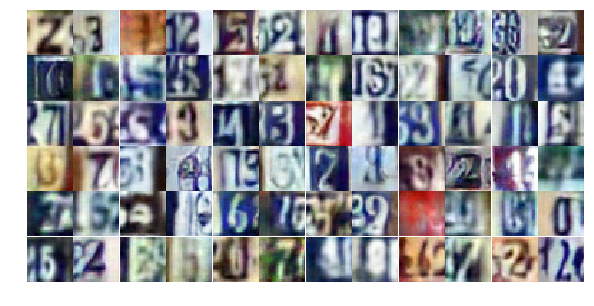

Epoch 24/25... Discriminator Loss: 0.4398... Generator Loss: 1.6168
Epoch 24/25... Discriminator Loss: 0.7590... Generator Loss: 0.8613
Epoch 24/25... Discriminator Loss: 0.7345... Generator Loss: 0.9718
Epoch 24/25... Discriminator Loss: 1.3688... Generator Loss: 0.5047
Epoch 24/25... Discriminator Loss: 1.0406... Generator Loss: 0.7842
Epoch 24/25... Discriminator Loss: 0.6841... Generator Loss: 1.1134
Epoch 24/25... Discriminator Loss: 0.6240... Generator Loss: 1.2472
Epoch 24/25... Discriminator Loss: 0.3428... Generator Loss: 1.7308
Epoch 24/25... Discriminator Loss: 0.9674... Generator Loss: 0.7224
Epoch 24/25... Discriminator Loss: 0.5071... Generator Loss: 1.5059


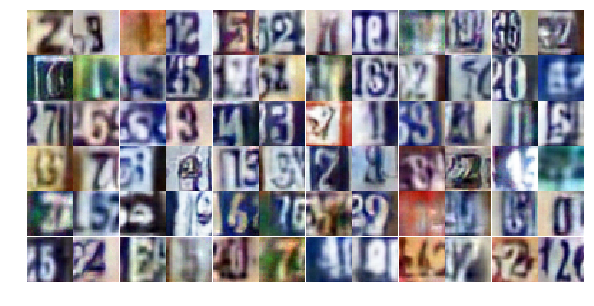

Epoch 24/25... Discriminator Loss: 0.4799... Generator Loss: 1.4425
Epoch 24/25... Discriminator Loss: 1.1216... Generator Loss: 0.5562
Epoch 24/25... Discriminator Loss: 0.5343... Generator Loss: 1.3658
Epoch 24/25... Discriminator Loss: 2.4806... Generator Loss: 6.3790
Epoch 24/25... Discriminator Loss: 1.0028... Generator Loss: 1.7652
Epoch 25/25... Discriminator Loss: 0.7872... Generator Loss: 1.1201
Epoch 25/25... Discriminator Loss: 0.2466... Generator Loss: 2.8562
Epoch 25/25... Discriminator Loss: 0.5866... Generator Loss: 1.3546
Epoch 25/25... Discriminator Loss: 0.6652... Generator Loss: 1.0301
Epoch 25/25... Discriminator Loss: 0.6746... Generator Loss: 1.0339


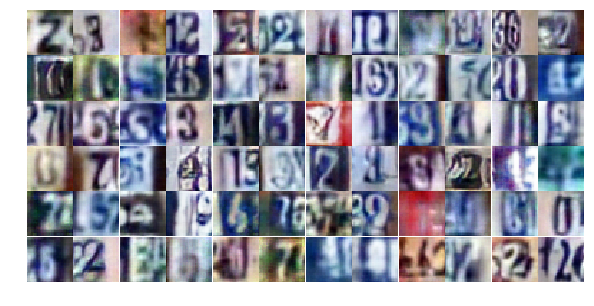

Epoch 25/25... Discriminator Loss: 1.4022... Generator Loss: 0.4815
Epoch 25/25... Discriminator Loss: 1.7349... Generator Loss: 0.4207
Epoch 25/25... Discriminator Loss: 0.6673... Generator Loss: 1.0202
Epoch 25/25... Discriminator Loss: 0.5028... Generator Loss: 1.4679
Epoch 25/25... Discriminator Loss: 0.5775... Generator Loss: 1.2040
Epoch 25/25... Discriminator Loss: 0.5857... Generator Loss: 1.3001
Epoch 25/25... Discriminator Loss: 0.8359... Generator Loss: 0.8232
Epoch 25/25... Discriminator Loss: 0.8671... Generator Loss: 0.9646
Epoch 25/25... Discriminator Loss: 0.1018... Generator Loss: 3.5876
Epoch 25/25... Discriminator Loss: 1.2944... Generator Loss: 0.4901


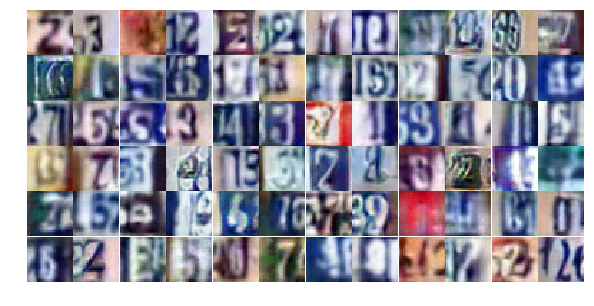

Epoch 25/25... Discriminator Loss: 0.4196... Generator Loss: 1.6568
Epoch 25/25... Discriminator Loss: 0.3317... Generator Loss: 4.0804
Epoch 25/25... Discriminator Loss: 0.7107... Generator Loss: 1.1077
Epoch 25/25... Discriminator Loss: 2.0154... Generator Loss: 0.2572
Epoch 25/25... Discriminator Loss: 1.0299... Generator Loss: 1.2897
Epoch 25/25... Discriminator Loss: 0.6654... Generator Loss: 1.2246
Epoch 25/25... Discriminator Loss: 0.8546... Generator Loss: 0.8963
Epoch 25/25... Discriminator Loss: 0.9305... Generator Loss: 0.7295
Epoch 25/25... Discriminator Loss: 0.5485... Generator Loss: 1.2474
Epoch 25/25... Discriminator Loss: 0.2485... Generator Loss: 2.2993


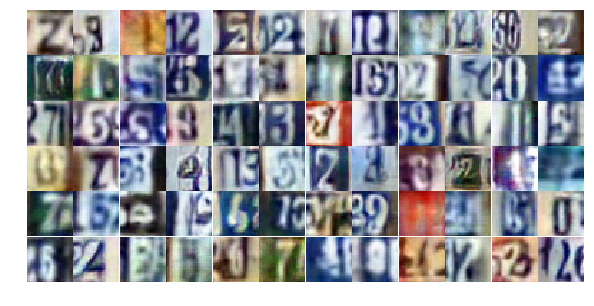

Epoch 25/25... Discriminator Loss: 0.6608... Generator Loss: 1.0966
Epoch 25/25... Discriminator Loss: 0.4122... Generator Loss: 1.4437
Epoch 25/25... Discriminator Loss: 0.7240... Generator Loss: 0.9380
Epoch 25/25... Discriminator Loss: 0.6756... Generator Loss: 1.0454
Epoch 25/25... Discriminator Loss: 0.5637... Generator Loss: 1.1795
Epoch 25/25... Discriminator Loss: 0.4947... Generator Loss: 1.2926
Epoch 25/25... Discriminator Loss: 0.4442... Generator Loss: 1.5224
Epoch 25/25... Discriminator Loss: 0.4959... Generator Loss: 1.2549
Epoch 25/25... Discriminator Loss: 0.4276... Generator Loss: 2.6640
Epoch 25/25... Discriminator Loss: 0.1907... Generator Loss: 2.5327


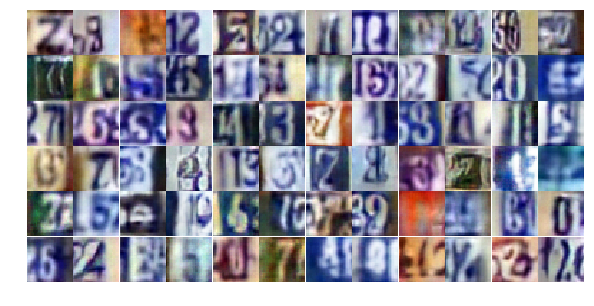

Epoch 25/25... Discriminator Loss: 0.5548... Generator Loss: 1.2508
Epoch 25/25... Discriminator Loss: 0.5801... Generator Loss: 1.1707
Epoch 25/25... Discriminator Loss: 0.4290... Generator Loss: 1.4263
Epoch 25/25... Discriminator Loss: 0.1862... Generator Loss: 2.3852
Epoch 25/25... Discriminator Loss: 0.5583... Generator Loss: 1.1786
Epoch 25/25... Discriminator Loss: 1.1636... Generator Loss: 0.5605
Epoch 25/25... Discriminator Loss: 0.4456... Generator Loss: 1.4073
Epoch 25/25... Discriminator Loss: 0.6028... Generator Loss: 1.3545
Epoch 25/25... Discriminator Loss: 1.8180... Generator Loss: 0.3255
Epoch 25/25... Discriminator Loss: 0.5323... Generator Loss: 1.2749


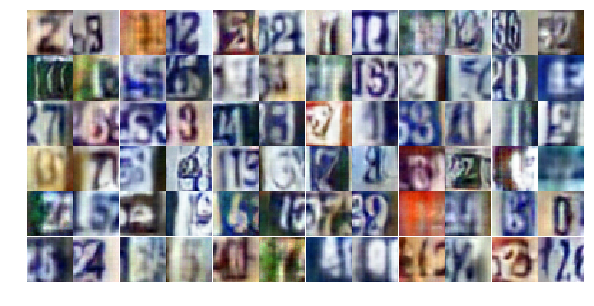

Epoch 25/25... Discriminator Loss: 0.7055... Generator Loss: 1.4135
Epoch 25/25... Discriminator Loss: 0.5191... Generator Loss: 1.3402
Epoch 25/25... Discriminator Loss: 0.5087... Generator Loss: 1.3182
Epoch 25/25... Discriminator Loss: 0.5763... Generator Loss: 1.2425
Epoch 25/25... Discriminator Loss: 0.9007... Generator Loss: 0.7925
Epoch 25/25... Discriminator Loss: 0.3005... Generator Loss: 1.7280
Epoch 25/25... Discriminator Loss: 0.7146... Generator Loss: 0.9881
Epoch 25/25... Discriminator Loss: 0.4711... Generator Loss: 1.5795
Epoch 25/25... Discriminator Loss: 0.4287... Generator Loss: 2.4252
Epoch 25/25... Discriminator Loss: 0.5639... Generator Loss: 1.1375


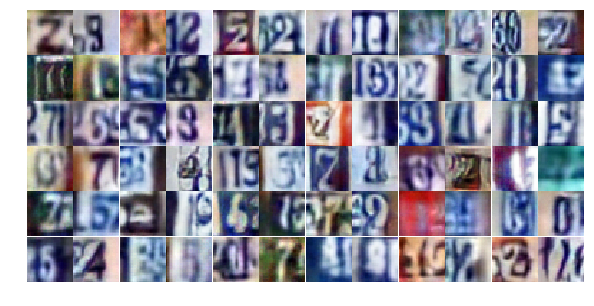

Epoch 25/25... Discriminator Loss: 0.2673... Generator Loss: 2.1659
Epoch 25/25... Discriminator Loss: 1.2724... Generator Loss: 0.5506


In [19]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

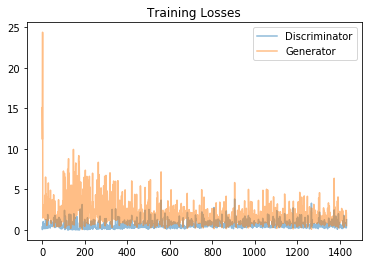

In [20]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

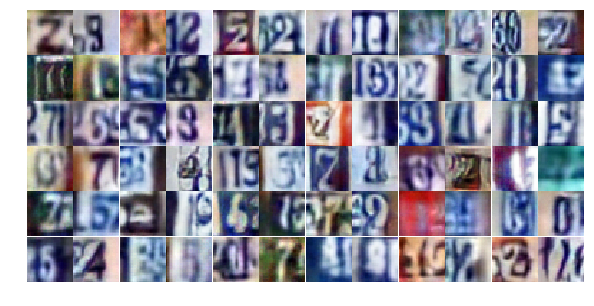

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))